In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import Voronoi, voronoi_plot_2d

En primera instancia se genera el código con el que se simulará la ciudad multinúcleo. Para ello, se utilizará una región determinada por el cuadrado: $[-100,100]^2$. En dicha zona se tendrán "comunas" centradas en las esquinas del cuadrado $[-40,40]^2$, en las que cada punto representa una casa, además habrá una distribución uniforme de casas esparcida en el cuadrado inicial, de forma de tener una especie de "casas de ruido" que no tienen porque pertenecer estrictamente a las comunas. Como el modelo de ciudad ocupado es el multinúcleo, se debe tener que cada "comuna" tenga en su centro puntos de interés (servicios o trabajos) y al mismo tiempo, en el centro de todo el esquema se acumulen aún más puntos de interés.

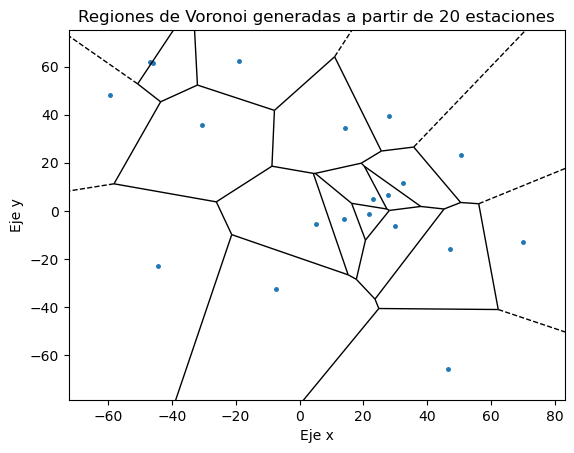

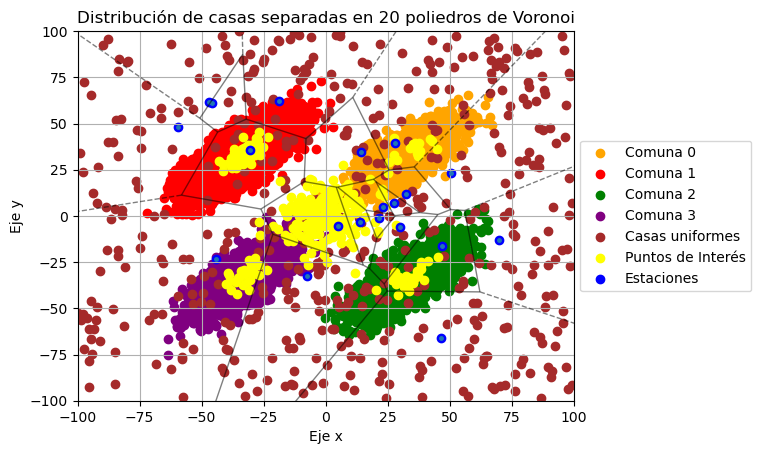

In [2]:
def inicializar_estaciones(N, xlim=100, ylim=100): #Esta función se diseña para distribuir las estaciones iniciales y
    #generar las regiones voronoi correspondientes
    angulo = 2 * np.pi / N
    coordenadas_x = [np.cos(i * angulo) for i in range(N)]
    coordenadas_y = [np.sin(i * angulo) for i in range(N)] #Se inician a partir de un polígono de N lados
    p = np.random.normal(0, 40, 2 * N) #Y luego se desplazarán siguiendo una normal(0,40).

    points = []
    
    for i in range(N):
        x_coord = coordenadas_x[i] + p[i] #Desplazamos la primera coordenada según dicha normal,
        y_coord = coordenadas_y[i] + p[N + i] #Y la segunda.

        # Ajustamos las coordenadas para que estén dentro del cuadrado:
        x_coord = max(min(x_coord, xlim), -xlim)
        y_coord = max(min(y_coord, ylim), -ylim)

        points.append([x_coord, y_coord]) #Se agregan los puntos.

    points = np.array(points)
    return points



N = 20

def inicializar_personas(mu,sig,n): #Cada comuna (conjunto de casas) se genera mediante una normal
  ciud = np.random.multivariate_normal(mu,sig,n) #multivariada.
  return ciud

def generar_comunas(xlim = 100,ylim = 100): #Esta función generará las comunas y sus respectivos puntos de interes.
    
  ciud_tot = []
  mus = [[xlim/3,ylim/3],[-xlim/3,ylim/3],[xlim/3,-ylim/3],[-xlim/3,-ylim/3]] #Los mus son de forma que las ciudades
  sig = [[xlim,3/4 * xlim],[3/4 * ylim, ylim]] #estén centradas en las esquinas de un cuadrado contenido en el inicial.
  sig_interes = [[xlim*0.2,xlim*0.1],[ylim*0.1,ylim*0.2]] #Parámetros para los puntos de interés.
  puntos_de_interes = []

  for j in range(4):
    numero = np.random.randint(100,10000) #El número de casas que tendrá cada comuna es aleatorio.
    numero = int(numero)
    numerointeres = int(np.floor(numero/100)) #El número de puntos de interés fue creado de forma de ser menor a las casas.
    ciud = inicializar_personas(mus[j],sig,numero)
    ciud_tot.append(ciud)
    interes = inicializar_personas(mus[j],sig_interes,numerointeres)
    puntos_de_interes.append(interes)
    
  interes = inicializar_personas([0,0],[[xlim,xlim*0.1],[ylim*0.1,ylim]],200) #Los puntos de interés centrales.
  puntos_de_interes.append(interes)
  x_5 = np.random.uniform(-100,100,500)
  y_5 = np.random.uniform(-100,100,500)
  ciud_5_ruido = np.array([[x_5[i],y_5[i]] for i in range(len(x_5))]) #Las casas distribuidas uniformemente.
  ciud_tot.append(ciud_5_ruido)
    
  return ciud_tot,puntos_de_interes


ciud_tot,puntos_de_interes = generar_comunas()

est = inicializar_estaciones(N)

vor = Voronoi(est) #Esto generará los diagramas de Voronoi.
fig = voronoi_plot_2d(vor,show_vertices=False,point_size=5)
plt.title(f'Regiones de Voronoi generadas a partir de {N} estaciones')
plt.xlabel('Eje x')
plt.ylabel('Eje y')

def graficar_todo(vor, ciud_tot, puntos_de_interes):
    est = vor.points
    fig, ax = plt.subplots()

    colores_ciudades = ['orange', 'red', 'green', 'purple', 'brown'] #Se busca que las comunas sean de estos colores.

    for i in range(len(ciud_tot)):
        ciud = ciud_tot[i]
        if i == len(ciud_tot) - 1:
            ax.scatter(ciud[:, 0], ciud[:, 1], color='brown', label='Casas uniformes')
        else:
            ax.scatter(ciud[:, 0], ciud[:, 1], color=colores_ciudades[i], label=f'Comuna {i}') #Se grafican las comunas.

    for j in range(len(puntos_de_interes)): #Se grafican los puntos de interés.
        interes = puntos_de_interes[j]
        if j == len(puntos_de_interes) - 1:
            ax.scatter(interes[:, 0], interes[:, 1], color='yellow', label='Puntos de Interés')
        else:
            ax.scatter(interes[:, 0], interes[:, 1], color='yellow')

    ax.scatter(est[:, 0], est[:, 1], color='blue', label='Estaciones') #Se grafican las estaciones.

    voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='black', line_width=1, line_alpha=0.5, point_size=5) 
    #Se grafican las regiones de voronoi.

    plt.xlim(-100, 100)
    plt.ylim(-100, 100)
    plt.grid(True)

    lgd = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.title(f'Distribución de casas separadas en {N} poliedros de Voronoi')
    plt.xlabel('Eje x')
    plt.ylabel('Eje y')
    plt.show()

graficar_todo(vor, ciud_tot, puntos_de_interes)

Tras esto, se crea una función que calcule las áreas de las regiones de voronoi, lo que será importante para calcular la función objetivo. Aca es importante tener en cuenta que una región de voronoi debe estar determinada por al menos 3 "esquinas" para tener un área distinta de 0.

In [3]:
def areaf(vor, index): #Tomaremos el conjunto de voronois y un índice en particular que representa la región
    #a la cual le calcularemos el área.

    region_vertices = vor.regions[index]

    region_vertices = [idx for idx in region_vertices if idx >= 0 and idx < len(vor.vertices)] #Filtramos los índices
    #para que estén dentro del rango de los vértices del voronoi.
    region_vertices = list(set(region_vertices))  #eliminamos los duplicados.

    region_coordinates = vor.vertices[region_vertices] #Obtenemos las coordenadas de los vértices.

    if len(region_coordinates) < 3: #Si los vértices son menores a 3 el área es 0.
        return 0

    area = 0.5 * np.abs(np.dot(region_coordinates[:, 0], np.roll(region_coordinates[:, 1], 1)) -
                       np.dot(region_coordinates[:, 1], np.roll(region_coordinates[:, 0], 1))) #Si no, calculamos el área

    return area


Se definen las funciones anteobjetivo1 y anteobjetivo2, además de la función objetivo:


$$\sum_{i=1}^{n} \frac{10 \cdot n_{\text{casas}i}+50\cdot n_{\text{interes}i}}{A_i}$$

Donde el índice representa la región de Voronoi $i$, $n_{\text{casas}}$ y $n_{\text{interés}}$ representan el número de casas y de puntos de interés respectivamente.

In [4]:
def anteobjetivo(voronois,ciudades):
  contadores_por_region=[]

  for point_set in ciud_tot: #Exploramos todas las comunas.
      regions = [vor.point_region[np.argmin(np.linalg.norm(vor.points - point, axis=1))] for point in point_set] #Esto determina
      index=0 #qué puntos pertenecen a alguna región en particular, no se especifíca cuál es cada punto 
        #(sin embargo se hace en orden), pero cada región se repetirá por cada casa que haya en ella.
        
      for region_index in regions: #Explorando regions el region_index indica una casa en dicha región.
          index=region_index
          dato=[10,index] #Utilizamos que cada casa vale 10.
          contadores_por_region.append(dato)
            
  return contadores_por_region

def anteobjetivo2(voronois,puntos_de_interes):
  contadores_por_region=[]

  for  point_set in puntos_de_interes:
      regions = [vor.point_region[np.argmin(np.linalg.norm(vor.points - point, axis=1))] for point in point_set]
      index=0
        
      for region_index in regions:
          index=region_index
          dato=[50,index] #Es ánalogo al anterior, pero los puntos de interés valen 50.
          contadores_por_region.append(dato)
            
  return contadores_por_region


def objetivo(voronoi, ciudades, puntos_de_interes): #función objetivo.
    
    cont = anteobjetivo(voronoi, ciudades)
    cont_interes = anteobjetivo2(voronoi,puntos_de_interes) #Se obtienen los datos de las funciones anteriores.
    valores = []
    
    for i, region in enumerate(voronoi.regions):
        area = areaf(voronoi, i) #Calculamos el área de cada región

        if area > 0:  #Verificamos si el área es mayor que cero para evitar divisiones por cero
            valores_k = [dato[0] for dato in cont if i == dato[1]] #Por cada región hacemos listas con los respectivos valores
            valores_interes = [dato[0] for dato in cont_interes if i == dato[1]] #que tendrá en su interior.
            valor_final = sum(valores_k) / (area)**2 + sum(valores_interes) / (area)**2 #La fórmula de la función objetivo
            #el 10 y el 50 que multiplican fueron considerados antes.
            valores.append(valor_final)

    total = sum(valores) #Se entrega la sumatoria de los valores calculados.
    return total


Ahora, una prueba con la distribución inicial:

In [5]:
print(objetivo(vor,ciud_tot,puntos_de_interes))

2.343225718634388


Se fija la semilla:

In [6]:
#para testear
semilla = 42

Y se procede a utilizar el método de Metropolis-Hastings para obtener la mejor distribución, para ello es importante notar que debemos maximizar la función objetivo y que un nuevo estado se generará de la siguiente forma: consideraremos un punto aleatorio de los que determinan las regiones de Voronoi, luego perturbaremos dicho punto mediante una variable normal de media 0 y varianza 10, teniendo cuidado con que el punto se salga del cuadrado $[-100,100]^2$ o con que dos estaciones queden muy cerca, en ambos casos se deja el punto original sin modificar.

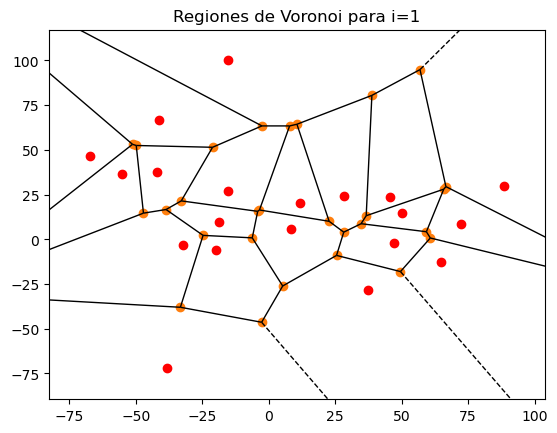

1 0
70.2916126609971 0


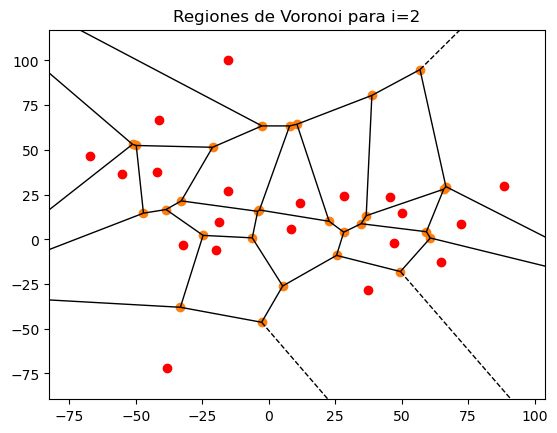

1 1
70.2916126609971 1


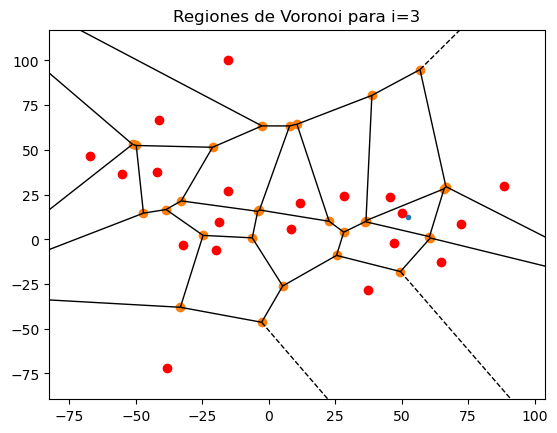

1 2
70.29228476686465 2


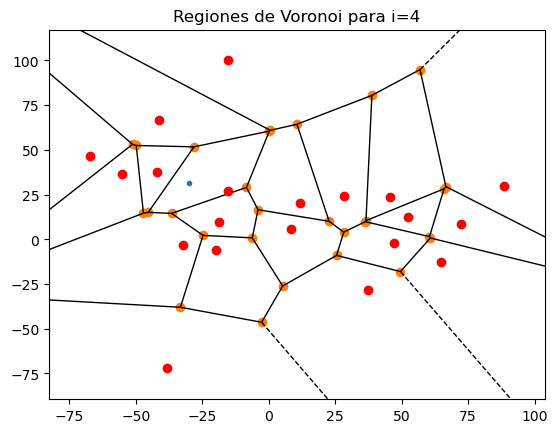

0.009559849406670158 3


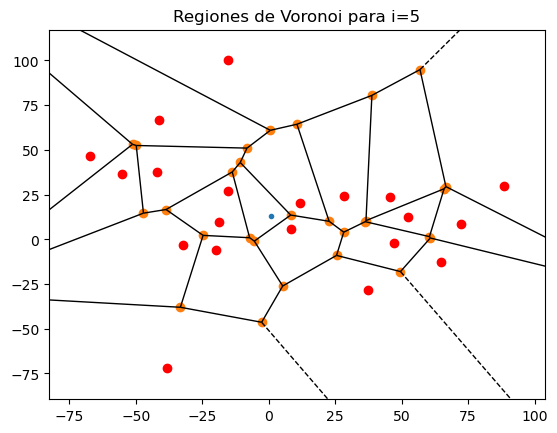

0.2582769424742465 4


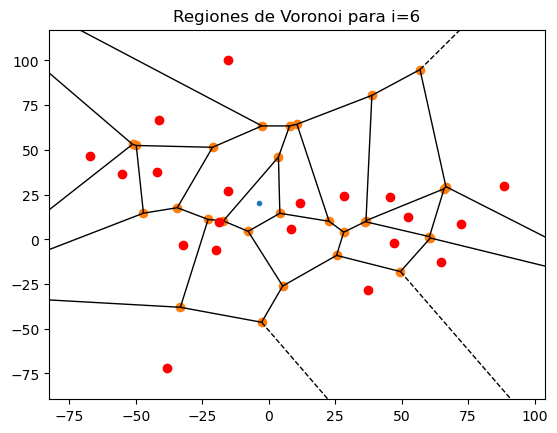

0.014482204963497674 5


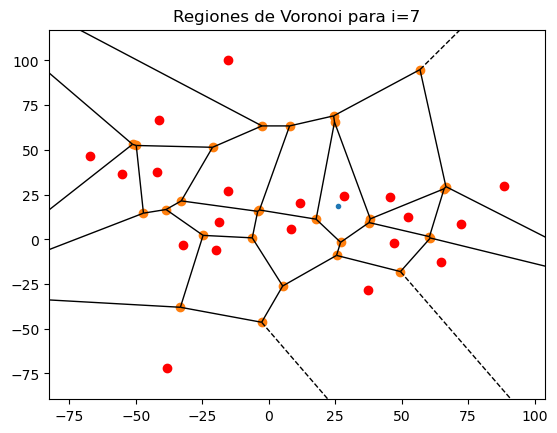

0.036222432692988325 6


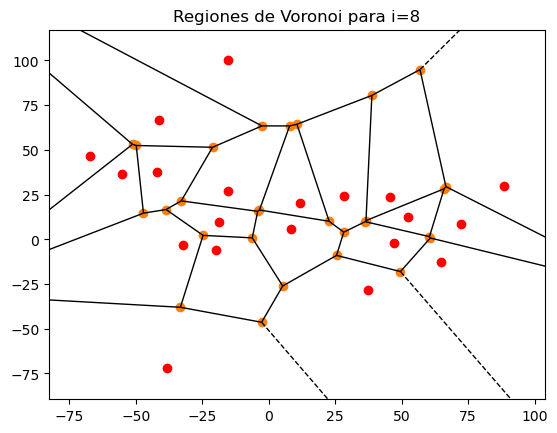

1 7
70.2923427311694 3


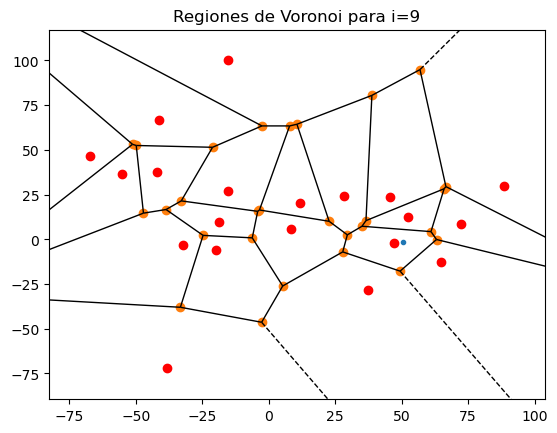

1 8
70.34161078427914 4


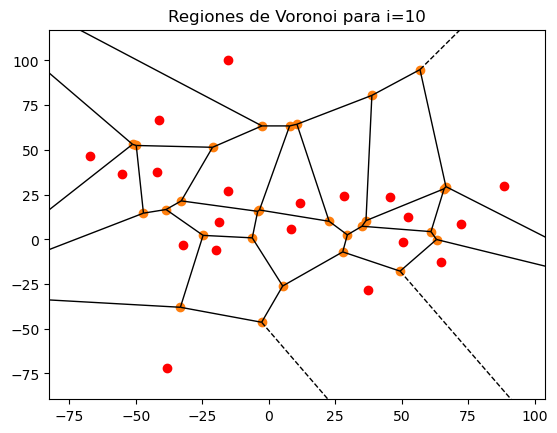

1 9
70.34261181069604 5


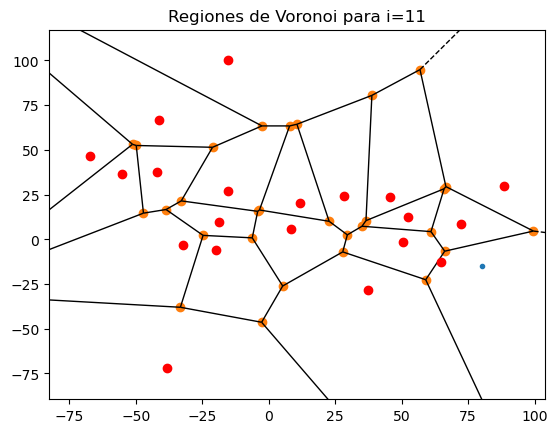

0.9942545596011539 10
69.93846252703852 6


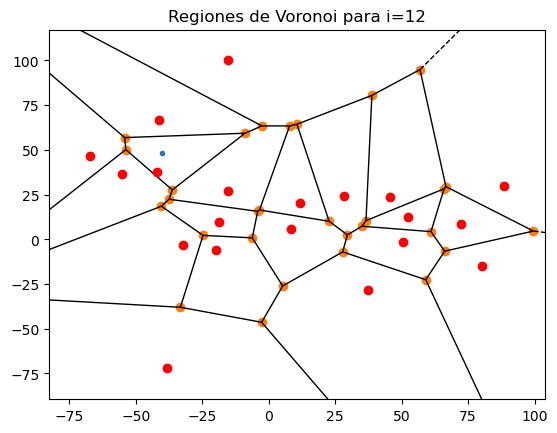

0.05711821660661649 11


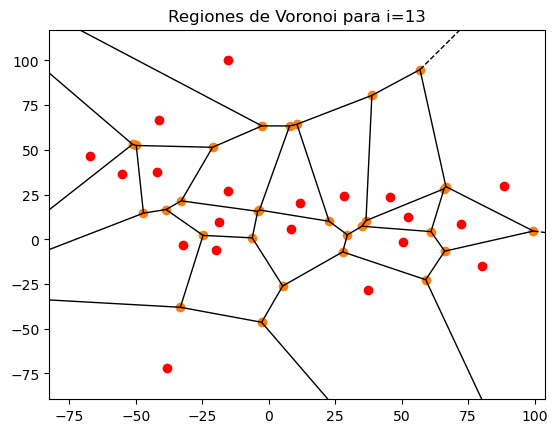

0.9976739564929091 12
69.77578262038159 7


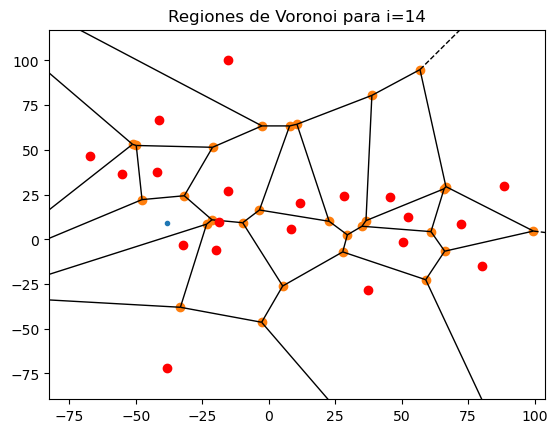

0.11719847846200648 13


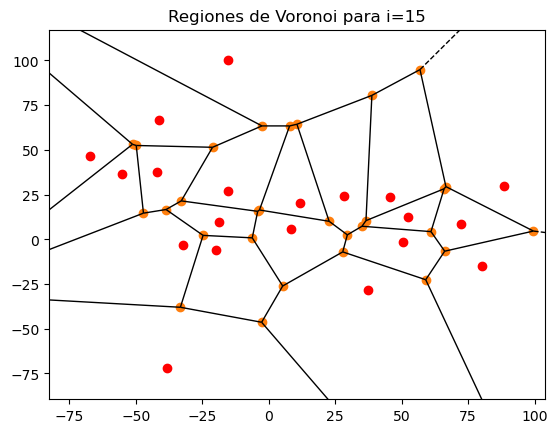

1 14
69.77578262038159 8


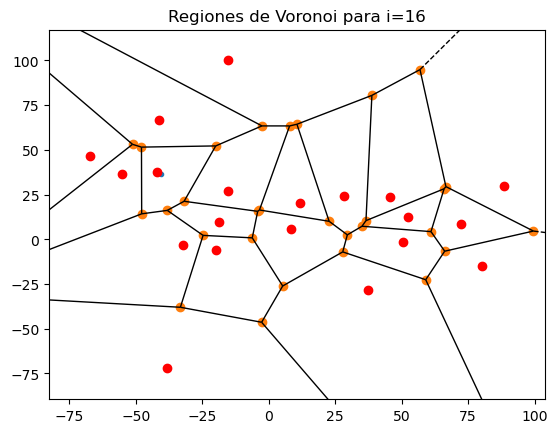

0.3165815250134165 15


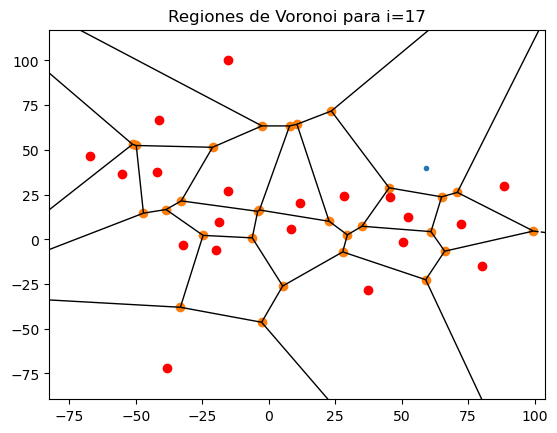

0.12786840374901456 16


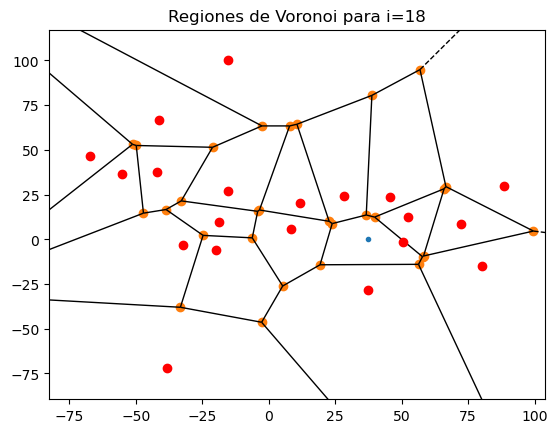

0.02151337993344425 17


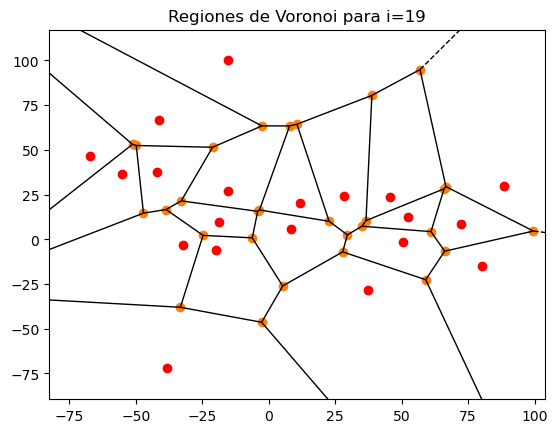

1 18
69.77578262038159 9


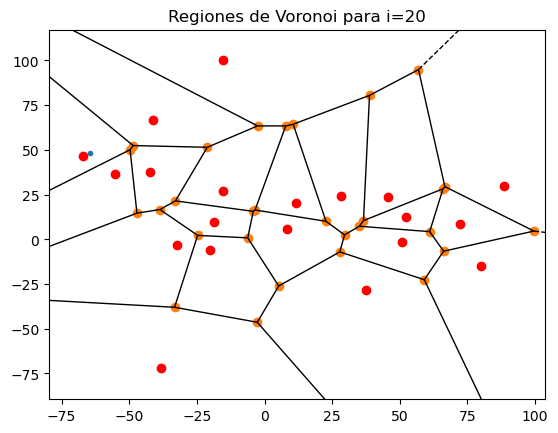

0.0056646857181169245 19


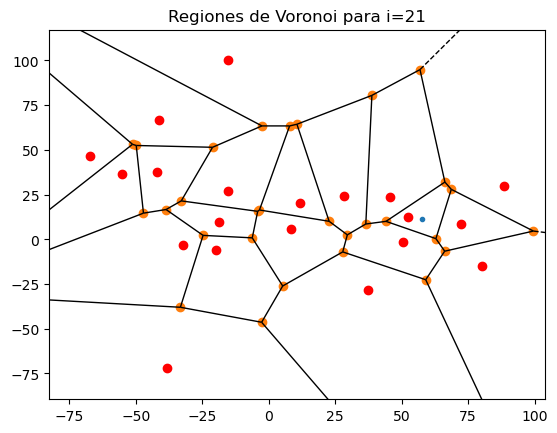

0.6520826288622448 20
45.49957576201896 10


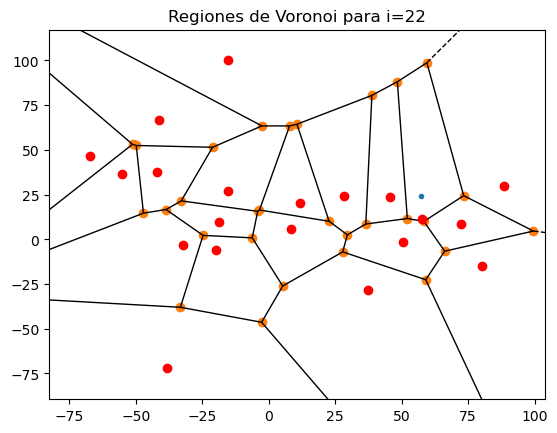

0.07166226622353247 21
3.2606027113155878 11


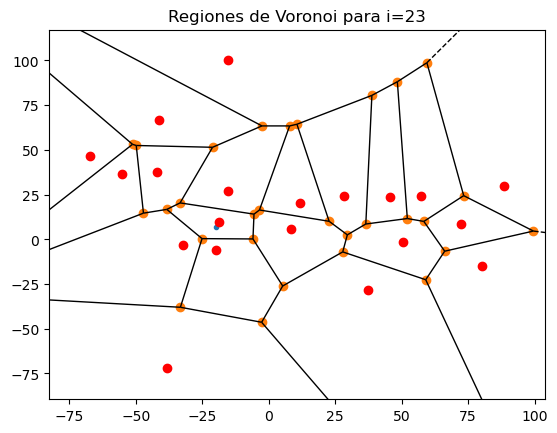

1 22
91.59932671828406 12


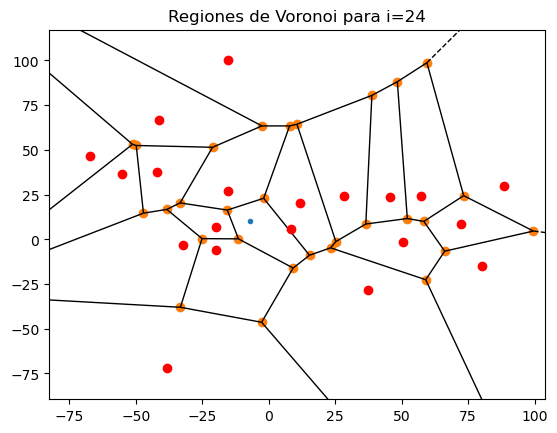

0.13862696916148973 23


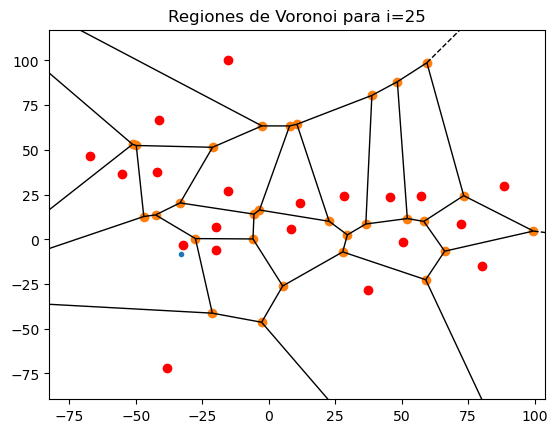

0.06024589937925455 24


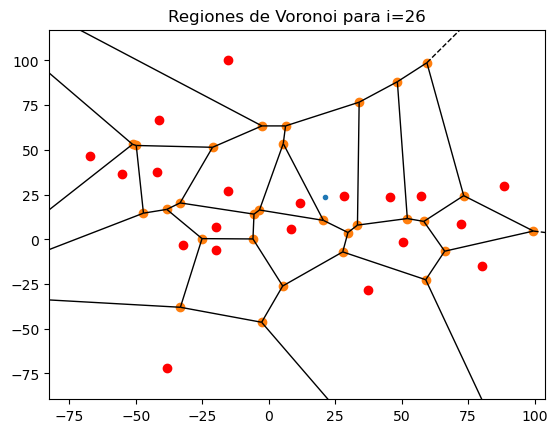

0.3288878762354077 25


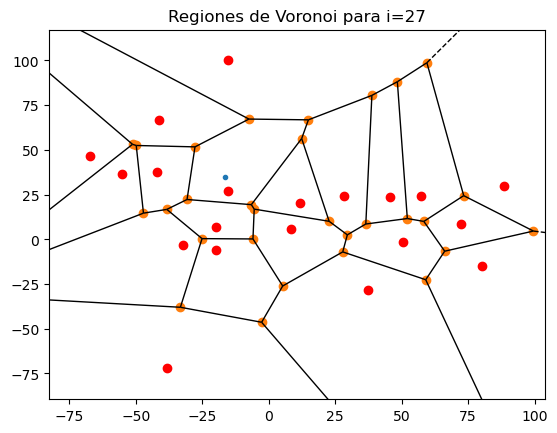

0.08562660963041863 26


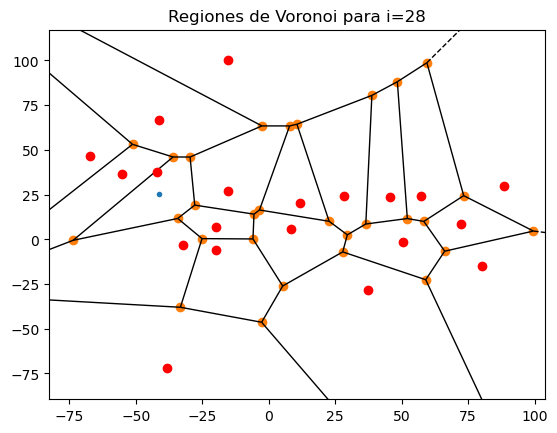

0.01562825041142641 27


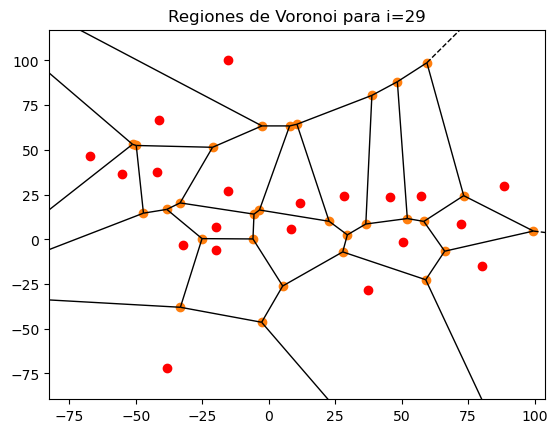

1 28
91.66464005861877 13


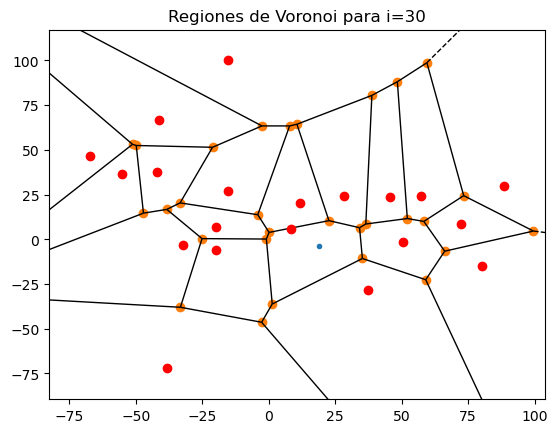

0.08585746377167885 29


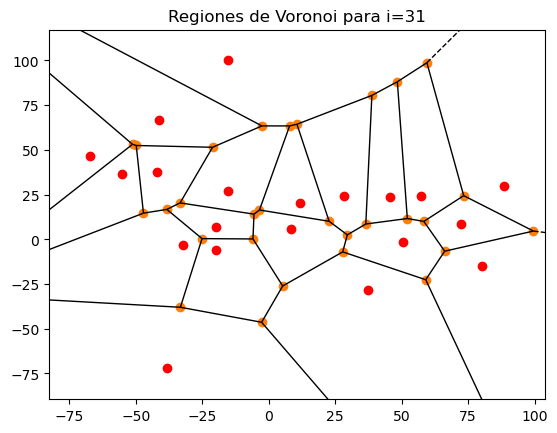

1 30
91.66464005861877 14


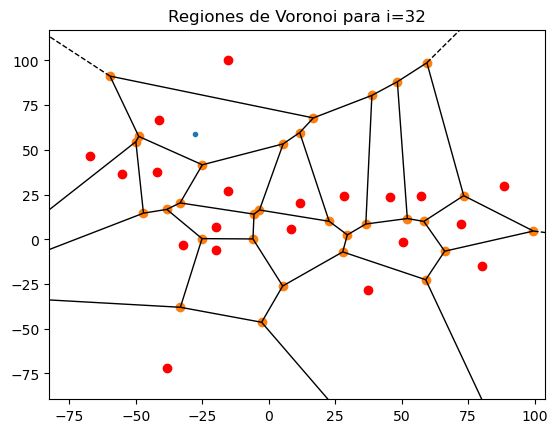

0.17253735482309718 31


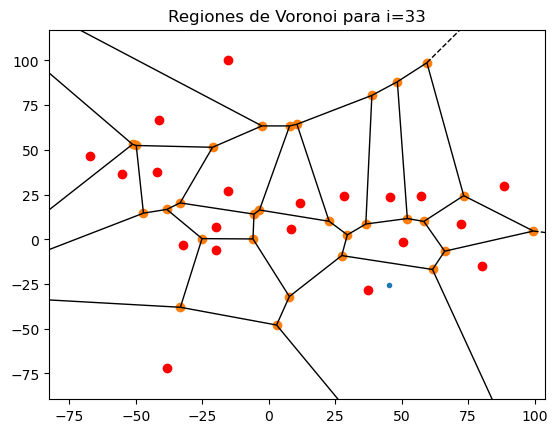

0.006555981688227355 32


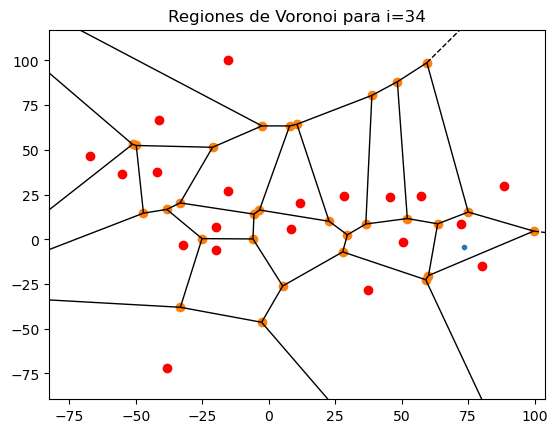

1 33
91.67011562301937 15


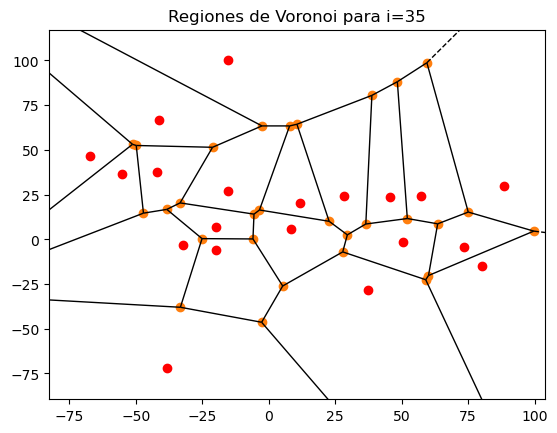

1 34
91.67042986428329 16


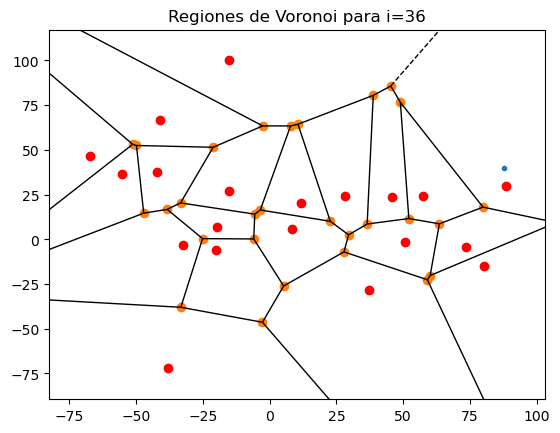

0.274400354587774 35
25.154398459973002 17


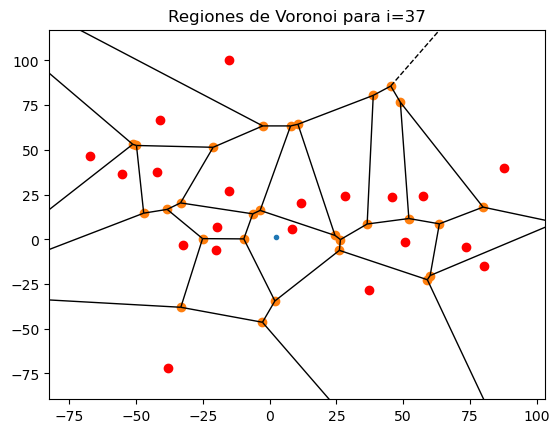

0.030110252337457365 36


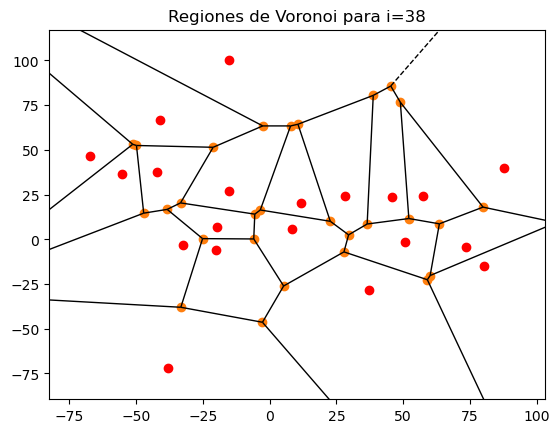

1 37
91.7975926776997 18


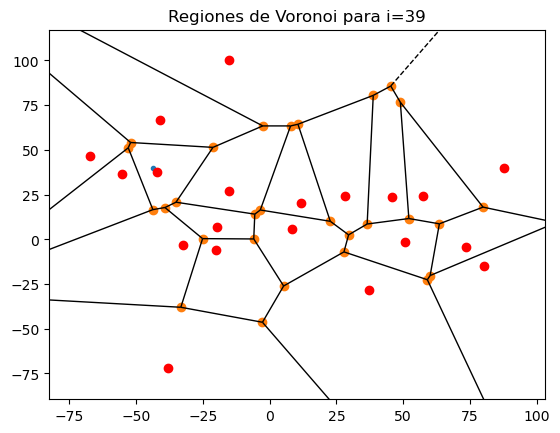

0.02880475533330085 38


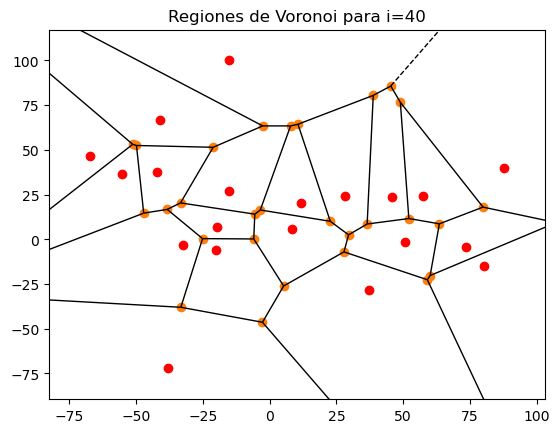

1 39
91.7975926776997 19


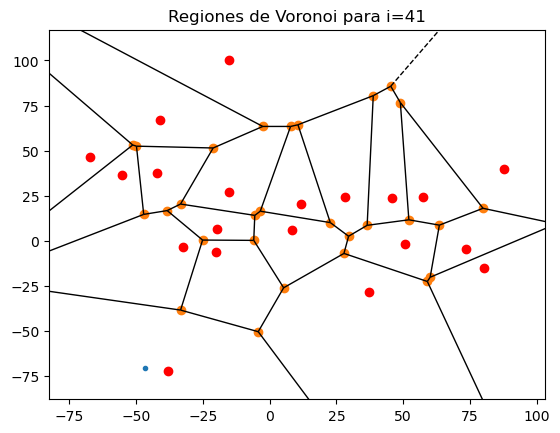

0.9915244576078261 40
91.01955828946035 20


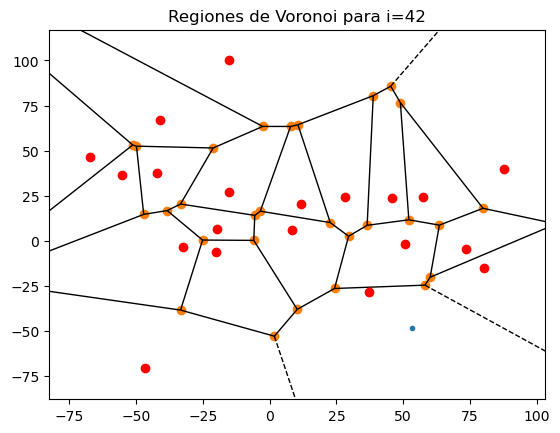

0.07801237212091408 41


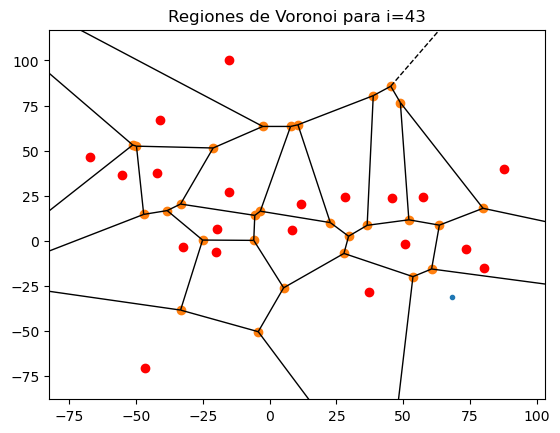

0.029302242437330383 42


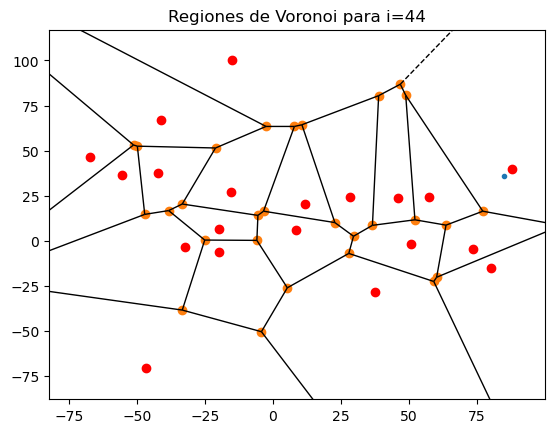

0.999255041135692 43
90.95175246268721 21


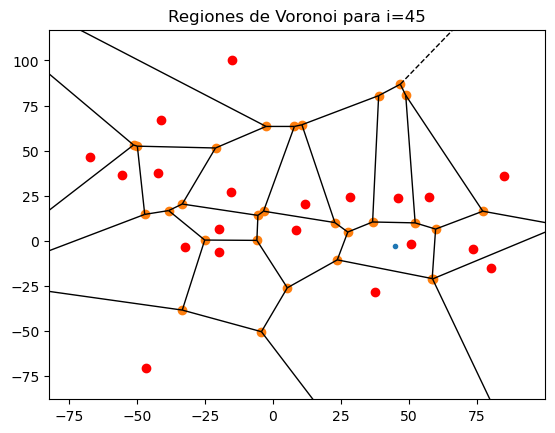

0.9998023929450007 44
90.93377975473604 22


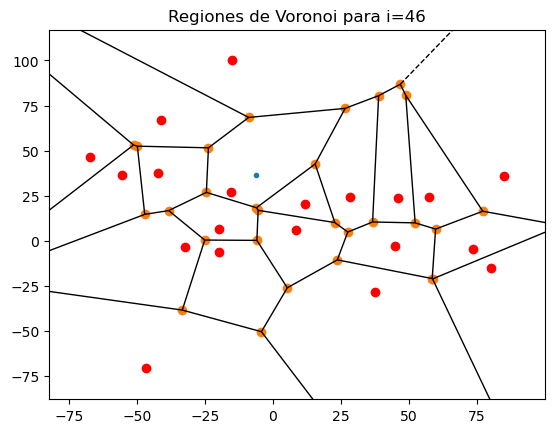

0.012761405957629183 45


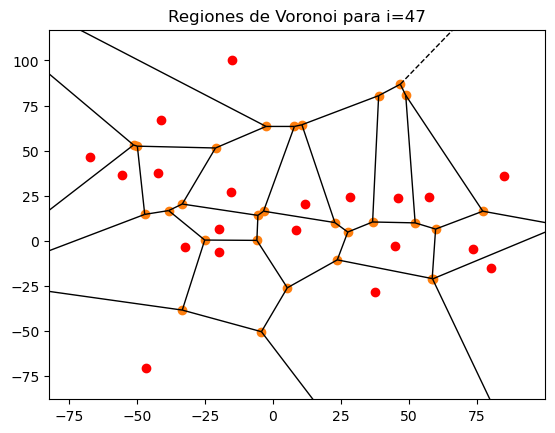

0.999998963105926 46
90.93368546603868 23


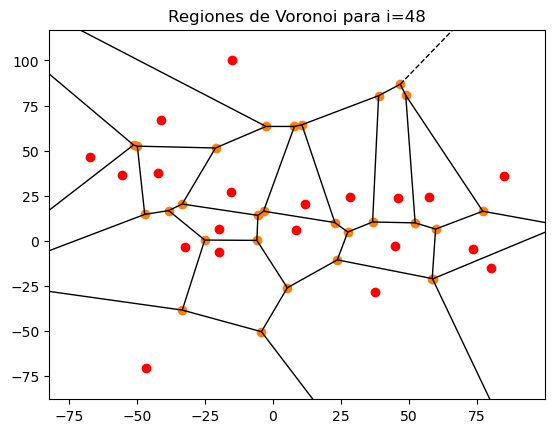

1 47
90.93368546603868 24


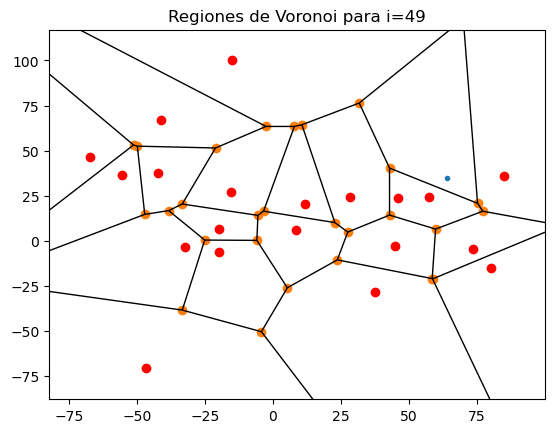

0.02785897674020982 48


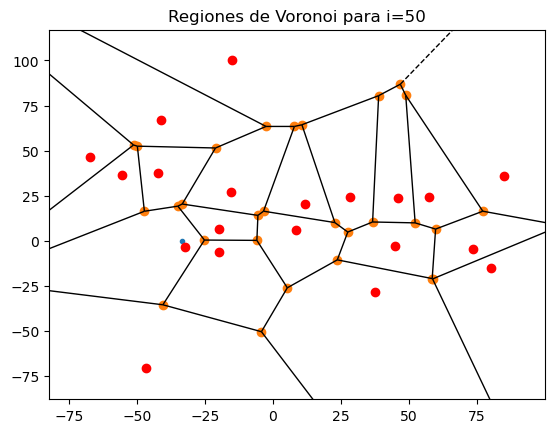

0.011325858598028975 49


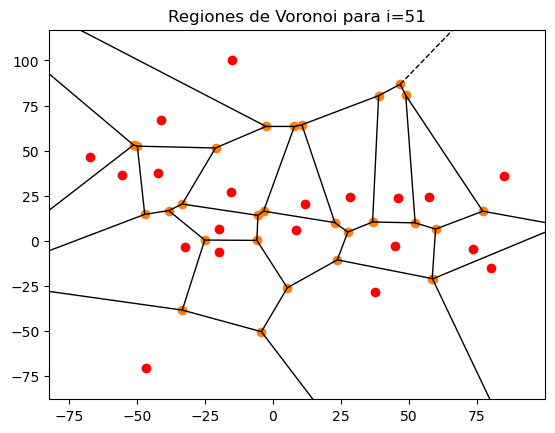

1 50
90.93368546603868 25


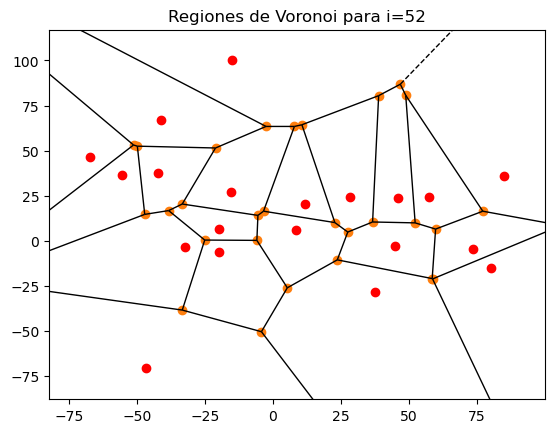

1 51
90.93368546603868 26


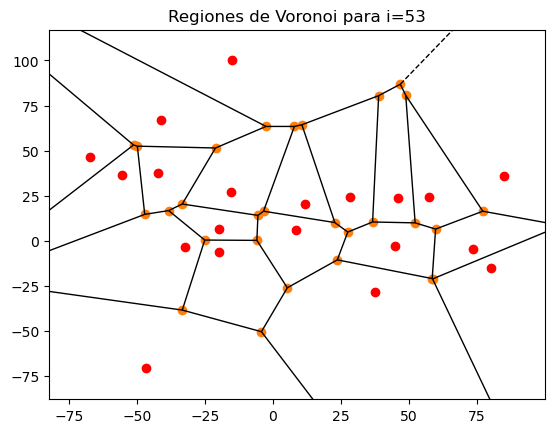

1 52
90.93368546603868 27


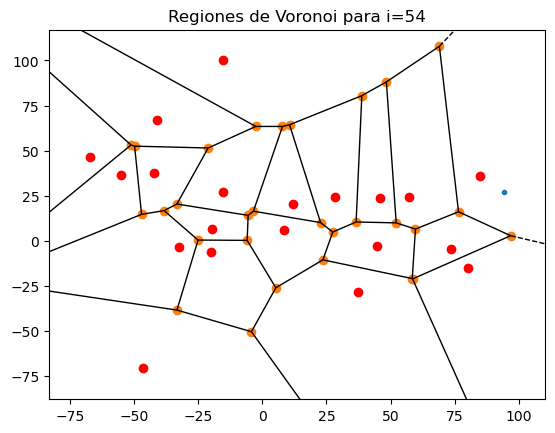

0.021675525226146665 53


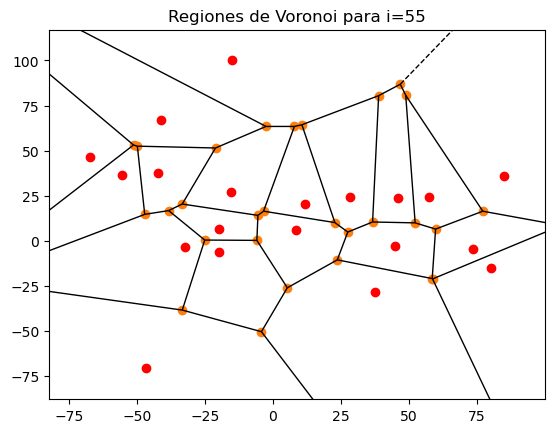

1 54
90.93368546603868 28


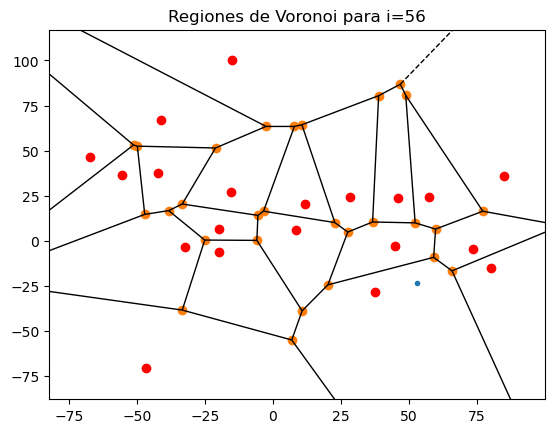

0.008025899461540642 55


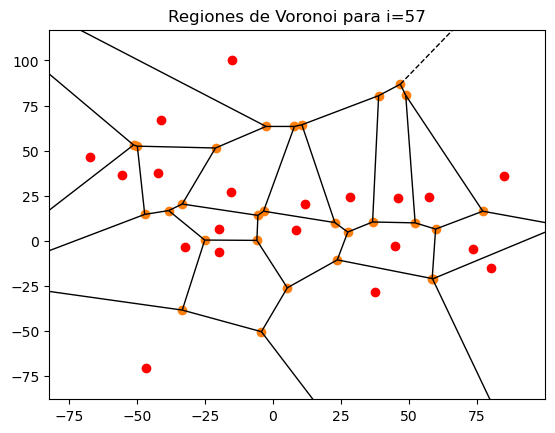

1 56
90.93368546603868 29


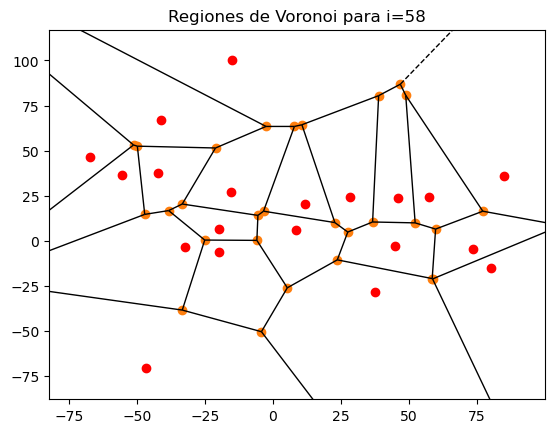

1 57
90.93368546603868 30


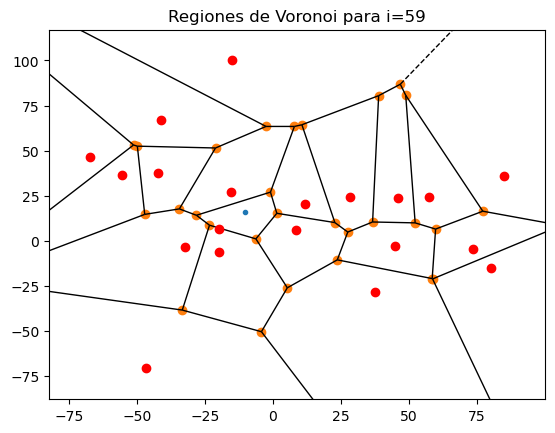

0.028568646637901766 58


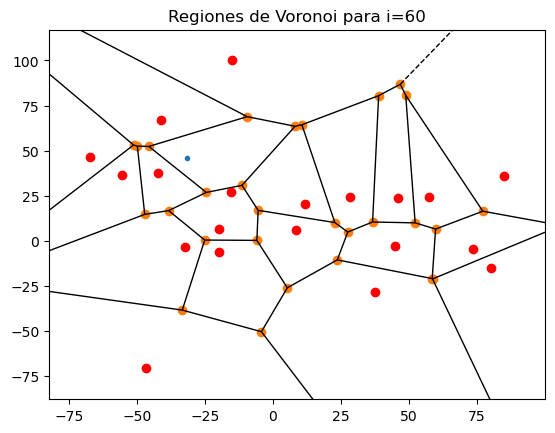

0.00688939604369384 59


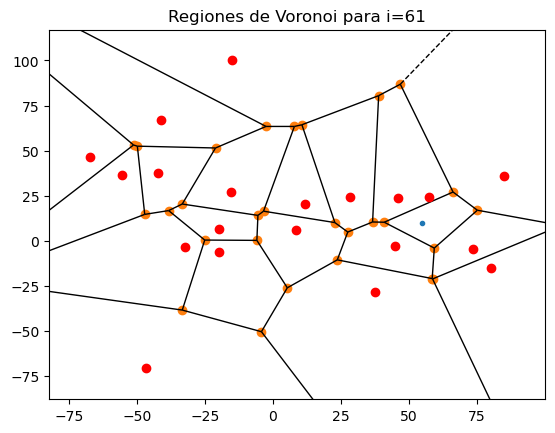

0.35722029870778105 60


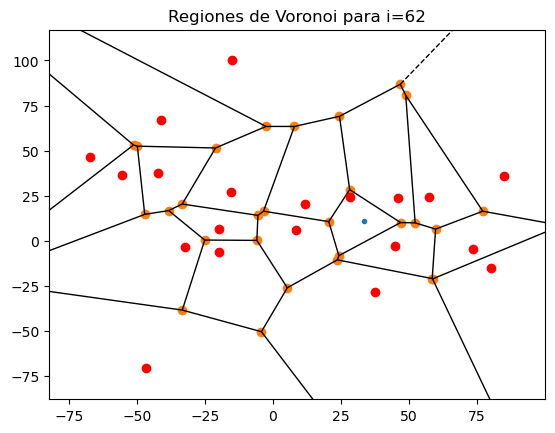

0.047390898984691496 61


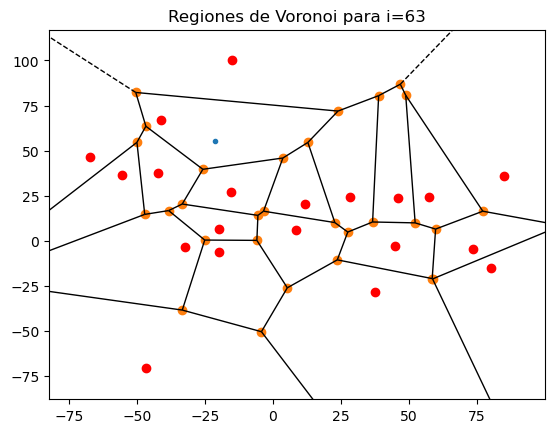

0.009390794327388695 62


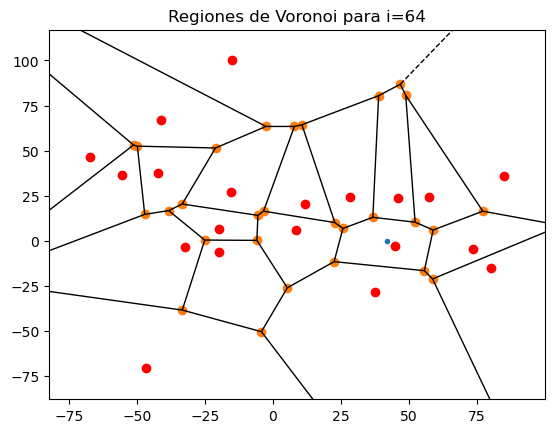

1 63
90.94460225787549 31


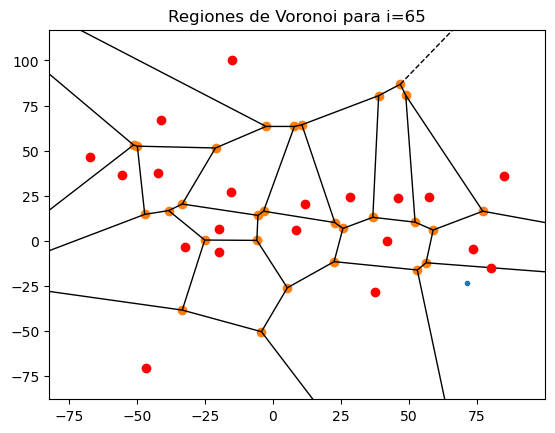

1 64
90.95510278714393 32


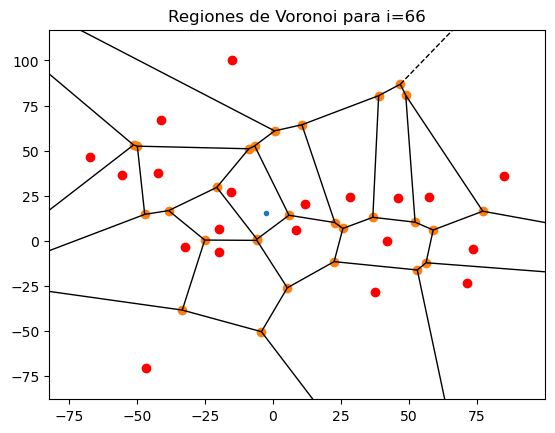

0.023157642392894723 65


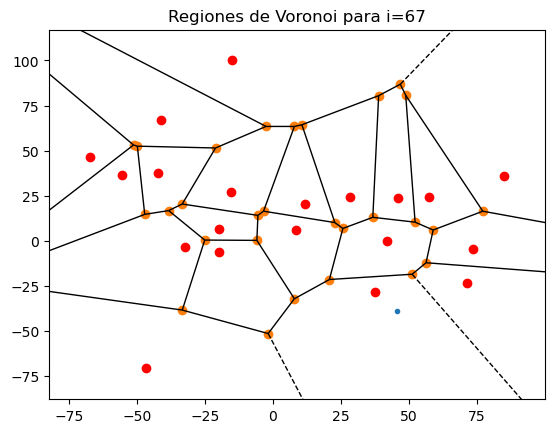

0.005311820573129882 66


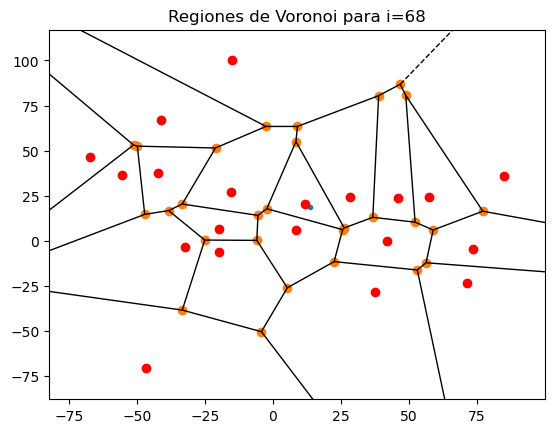

1 67
91.85179723711846 33


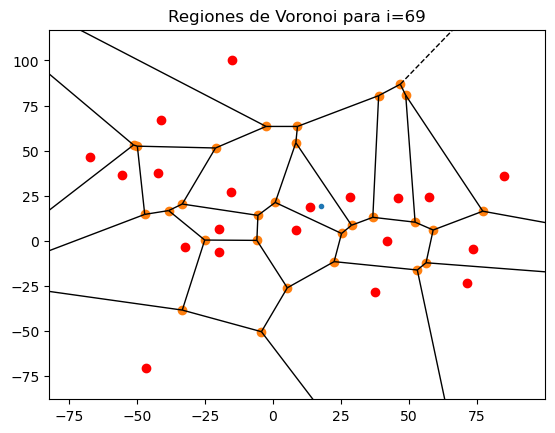

0.9971154895178331 68
91.58684976518212 34


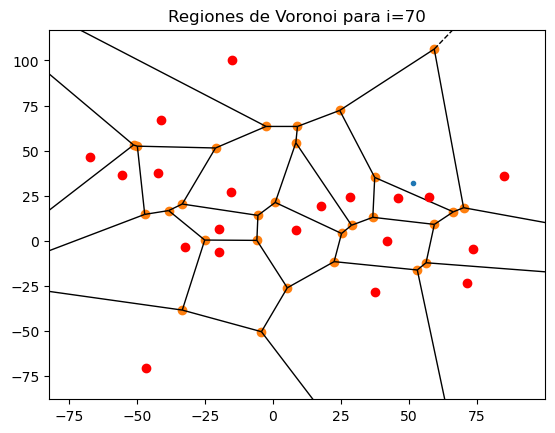

0.16765626956327132 69


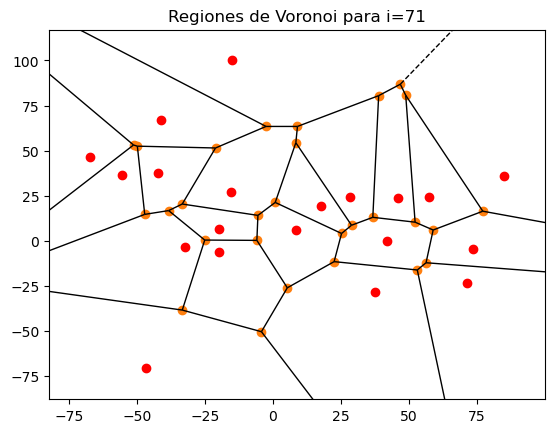

1 70
91.59170754928323 35


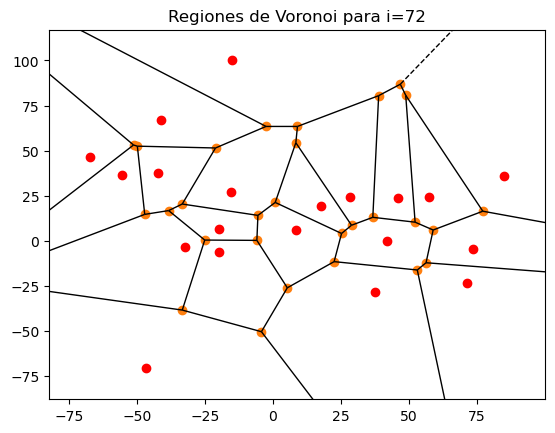

1 71
91.59170754928323 36


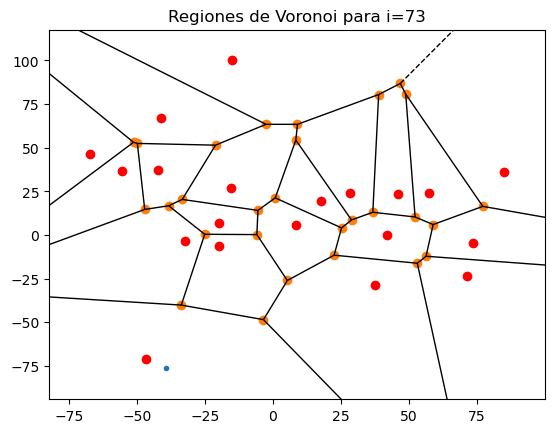

1 72
91.96958368308499 37


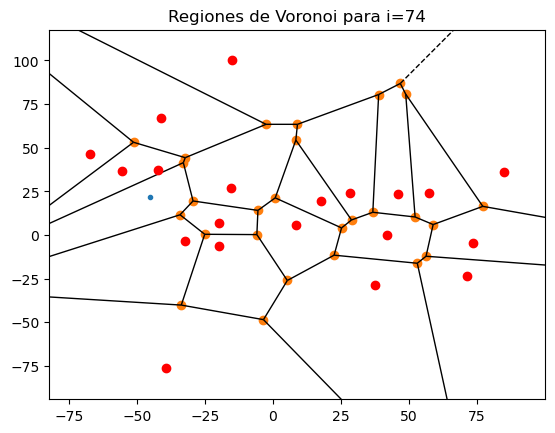

0.008030071141635741 73


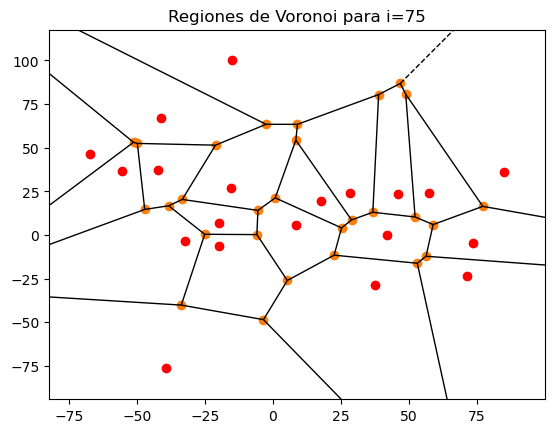

1 74
92.07441937658034 38


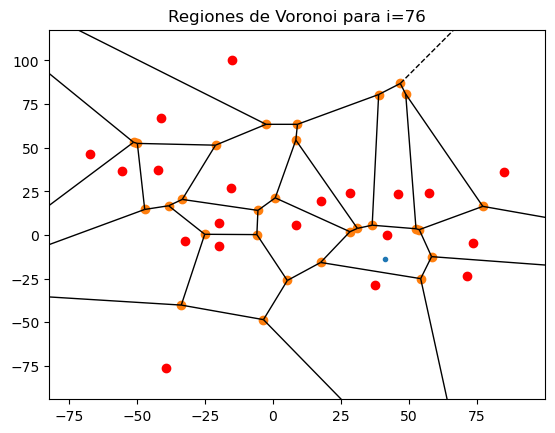

0.3830060249350203 75
35.265057363624045 39


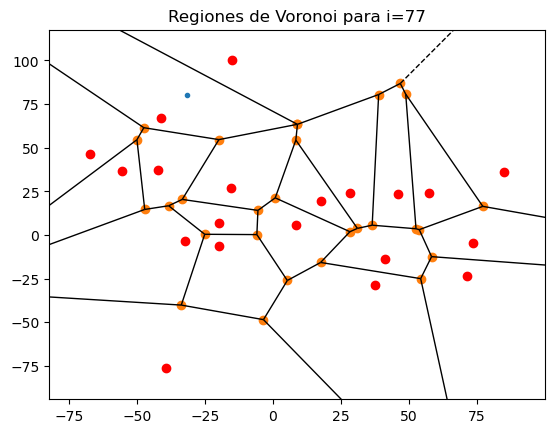

0.07008532421825546 76


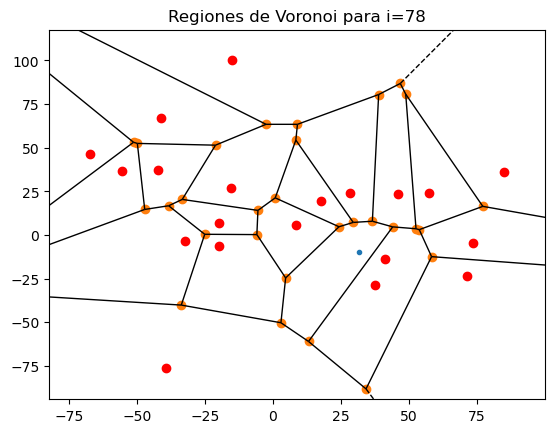

0.055393921307959934 77


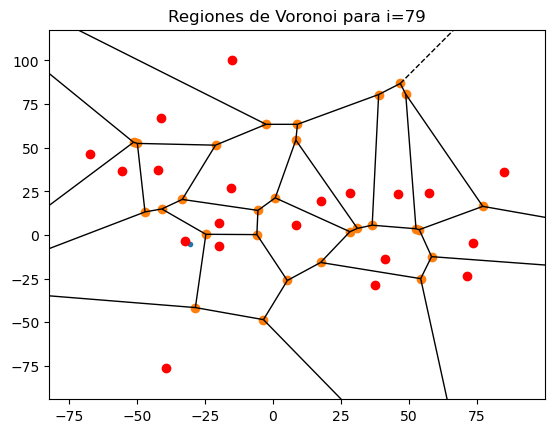

0.406576799214116 78


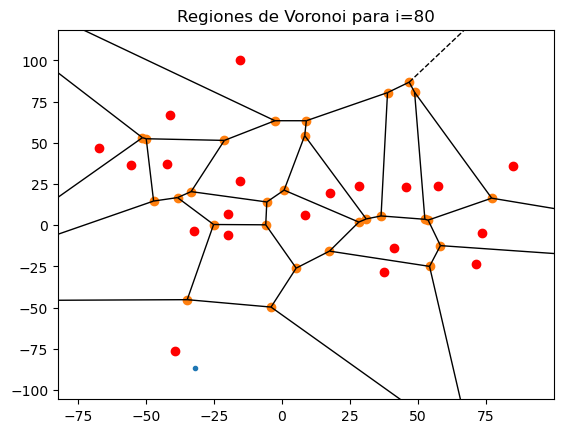

0.05898025535023743 79


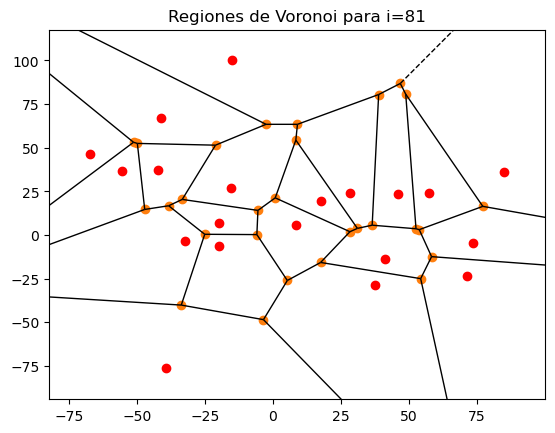

1 80
92.85165376871228 40


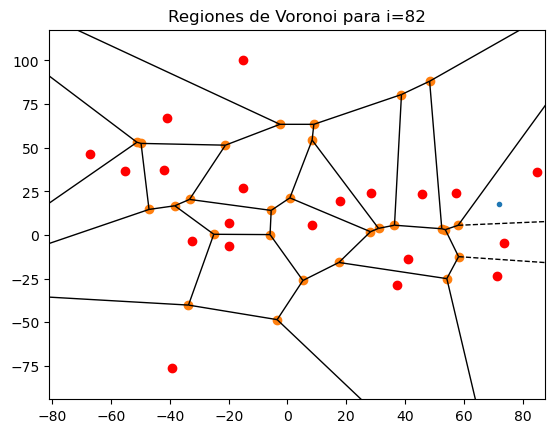

0.03908433617940072 81


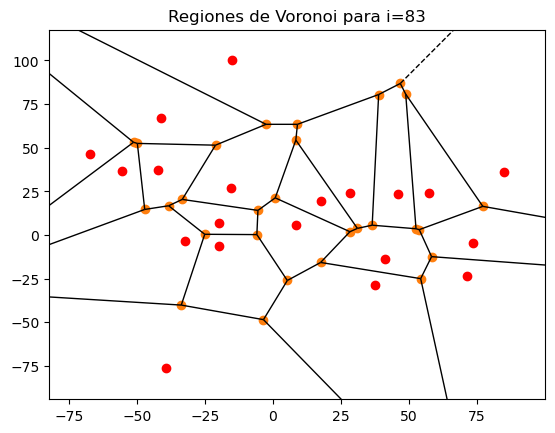

1 82
92.85165376871228 41


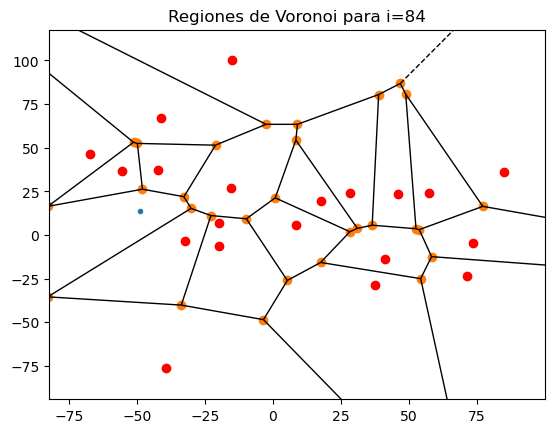

0.0034380420315276686 83


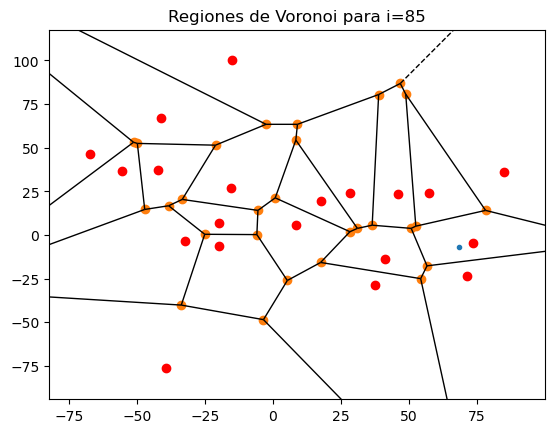

0.03523744946941725 84


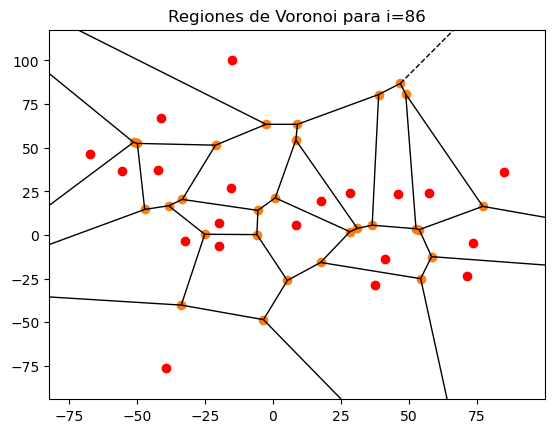

1 85
92.85165376871228 42


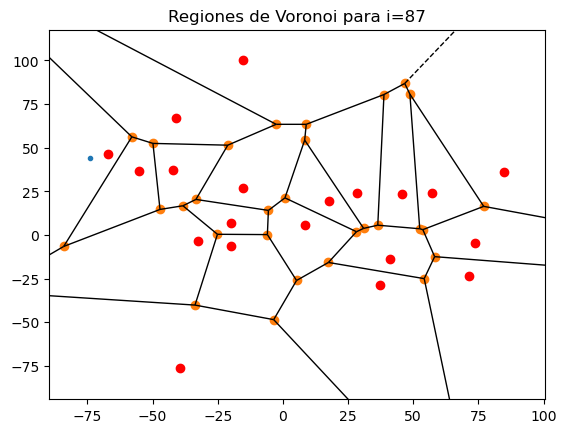

0.9950295269646133 86
92.39013712736384 43


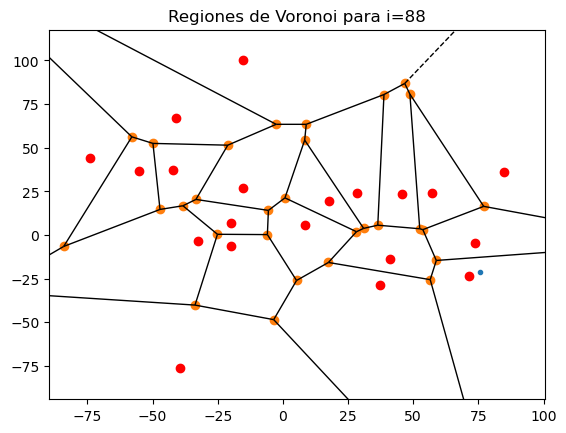

0.9996056011399188 87
92.35369856259807 44


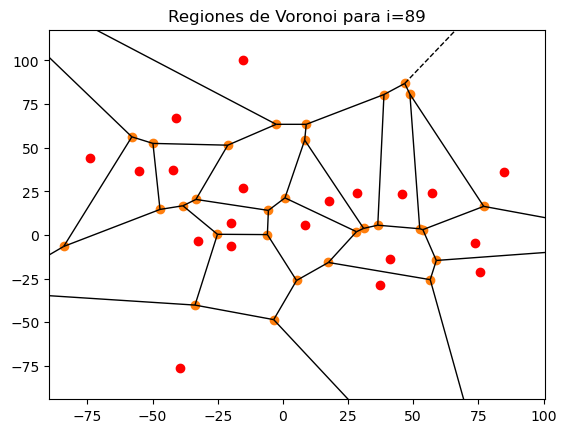

1 88
92.35403384144072 45


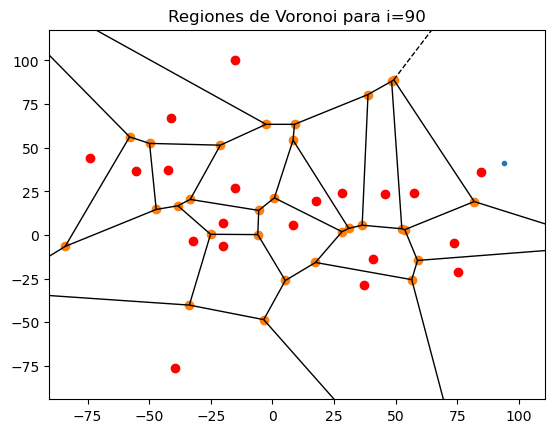

0.3467680561251199 89
32.02542879050994 46


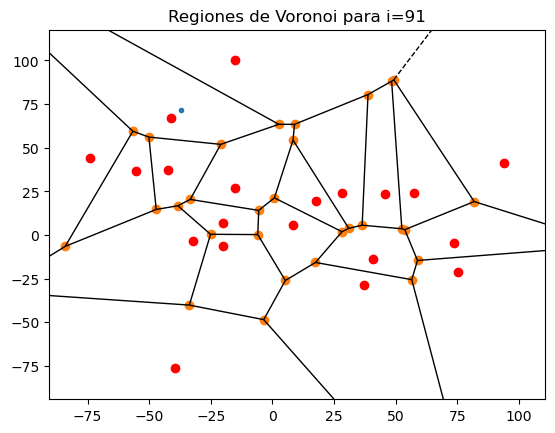

1 90
767.9570461852071 47


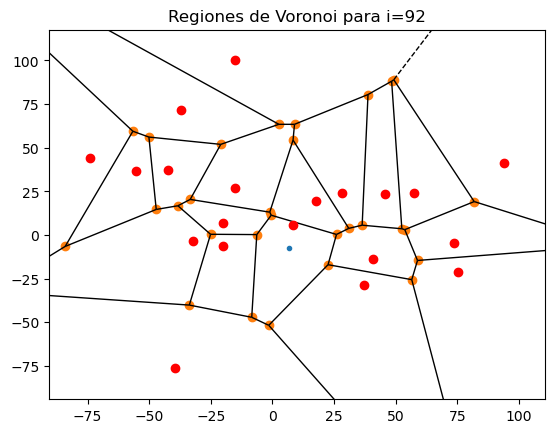

0.650751238946335 91
499.7489992625914 48


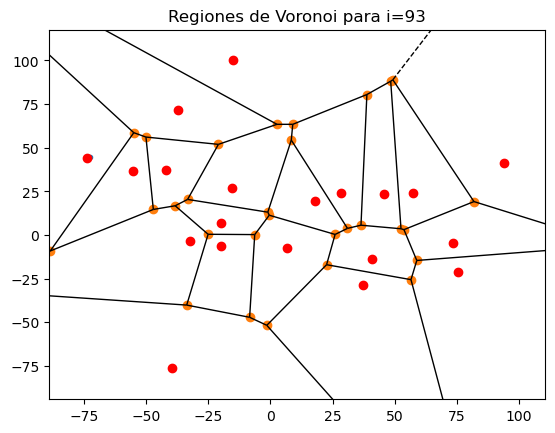

0.11425096250321301 92


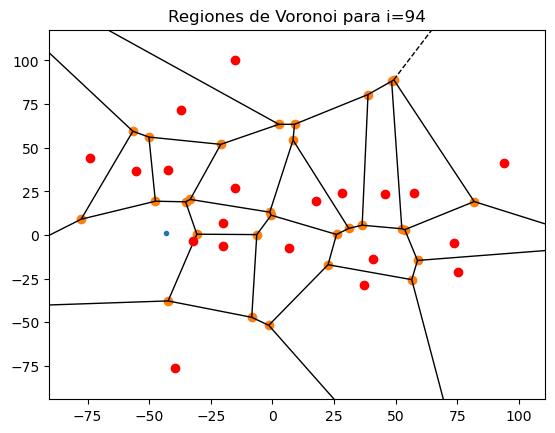

0.14238503870636748 93


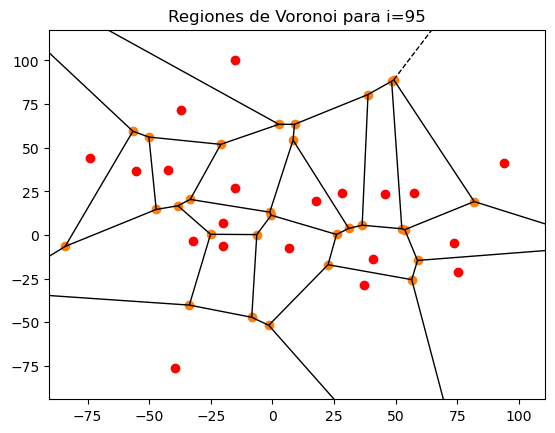

0.1025288163486725 94


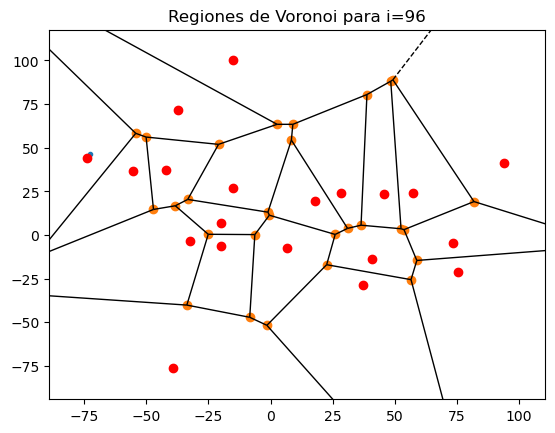

0.023139001247761127 95


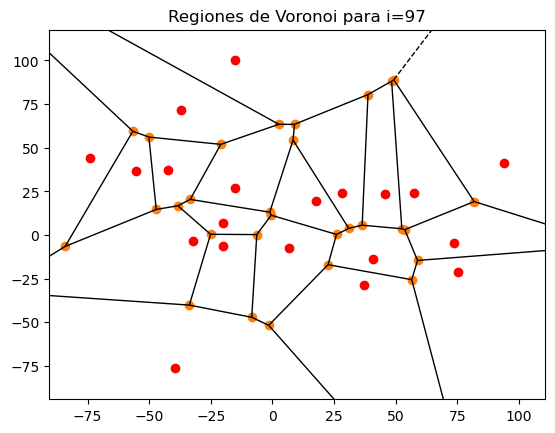

0.1025288163486725 96


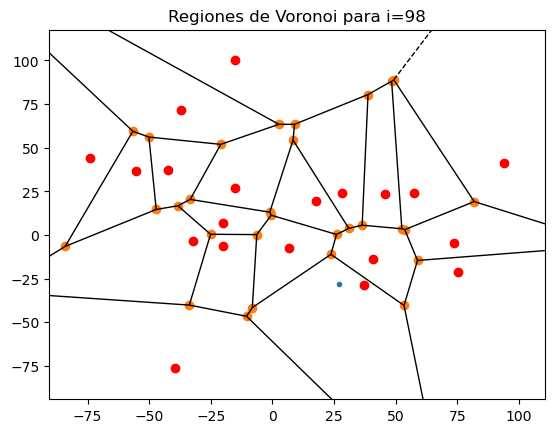

1 97
1409.456137266545 49


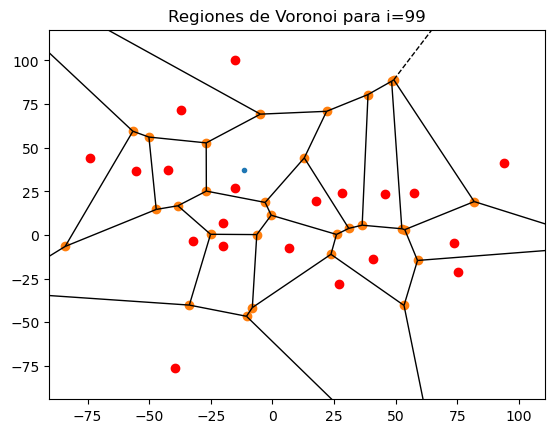

0.0019120060572848032 98


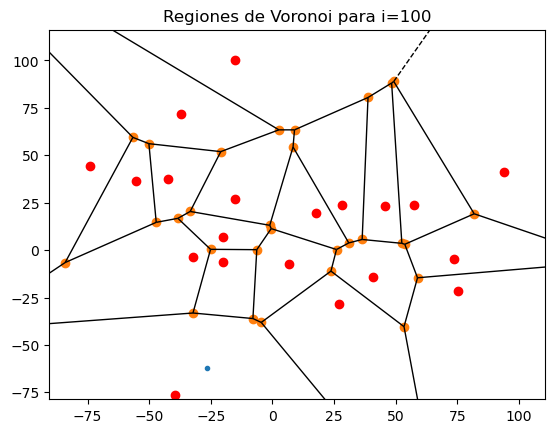

0.0010293510612275755 99


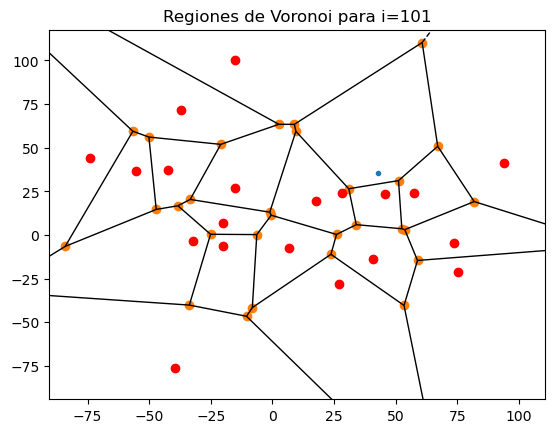

0.00040422697352555416 100


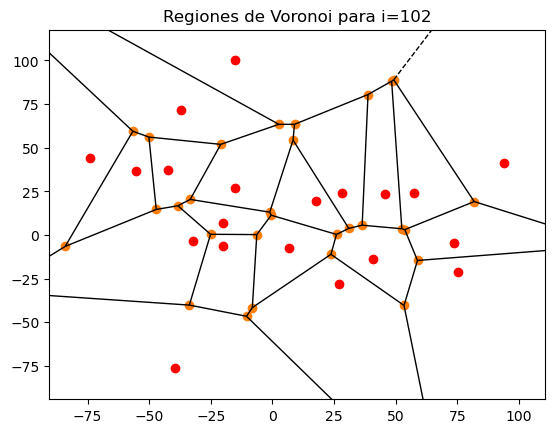

0.03499206057663086 101


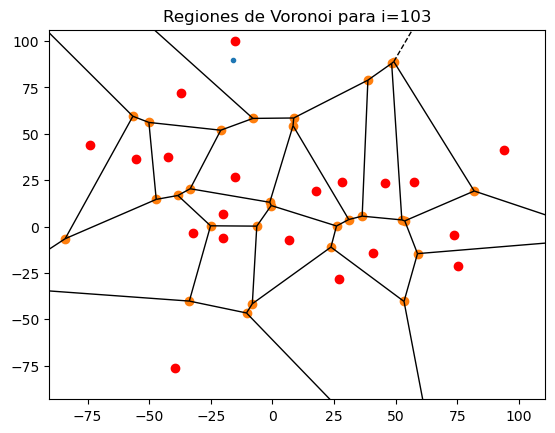

0.011832076977210252 102


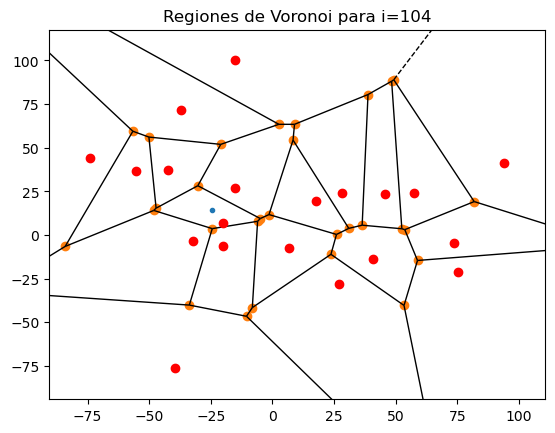

0.033988409529822114 103


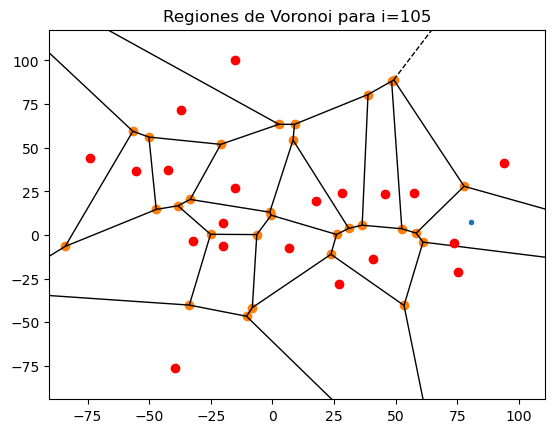

1 104
3053.665194506941 50


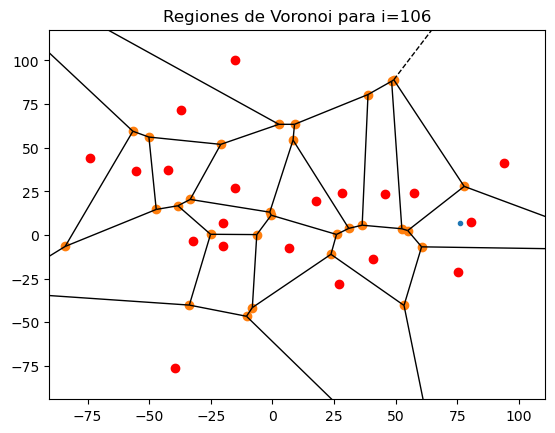

0.46162484620185573 105


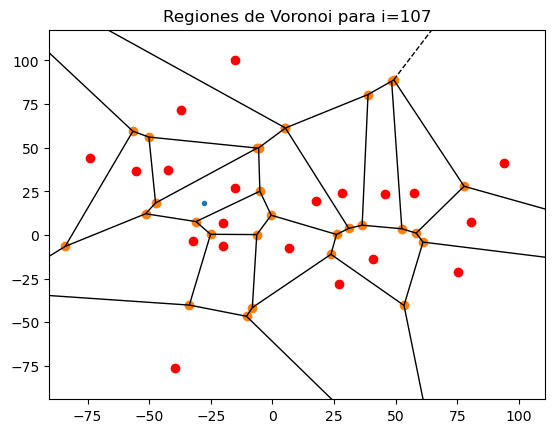

0.000813700132149392 106


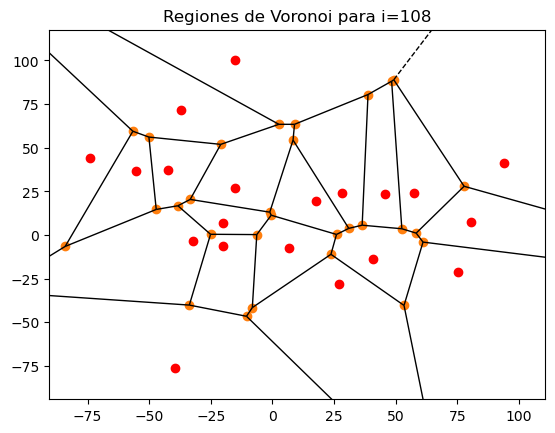

0.016259023217126307 107


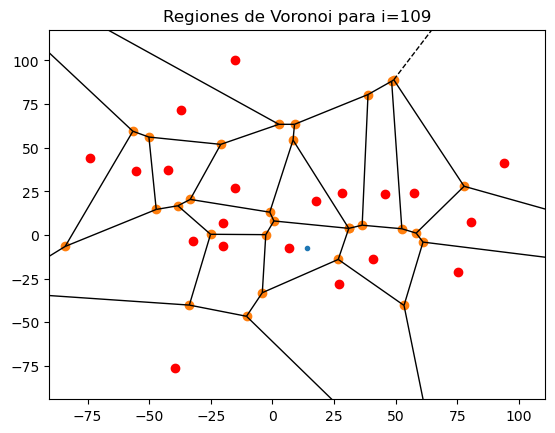

0.016168001715001826 108


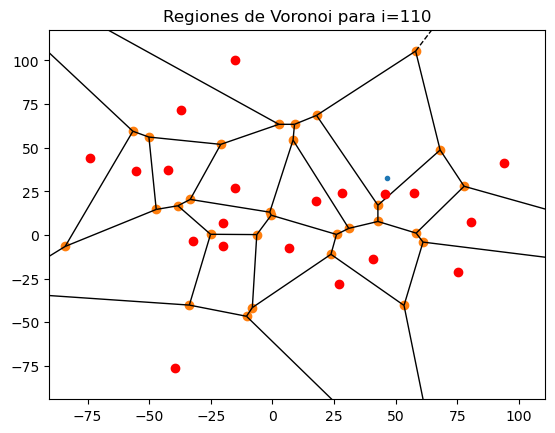

0.00024103872925215452 109


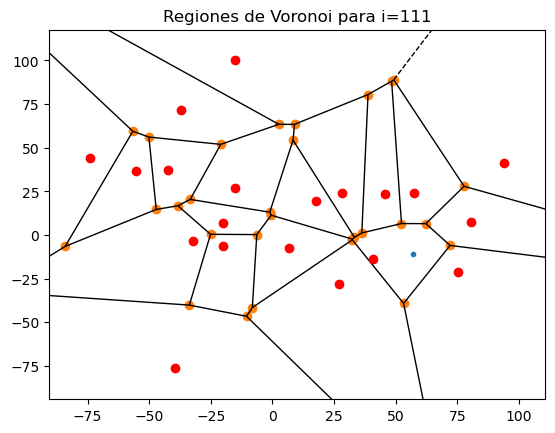

0.020744676581284132 110


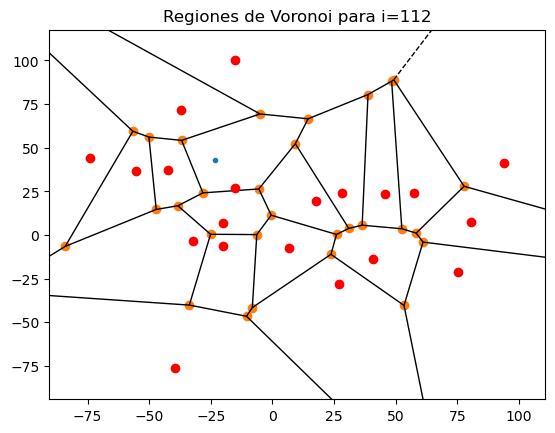

0.0203313979689126 111


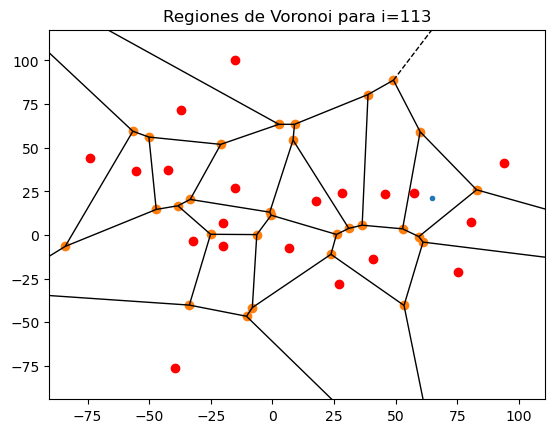

0.0006013286796465902 112


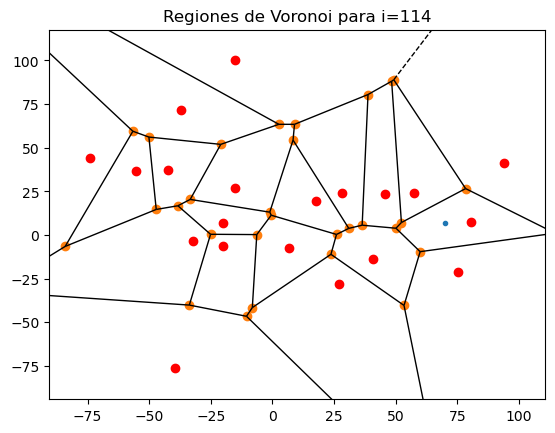

0.001017037466631313 113


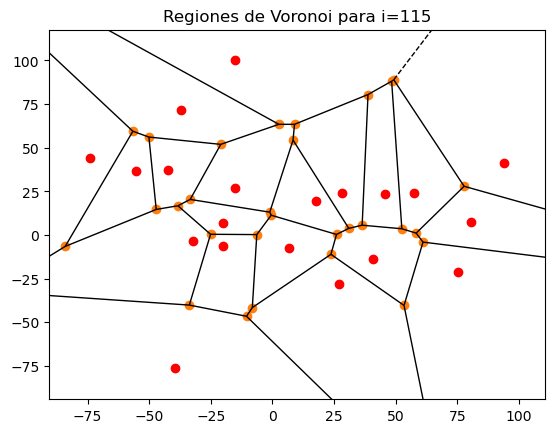

0.016259023217126307 114


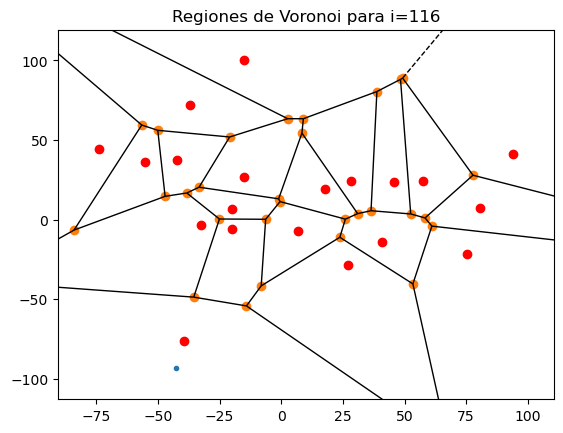

0.00015078304760248034 115


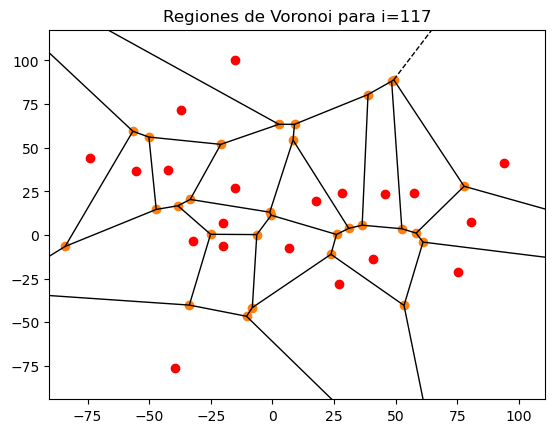

0.016259023217126307 116


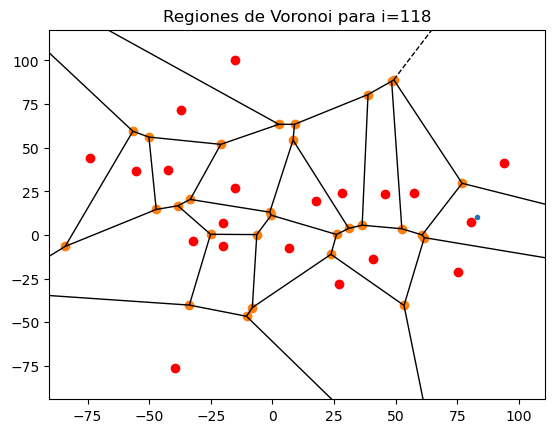

0.01625683541099841 117


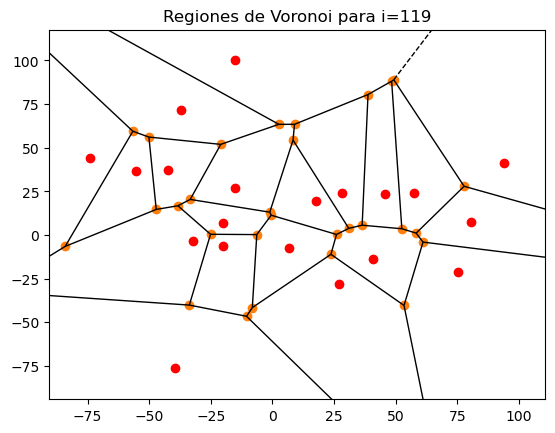

0.016259023217126307 118


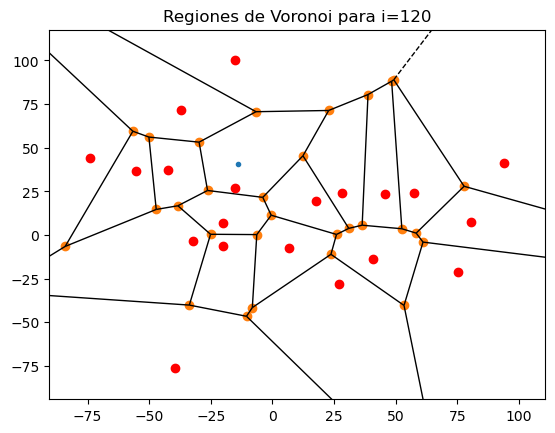

0.0005229812738357608 119


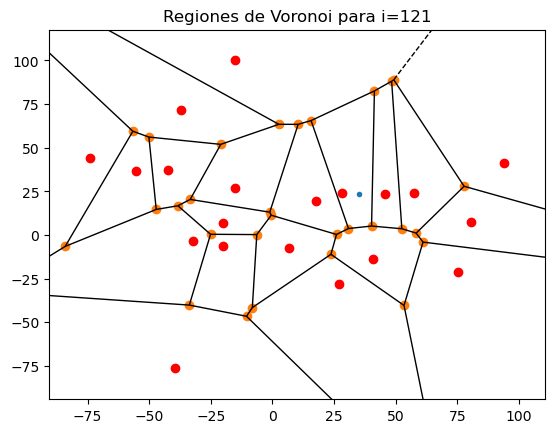

0.3380020440678849 120


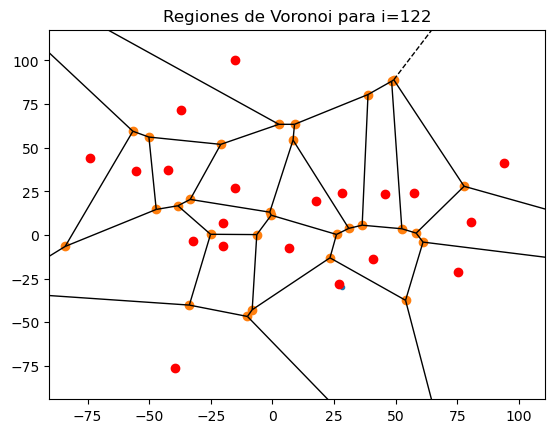

0.01625411710407687 121


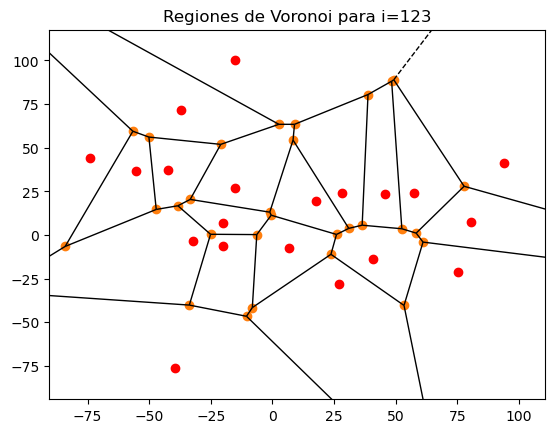

0.016259023217126307 122


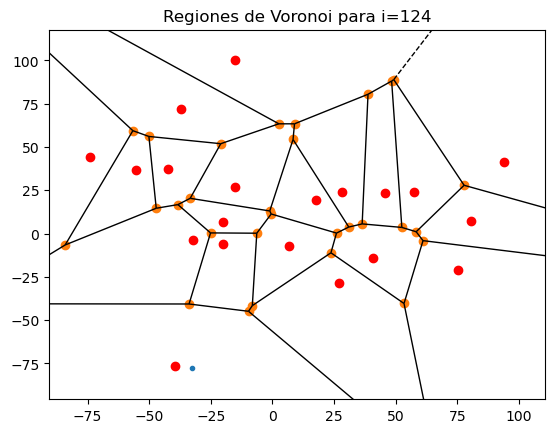

0.016259213230417797 123


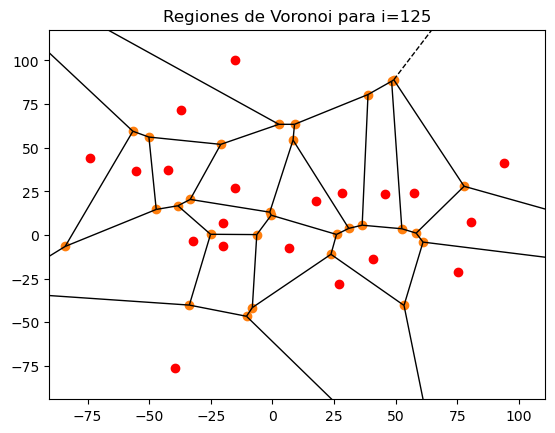

0.016259023217126307 124


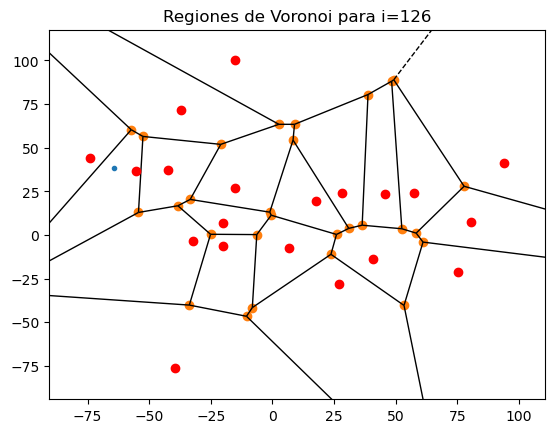

0.01601072609434752 125


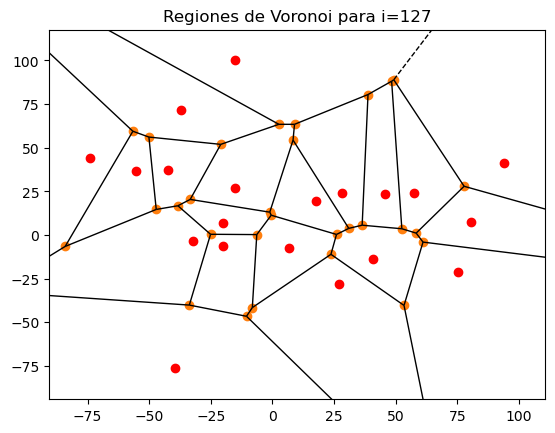

0.016259023217126307 126


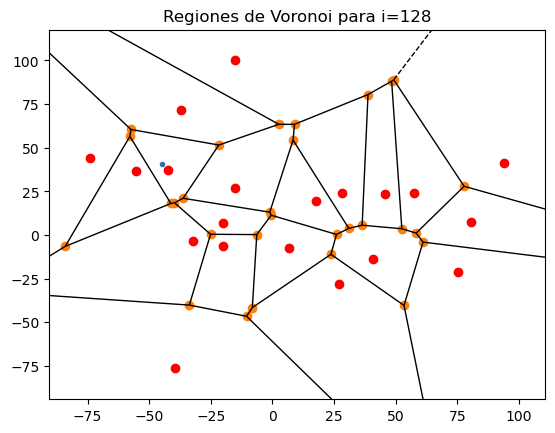

0.11850057327065865 127


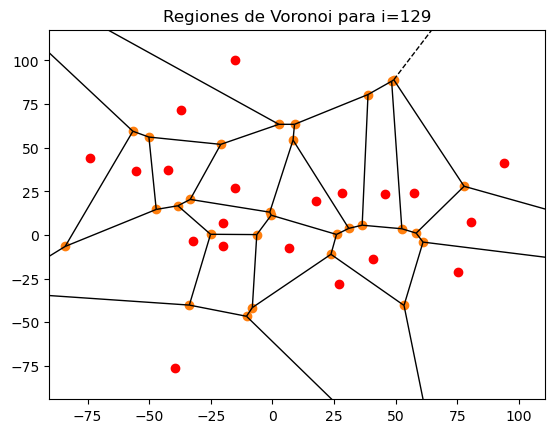

0.016259023217126307 128


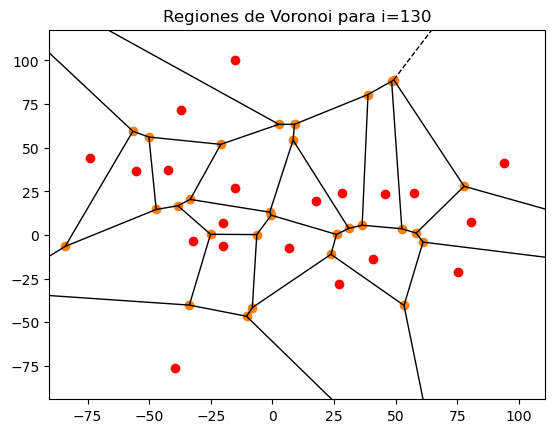

0.016259023217126307 129


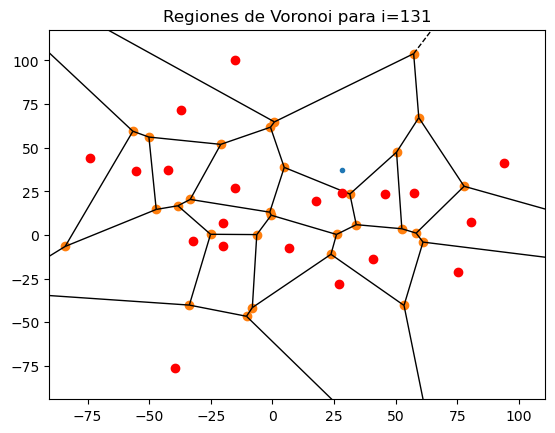

0.005735179468284423 130


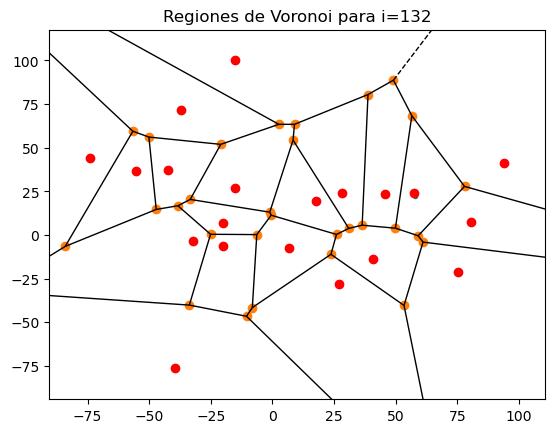

0.0006989398633832372 131


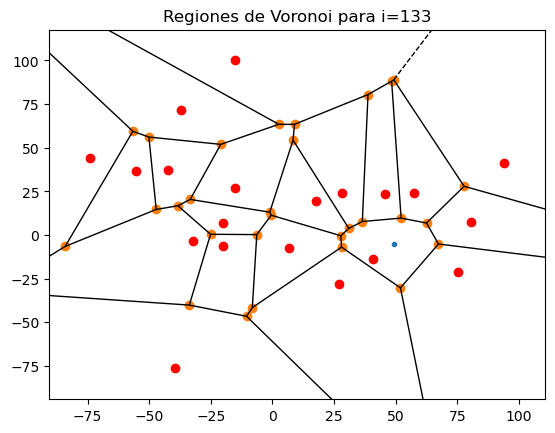

0.0010056056349825825 132


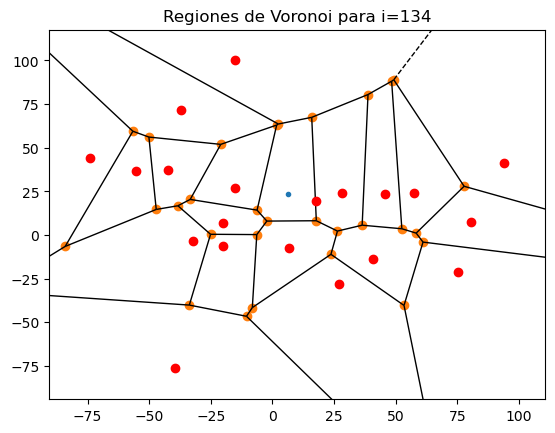

0.07795731294641321 133


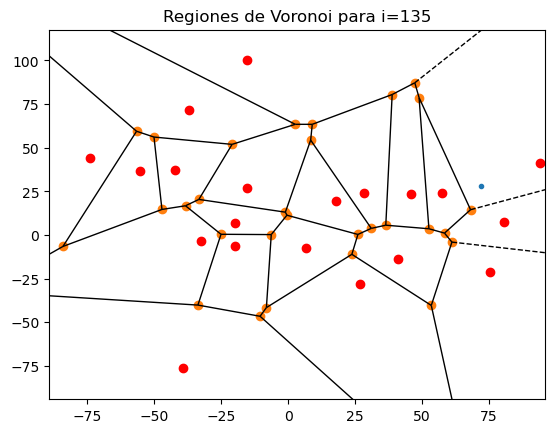

0.0049213942706827826 134


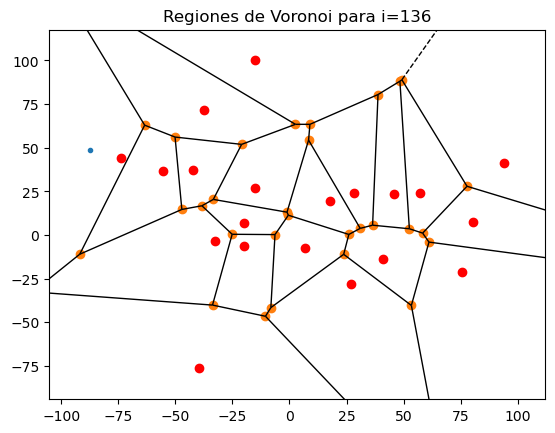

0.00039764339863146674 135


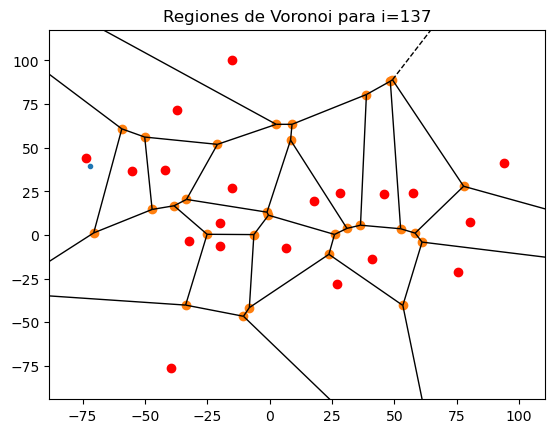

0.0006980787267791189 136


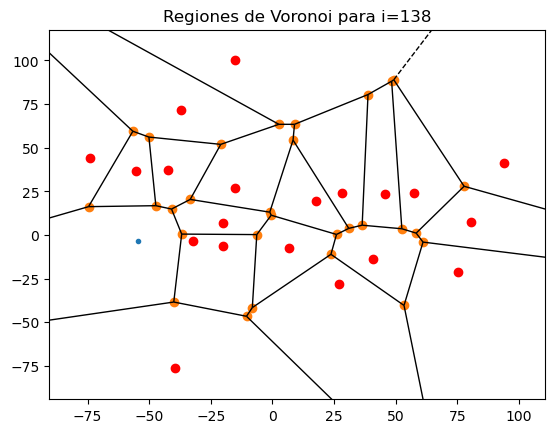

0.0004659665235922987 137


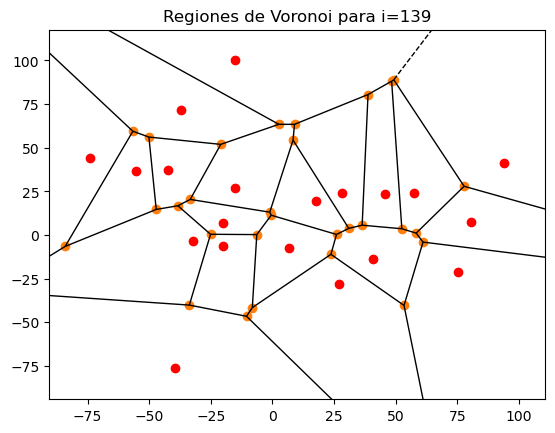

0.016259023217126307 138


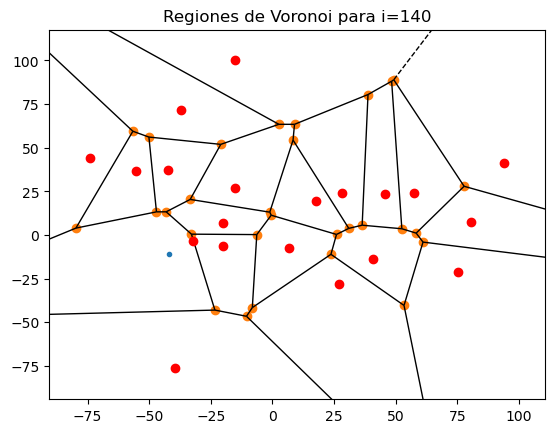

0.0028147907559862716 139


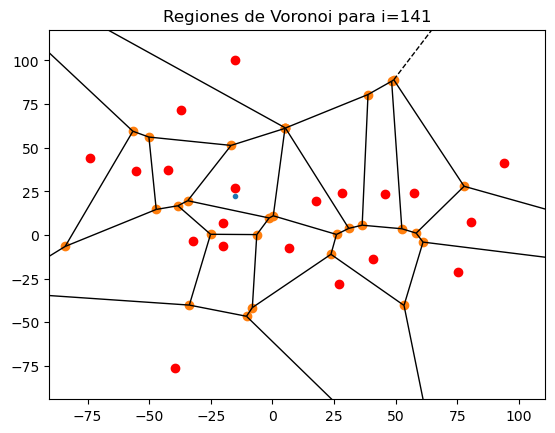

0.005716175519817281 140


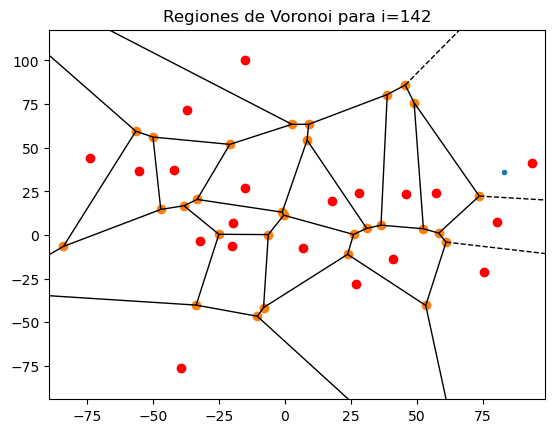

0.0004600699402068815 141


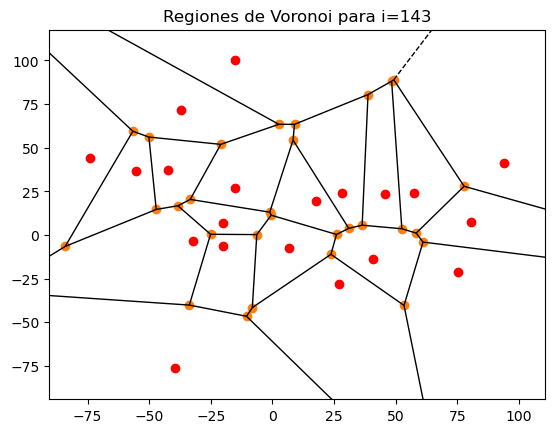

0.016259023217126307 142


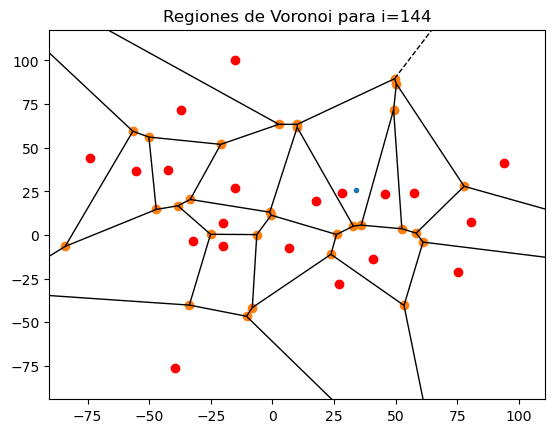

0.0004991462395414175 143


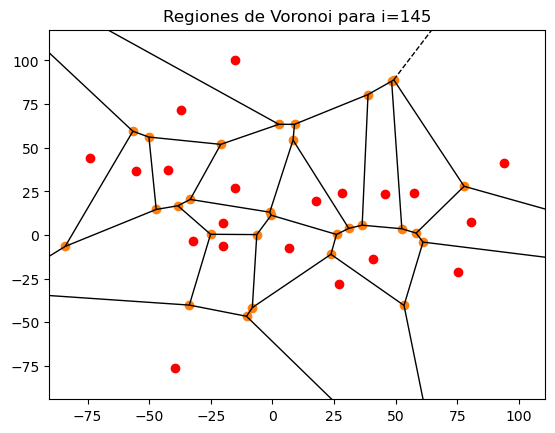

0.016259023217126307 144


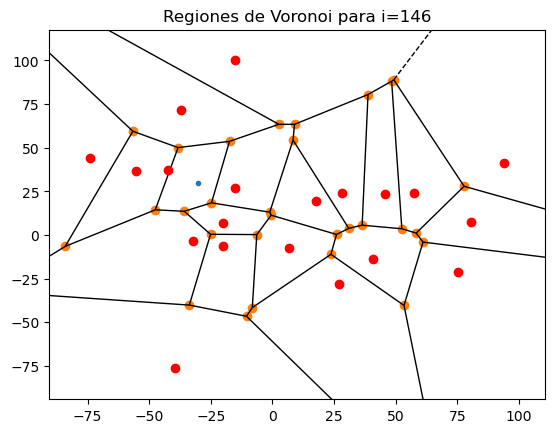

0.018776745527182417 145


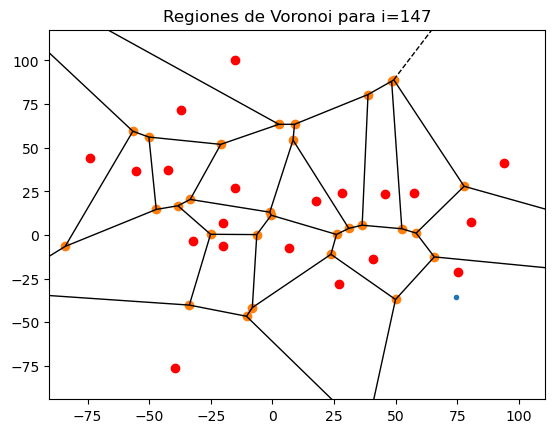

0.461539364704109 146


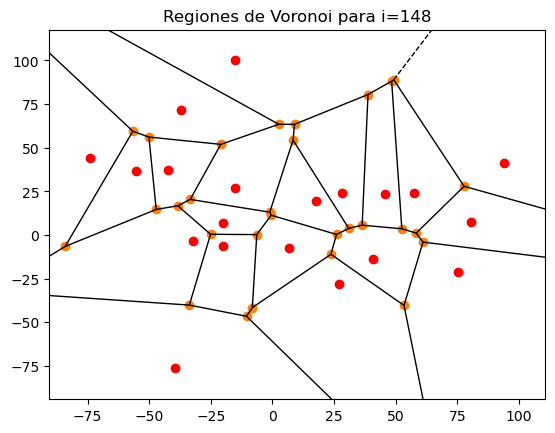

0.016259023217126307 147


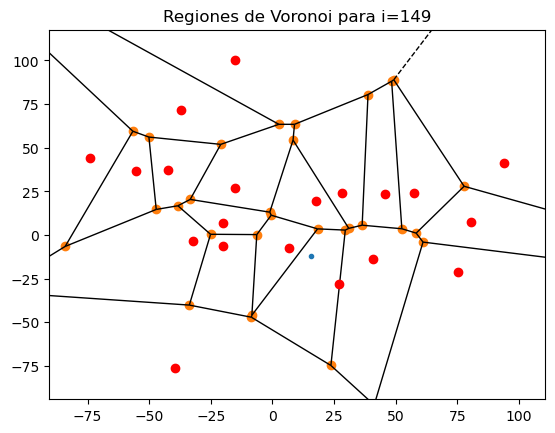

0.2410722436757573 148


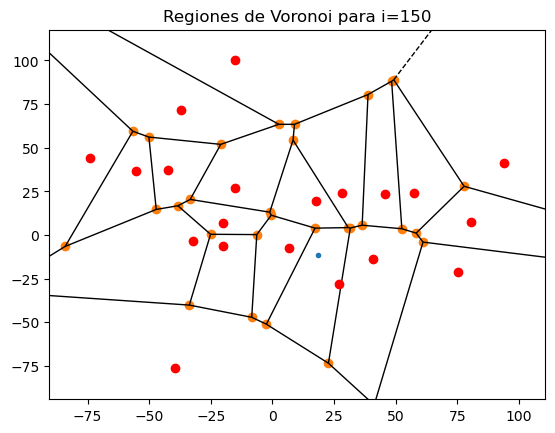

0.24114570929070273 149


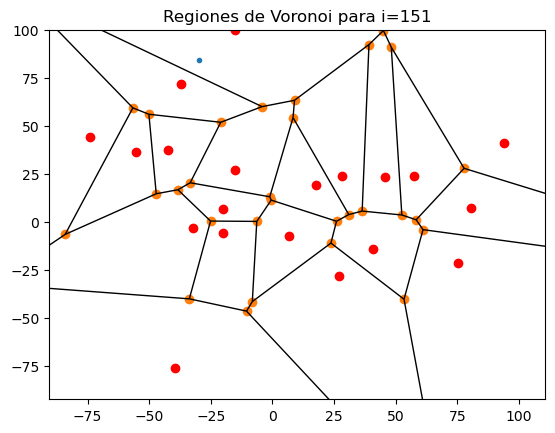

0.0009656494583901439 150


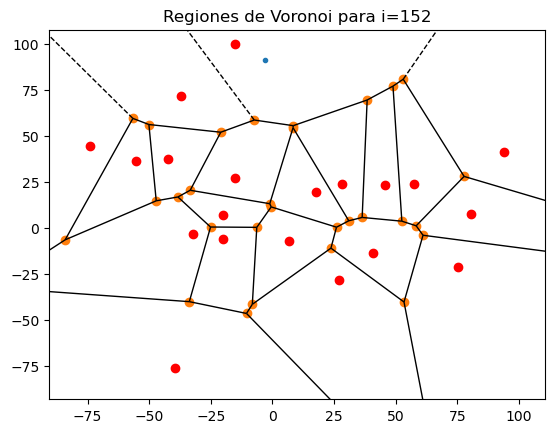

0.00996350626879697 151


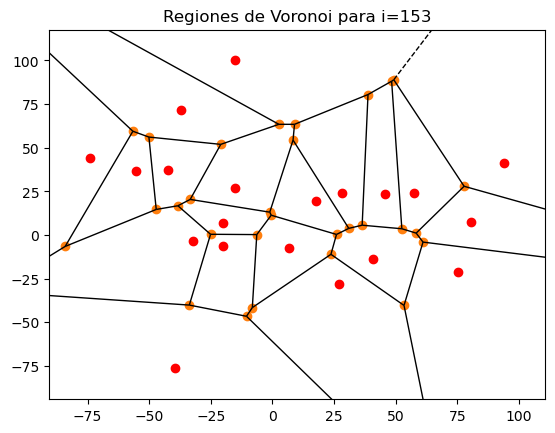

0.016259023217126307 152


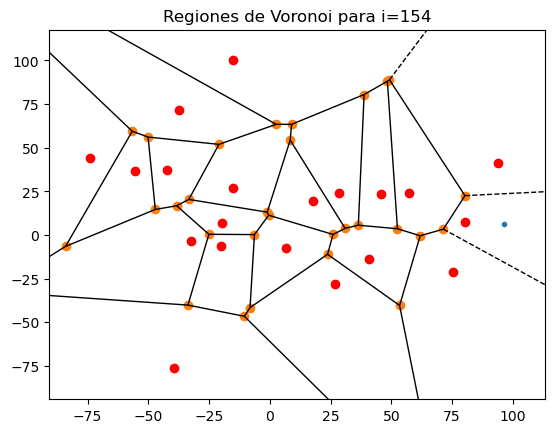

0.0003852815001288912 153


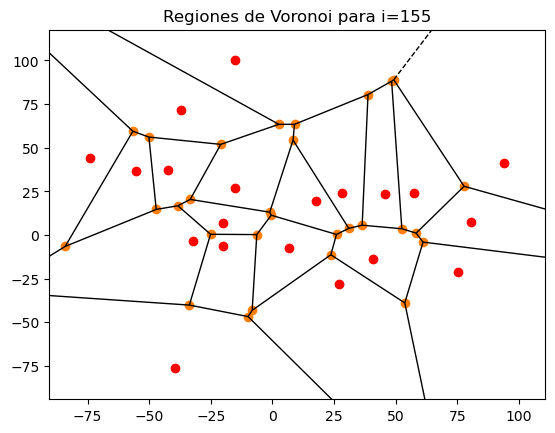

0.016258465032378943 154


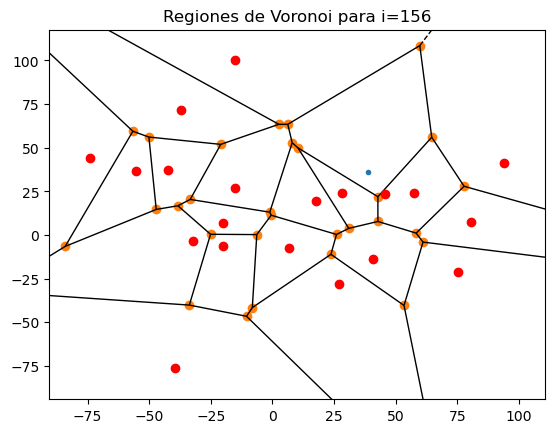

0.0005799330477326199 155


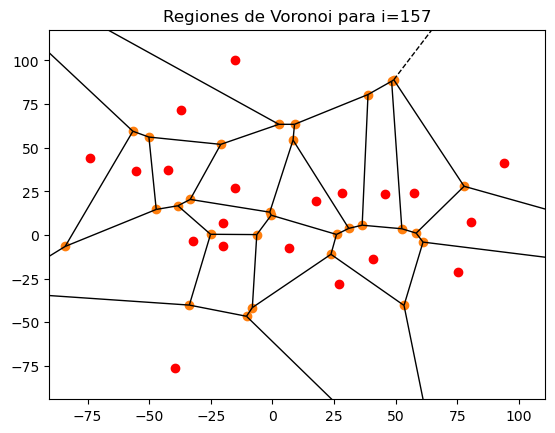

0.016259023217126307 156


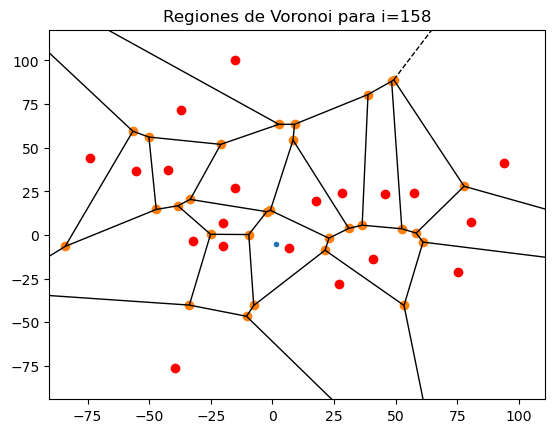

1 157
5297.929015547622 51


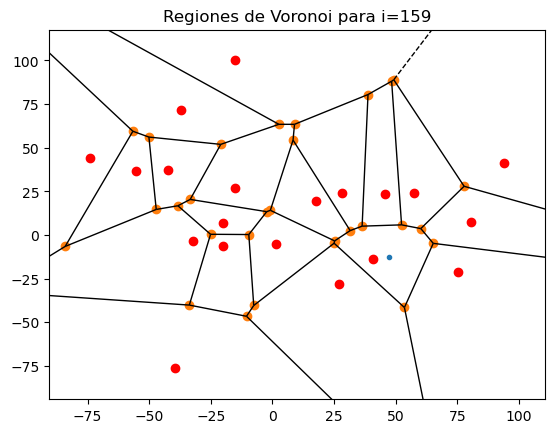

0.00908007853187847 158


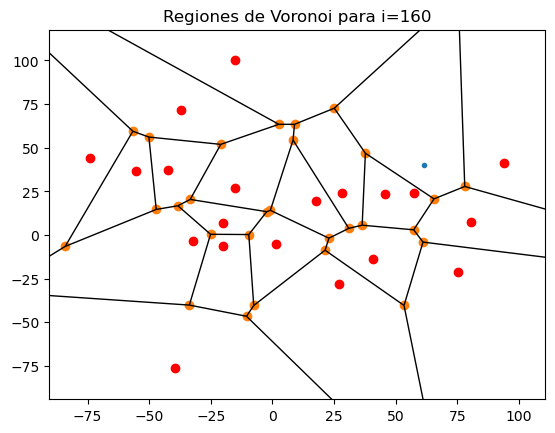

7.041681888223948e-05 159


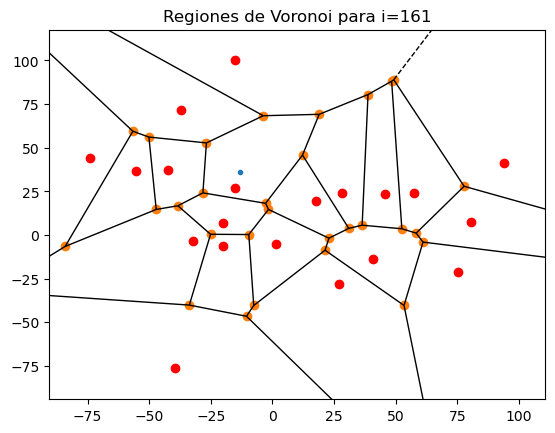

0.00011136774008615366 160


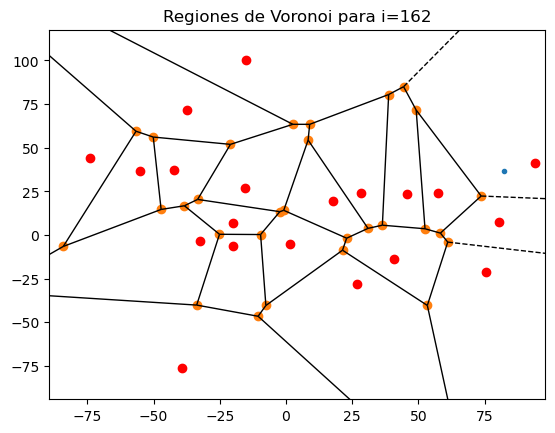

9.333688778541228e-05 161


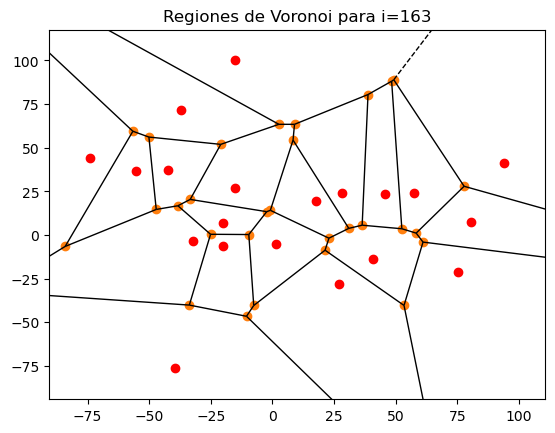

0.009081041538289486 162


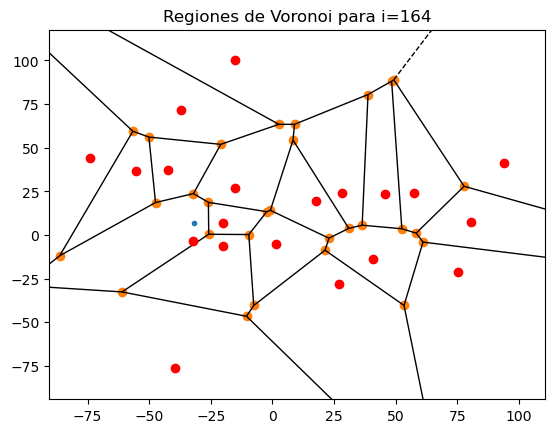

0.5788279124907714 163
3066.589192593717 52


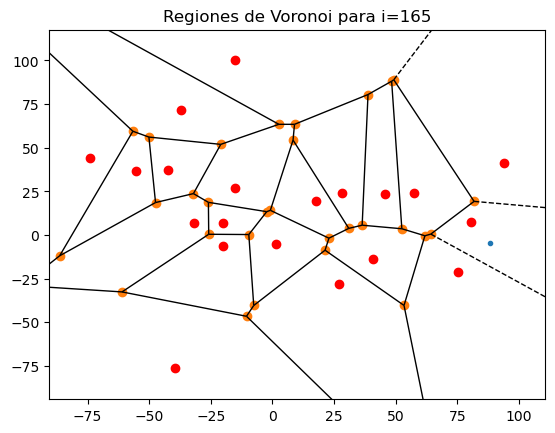

0.398099671205682 164


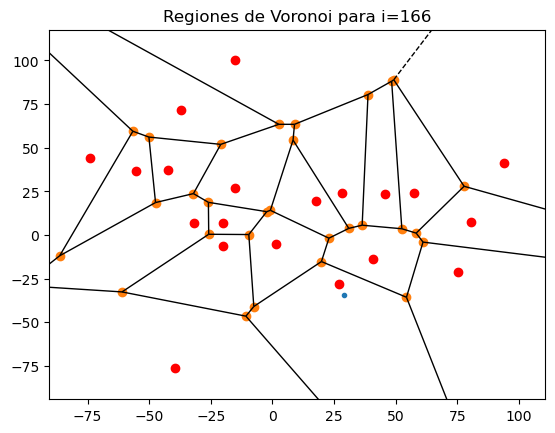

0.021631778754417356 165


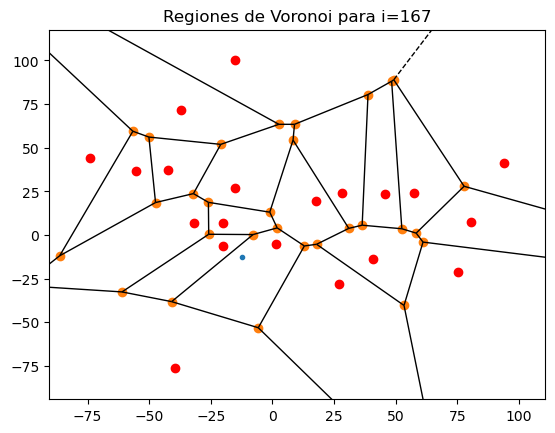

0.0002382170115289572 166


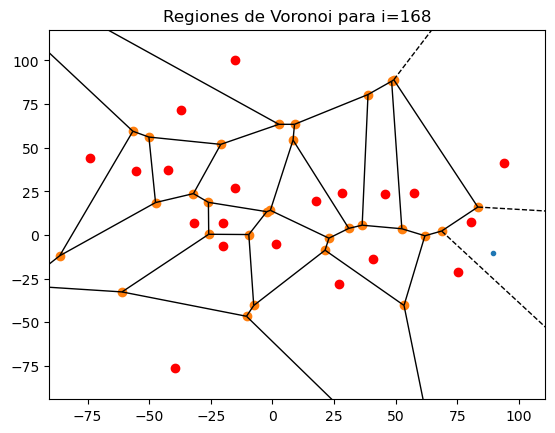

0.39809954077034315 167
1220.807749302856 53


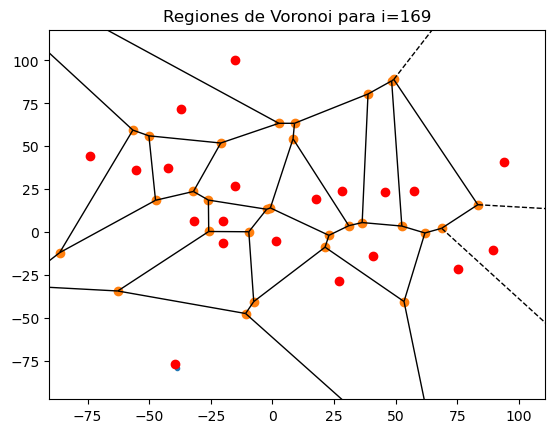

0.04096219468777039 168


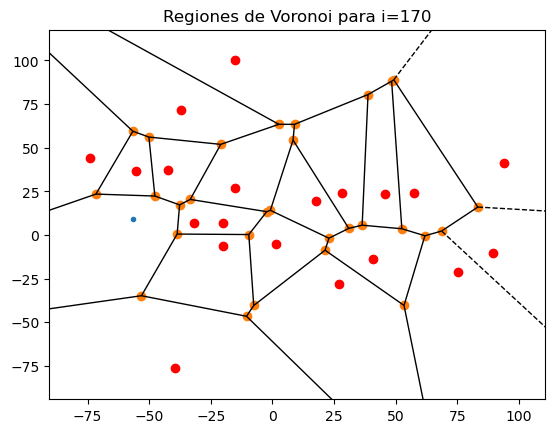

0.7602421972264807 169
928.1095657211179 54


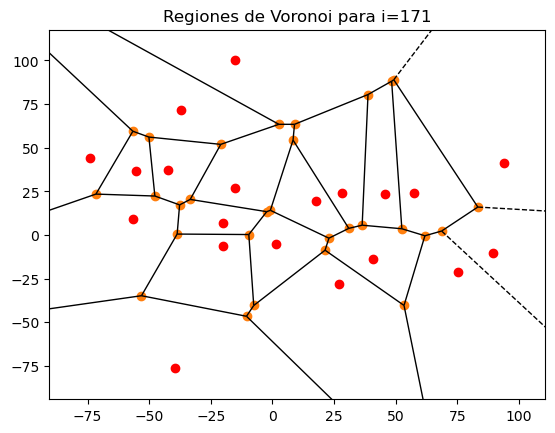

0.05198809533894138 170


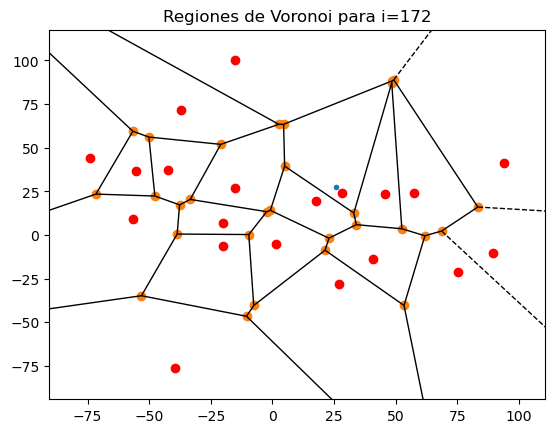

0.0006810583572397444 171


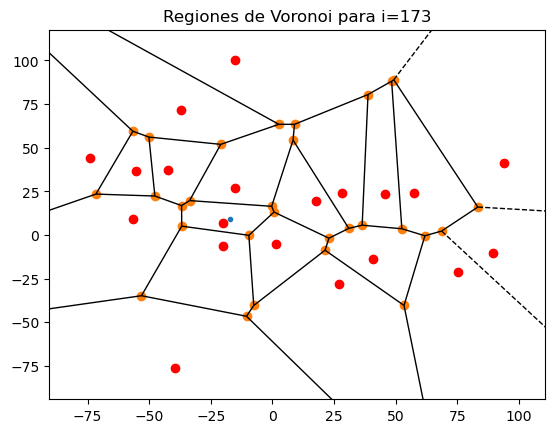

0.1916323970418481 172
177.85586079660646 55


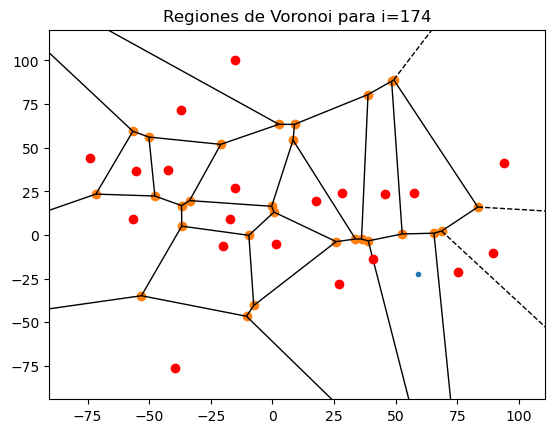

0.00665369165559989 173


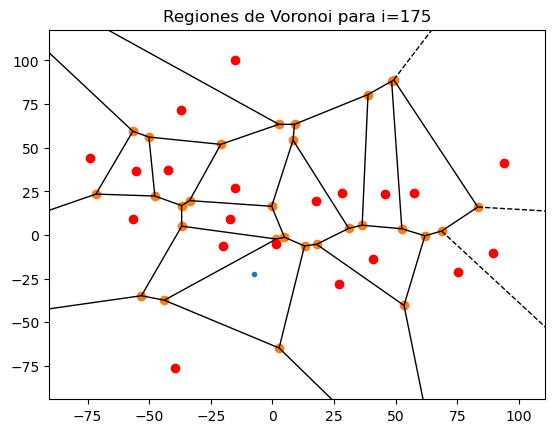

0.030655299699891725 174


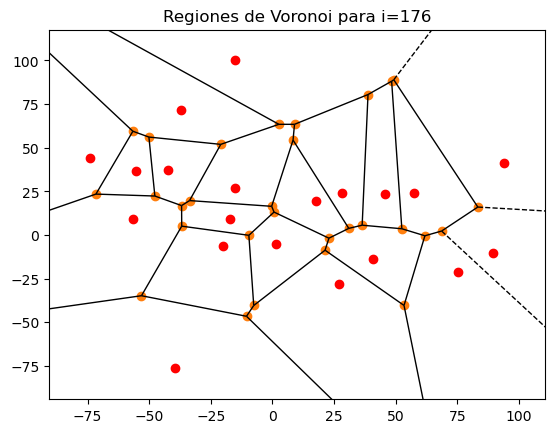

0.2744191122189614 175
48.807047422743935 56


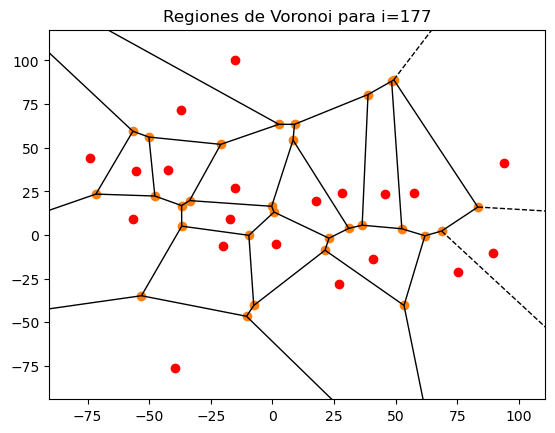

1 176
48.807047422743935 57


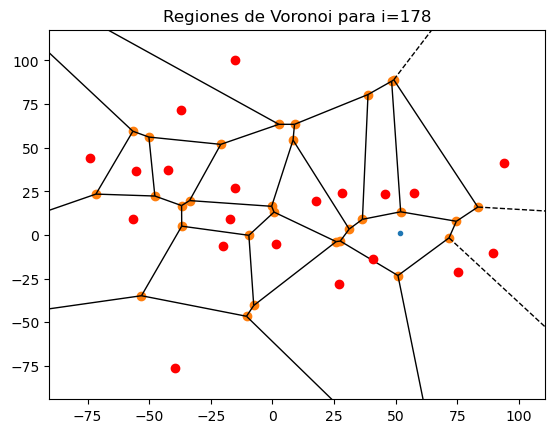

1 177
966.9376798200224 58


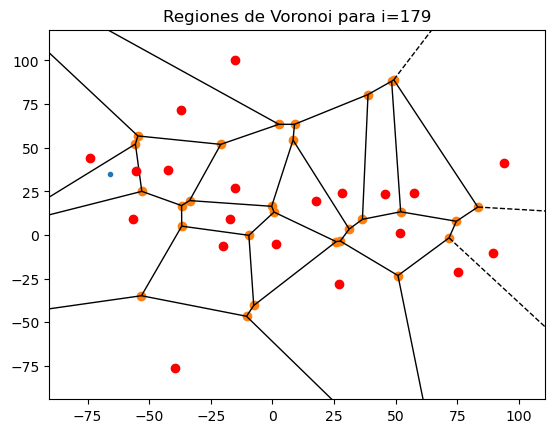

0.0515608847774681 178


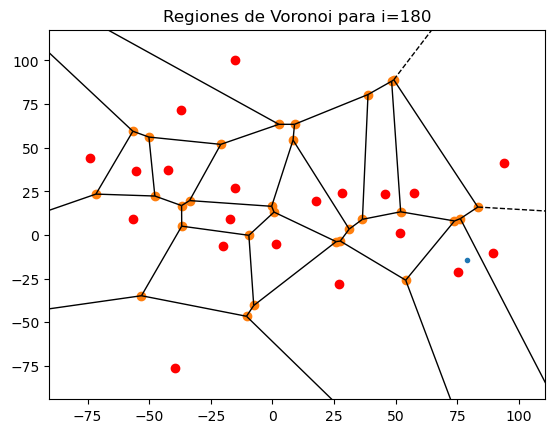

0.05001528024448984 179


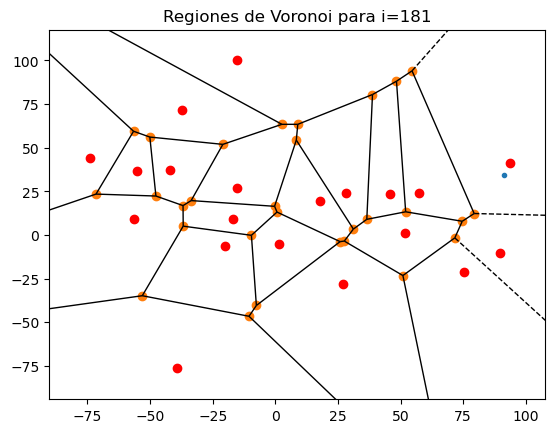

0.0013996556925220014 180


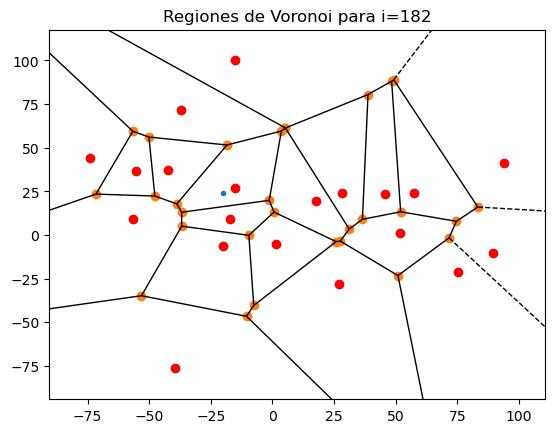

0.001815816677625312 181


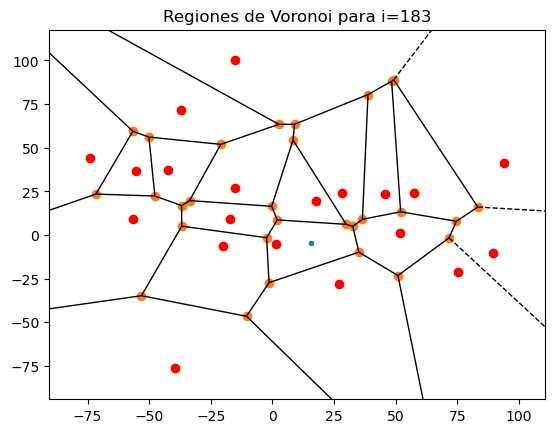

0.13271939466123084 182
128.3313835408484 59


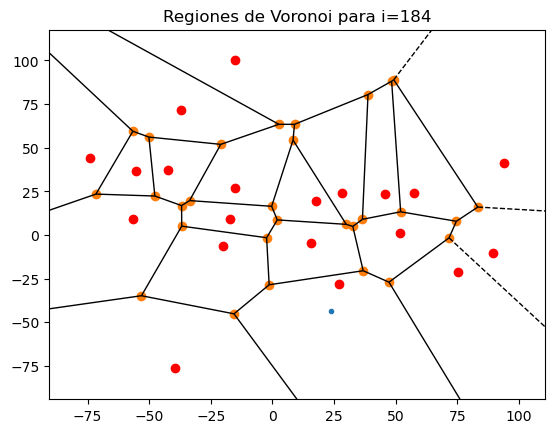

0.5558129718051319 183


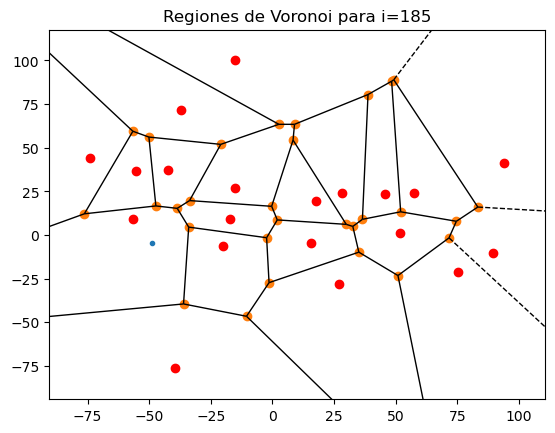

1 184
517.4969657563627 60


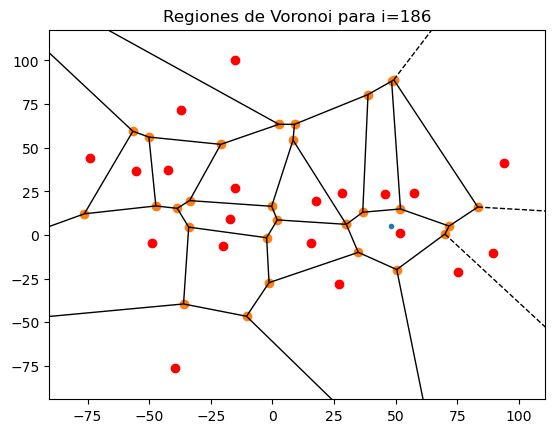

1 185
1041.7847423650448 61


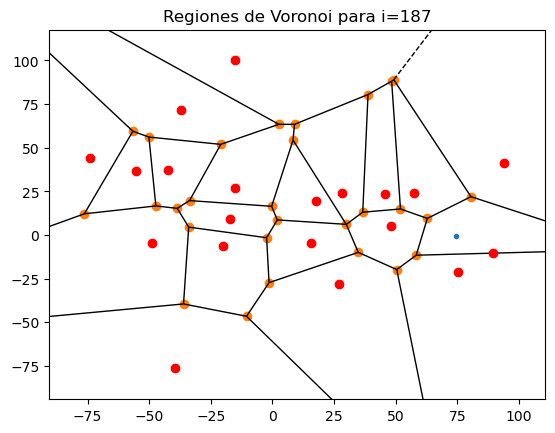

0.049945578012506625 186


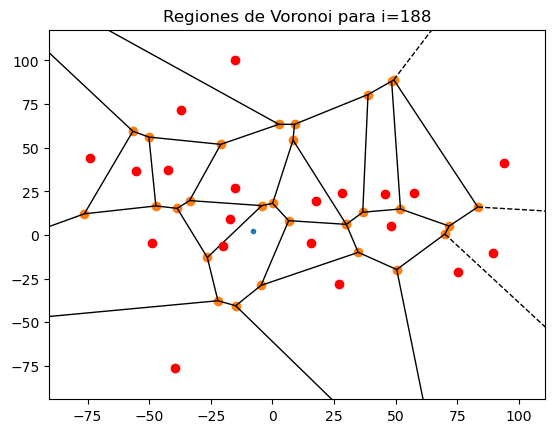

1 187
1205.7478667450234 62


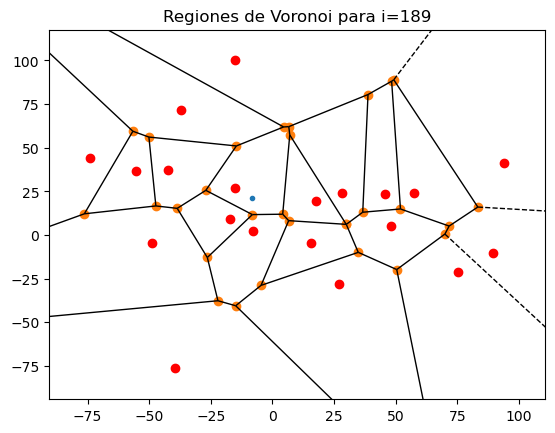

0.007520345132674526 188


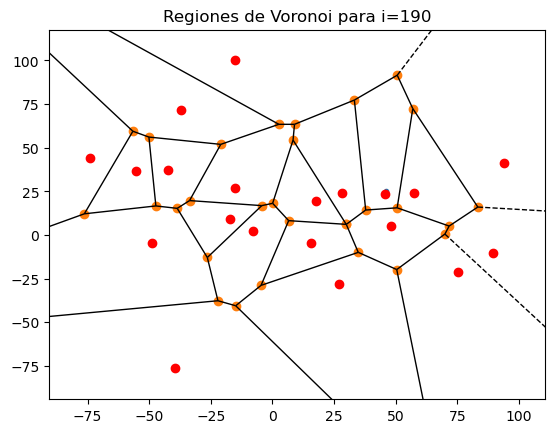

0.0008233096793645882 189


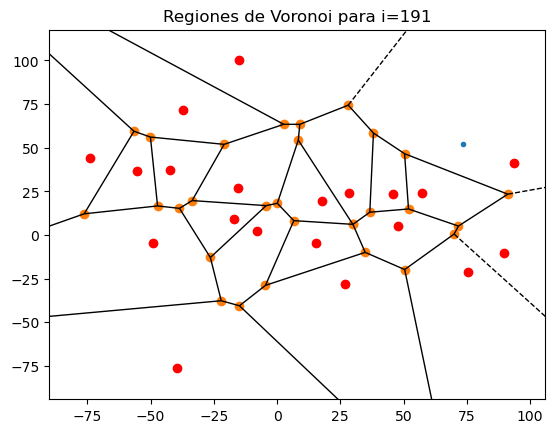

0.004281422517450481 190


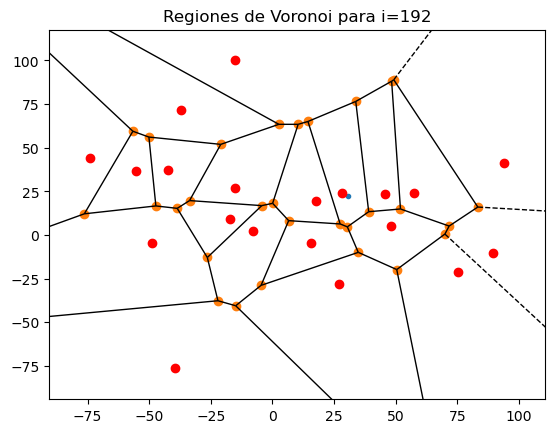

0.0038848747092722065 191


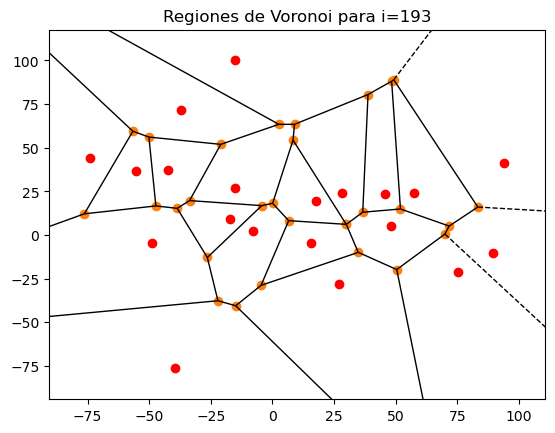

0.041840042492169494 192


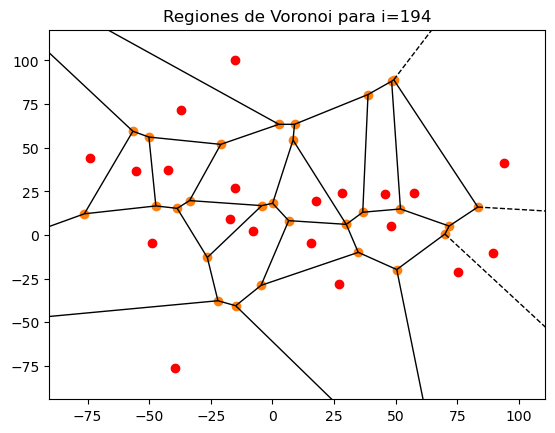

0.041840042492169494 193


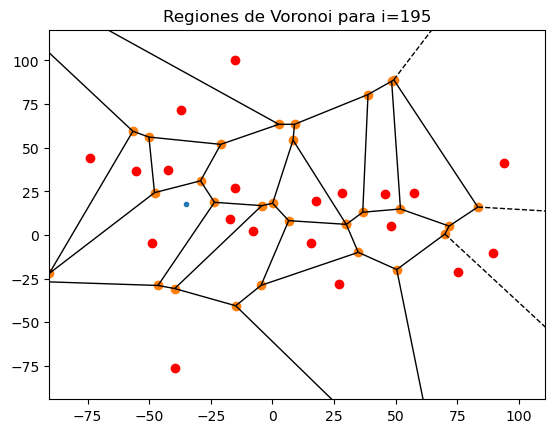

0.3759191321895976 194


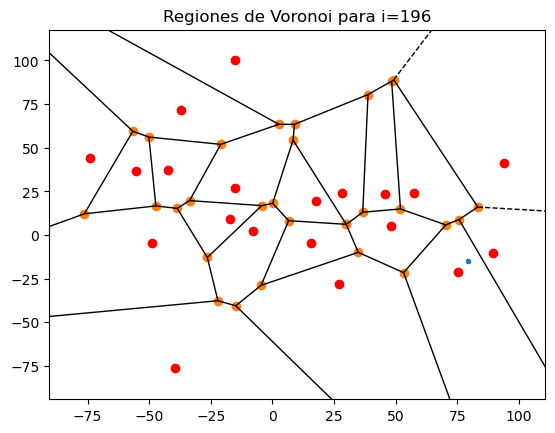

0.005736617525903052 195


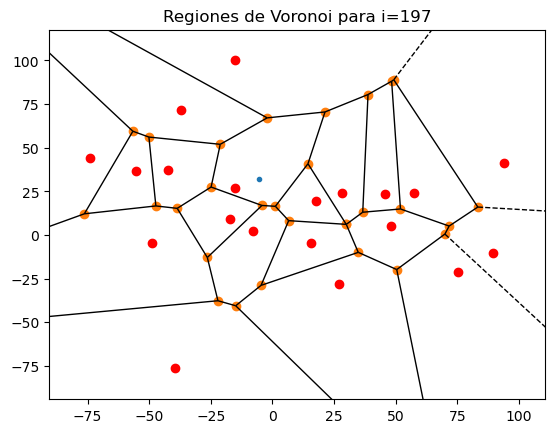

0.00359738212583489 196


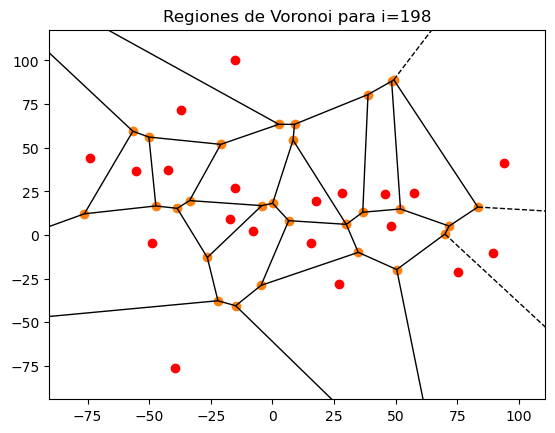

0.041840042492169494 197


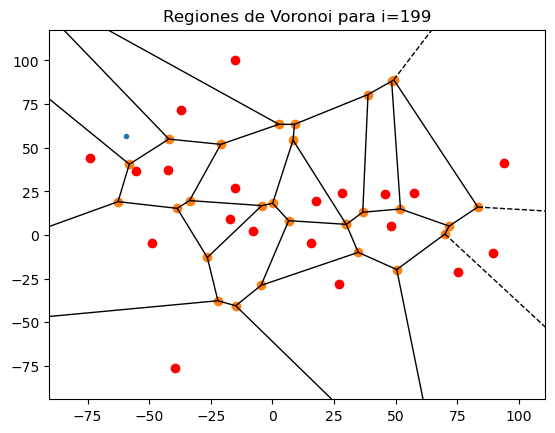

0.007280063236919102 198


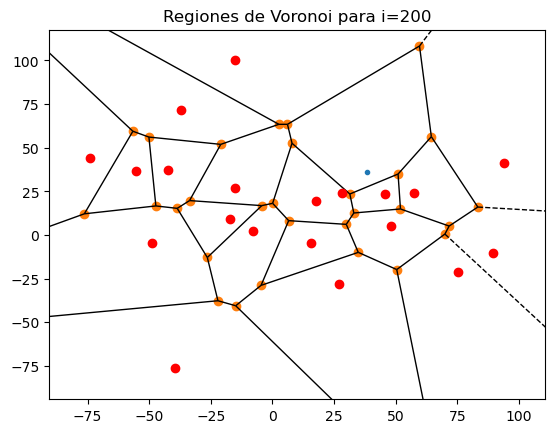

0.006256224058023694 199


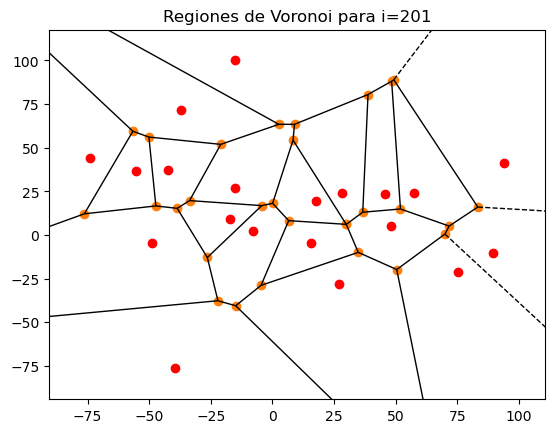

0.041840042492169494 200


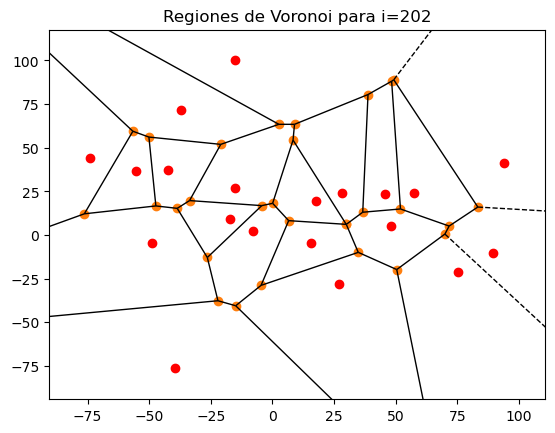

0.041840042492169494 201


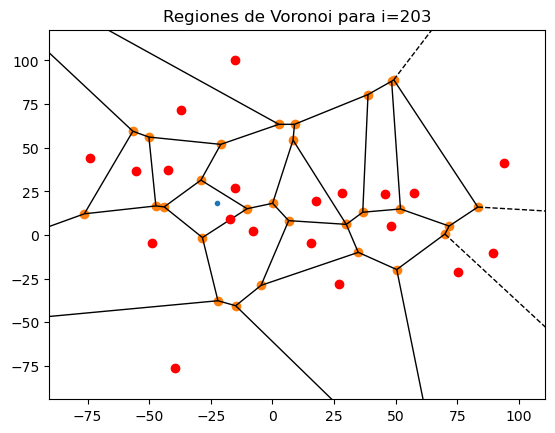

0.37593723585367556 202
453.28552016059007 63


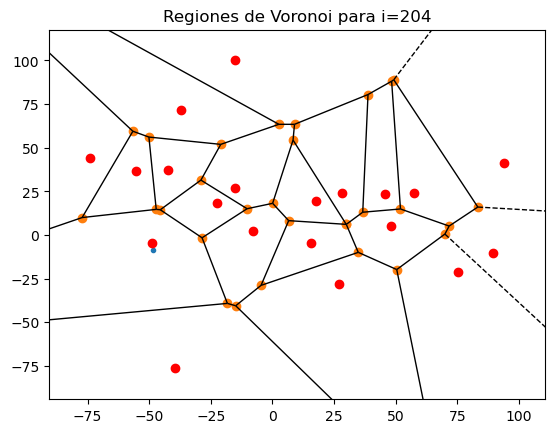

0.20136933447652447 203


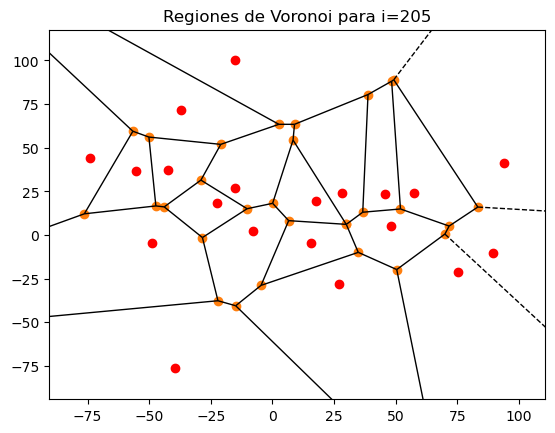

0.11889206233836785 204
53.89205032001237 64


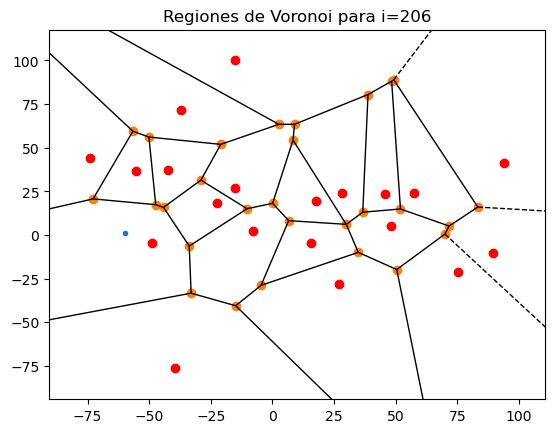

0.9361686445016602 205
50.45204769750124 65


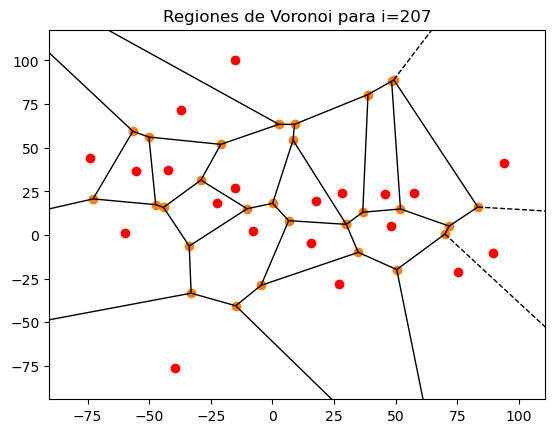

1 206
50.464988268906296 66


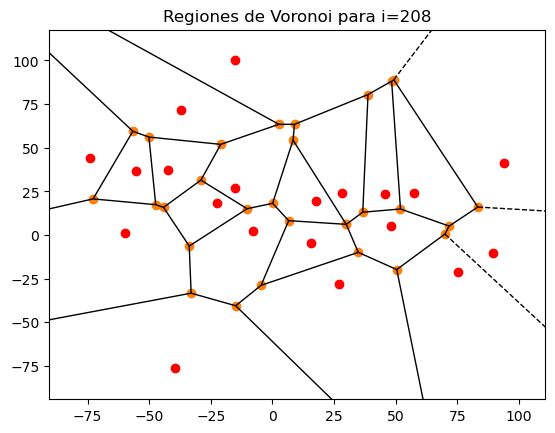

1 207
50.464988268906296 67


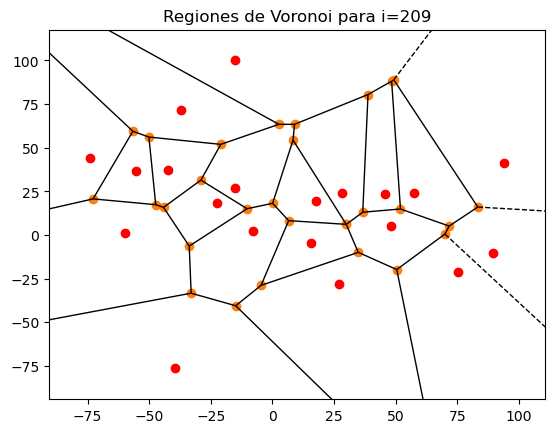

1 208
50.464988268906296 68


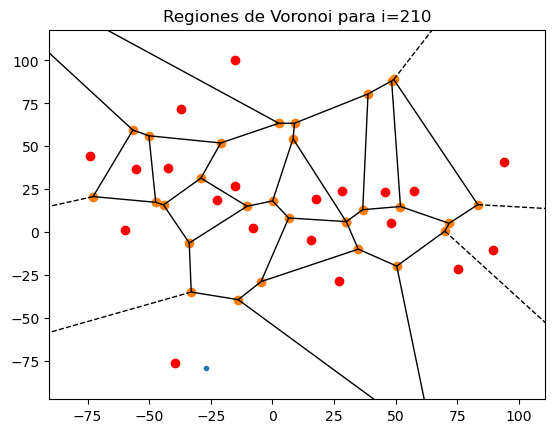

0.05079917939686966 209


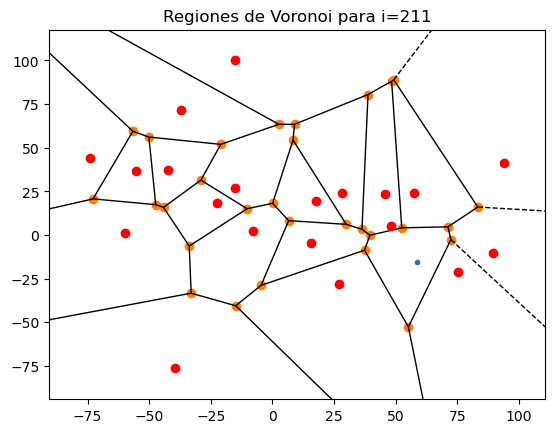

0.10712301490060316 210
5.405961690288813 69


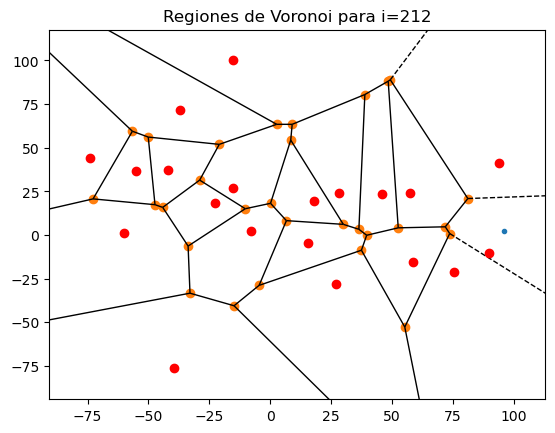

1 211
8.811199328473954 70


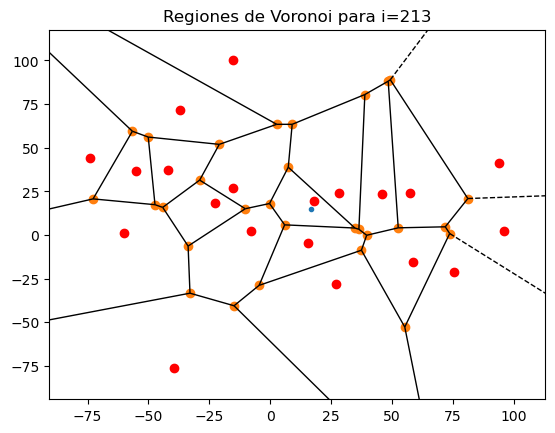

0.4965101949271314 212
4.374850296122412 71


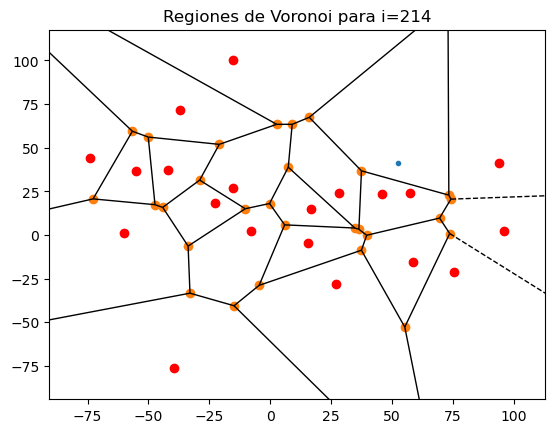

1 213
6.509330727118934 72


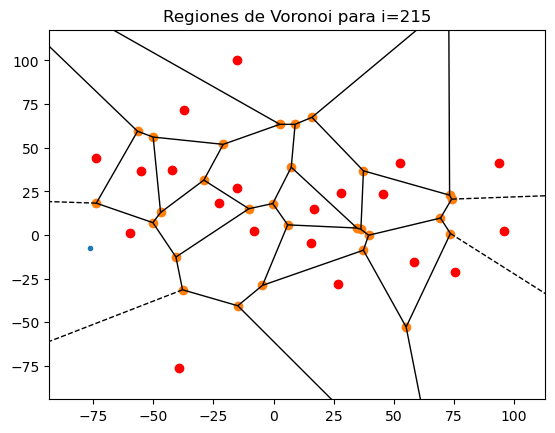

1 214
14.137258818266881 73


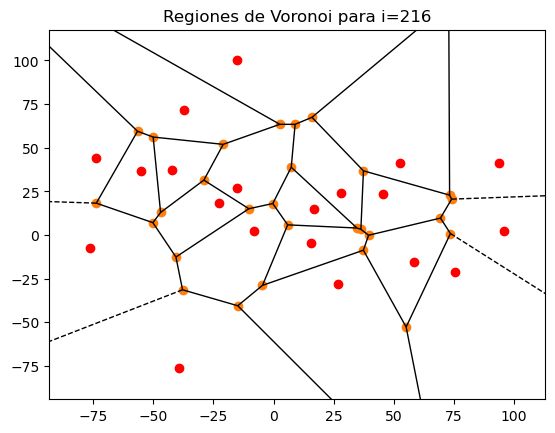

0.2778641628735001 215


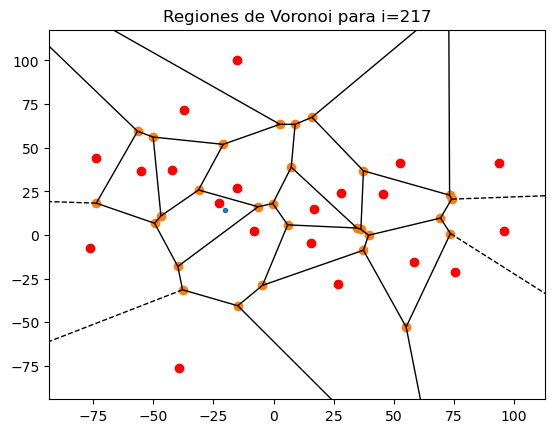

0.2698119379120431 216


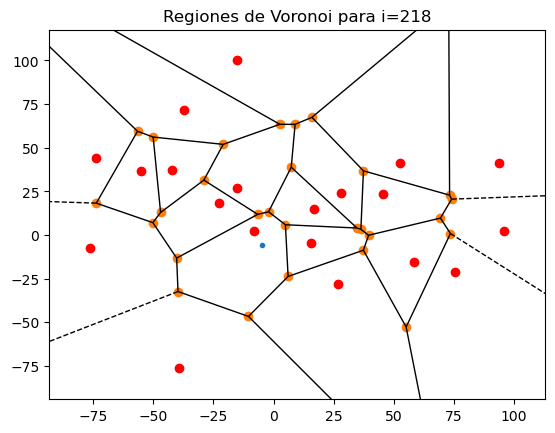

0.05833445556827111 217


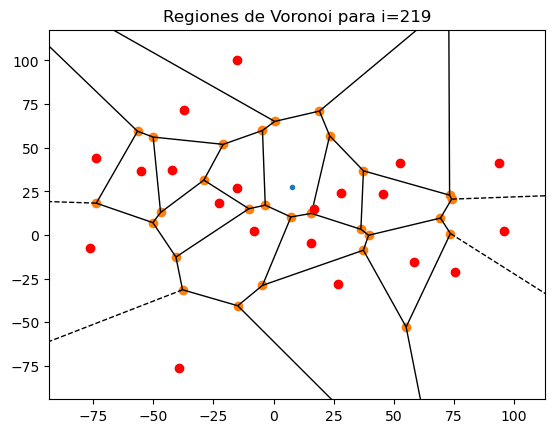

1 218
17.214206591656975 74


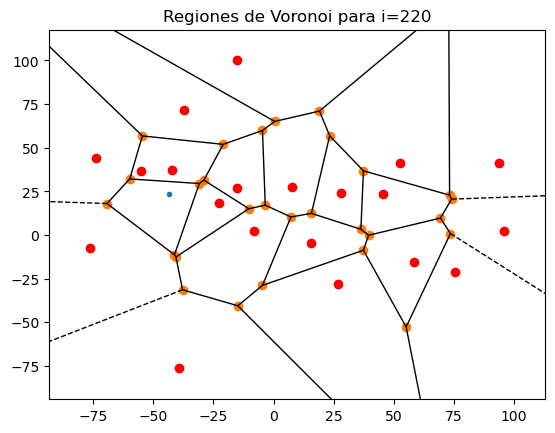

1 219
32.40351406542888 75


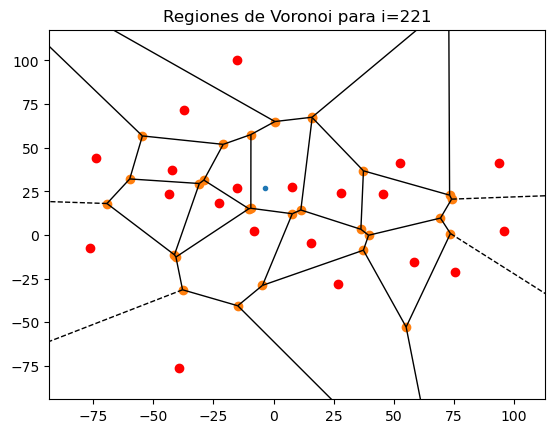

1 220
527.1089139917096 76


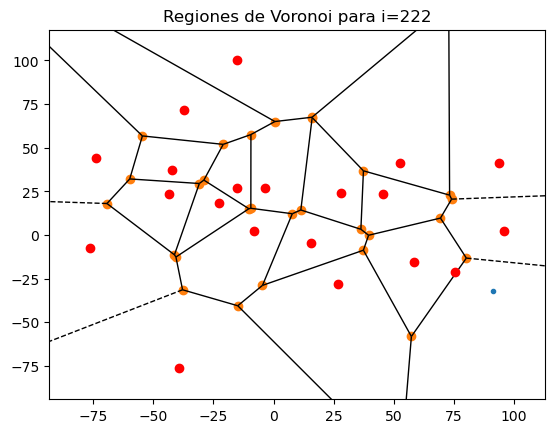

0.19264772400307528 221
101.54633258223562 77


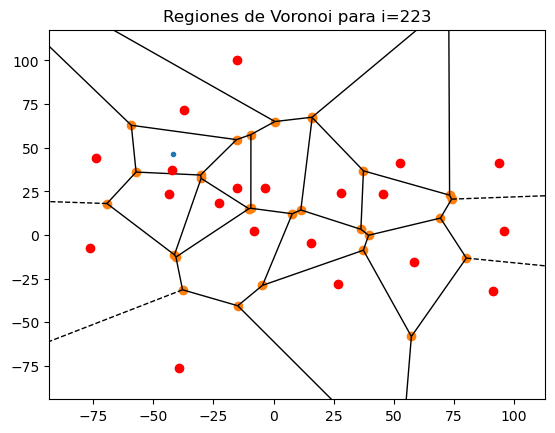

0.24536514523754455 222


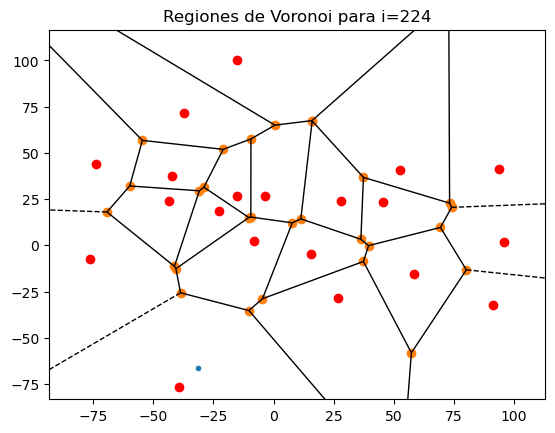

0.6858107627345709 223


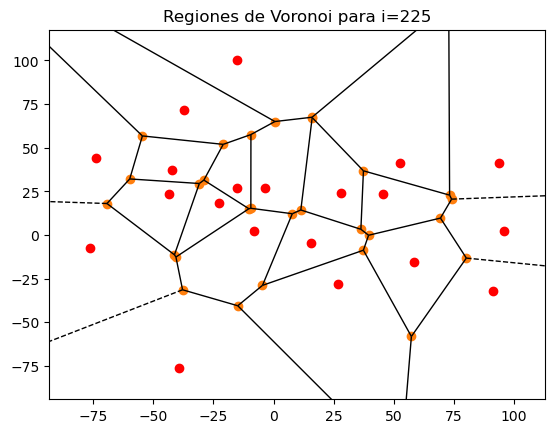

1 224
101.57177630514694 78


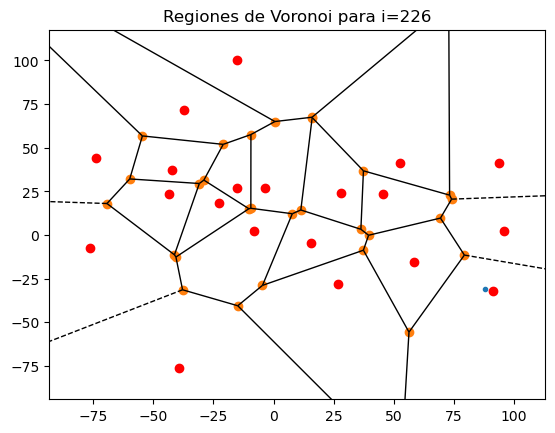

1 225
101.57591622160098 79


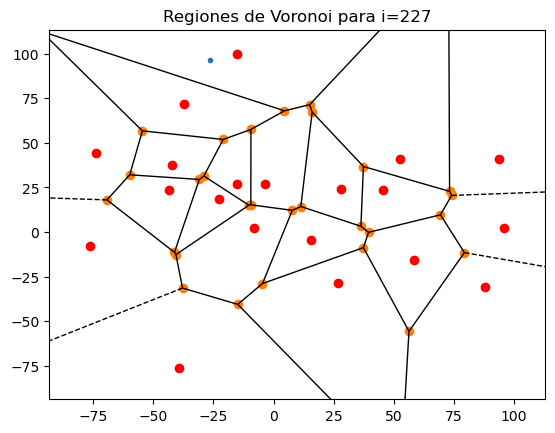

1 226
101.5844205683972 80


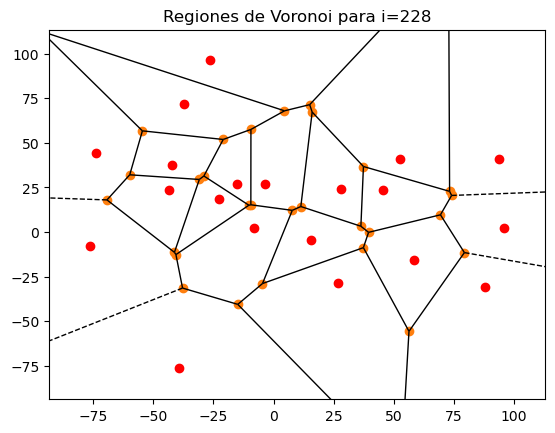

1 227
101.58789296116814 81


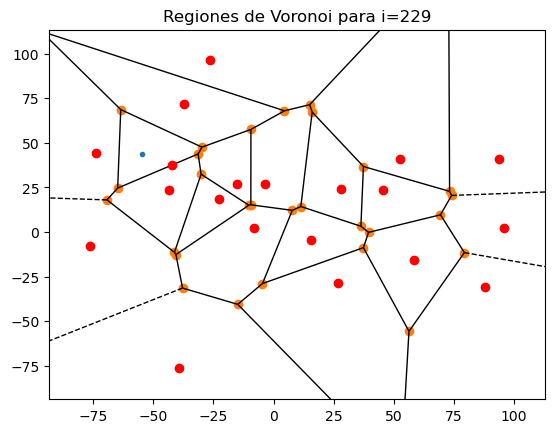

0.06988021906068581 228


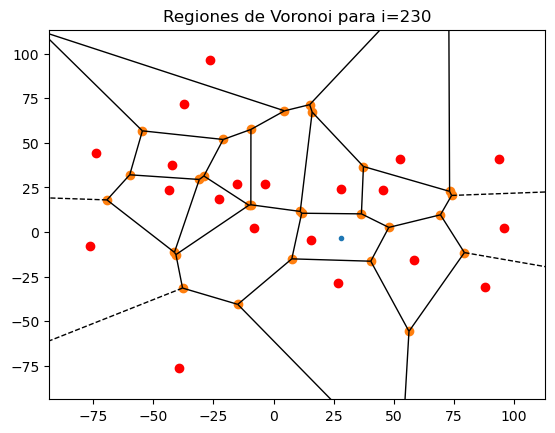

0.11283773586502556 229


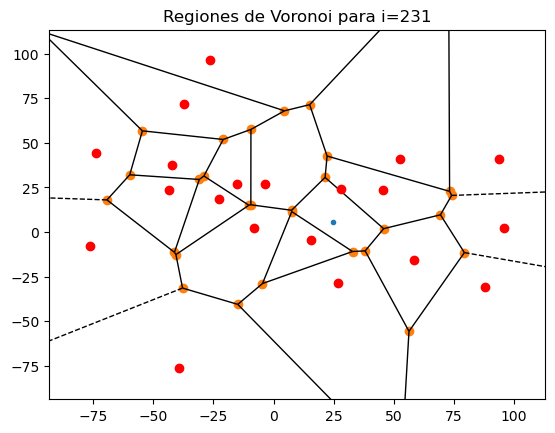

0.13918854934650696 230
14.139871452433217 82


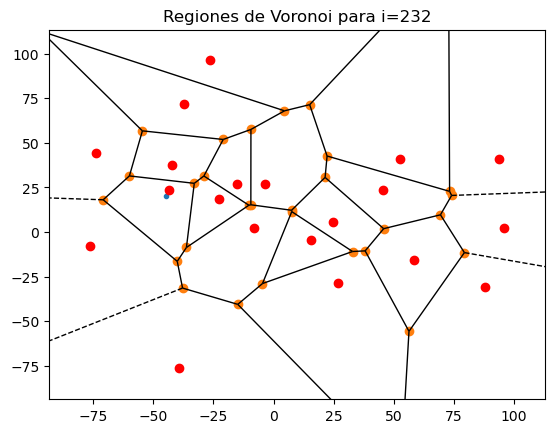

1 231
75.20856371222852 83


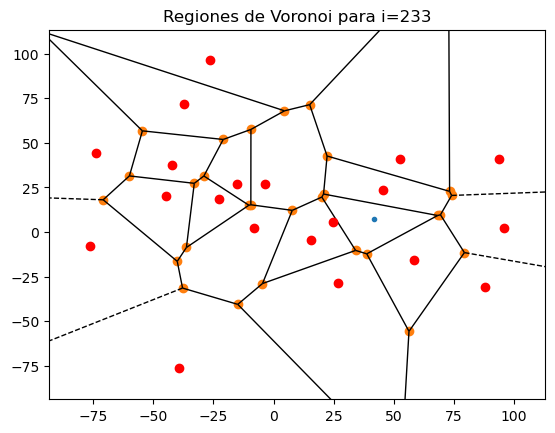

1 232
84.76380816803763 84


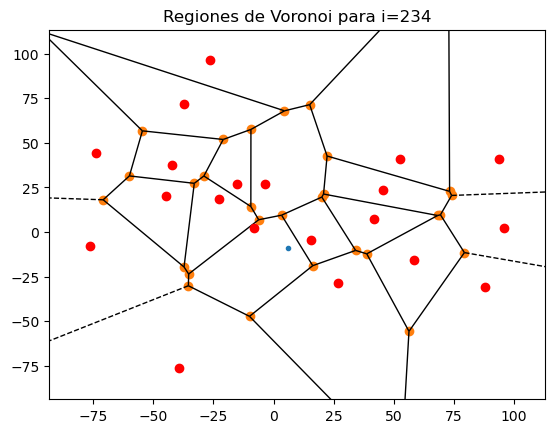

0.04832051006481875 233


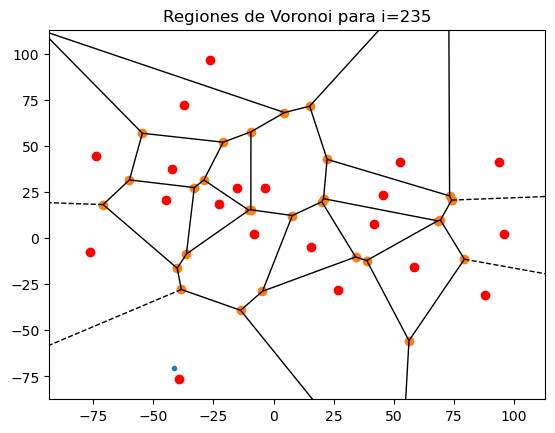

0.9750896788484997 234
82.65231448454765 85


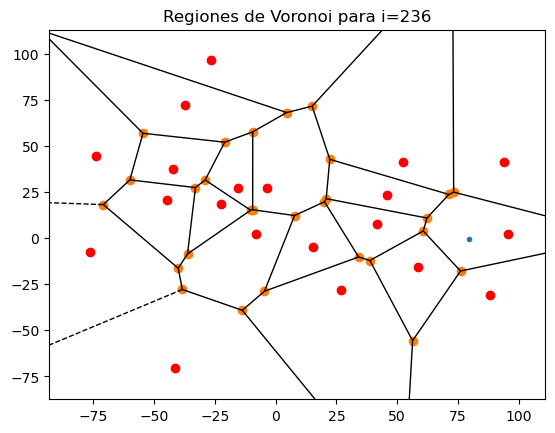

1 235
86.47179698499633 86


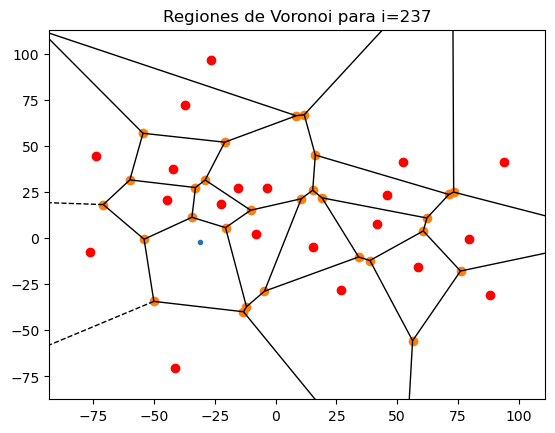

0.009275818908042023 236


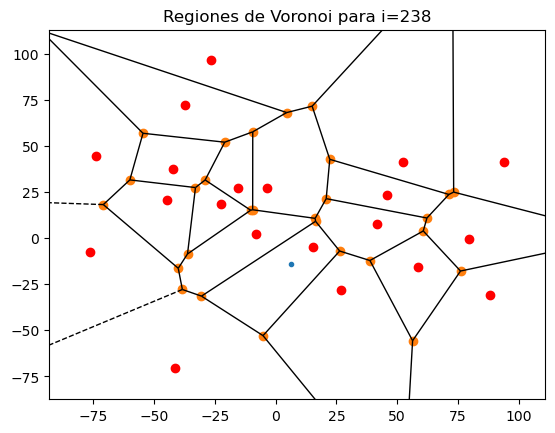

0.9630553751742771 237
83.27712888737956 87


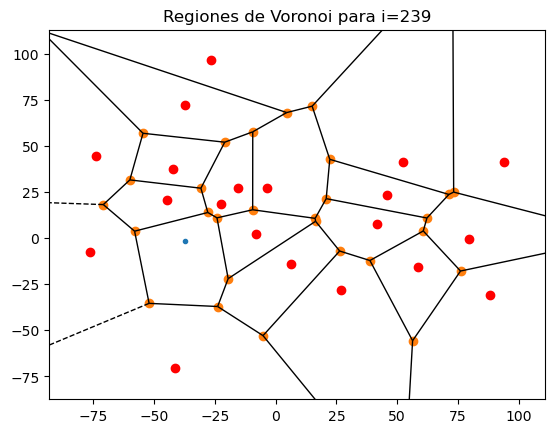

1 238
1103.0911398454214 88


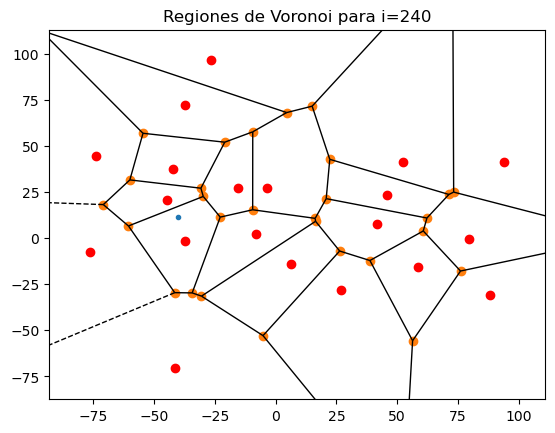

1 239
1158.9565250304886 89


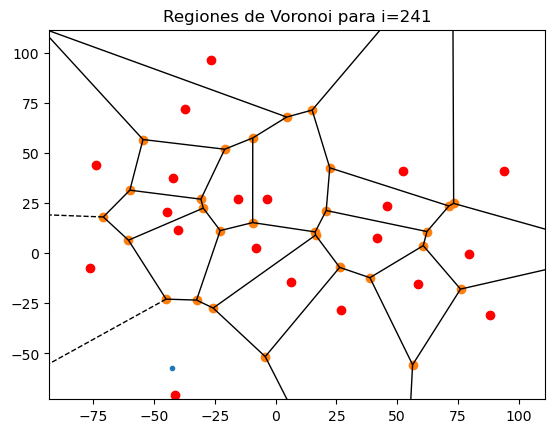

0.9995556363595107 240
1158.4415268898572 90


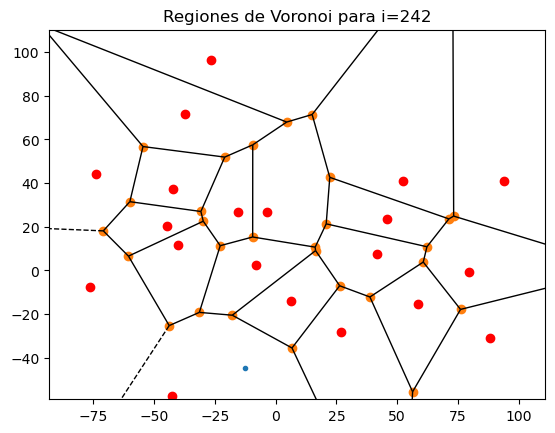

0.0019388328762632166 241


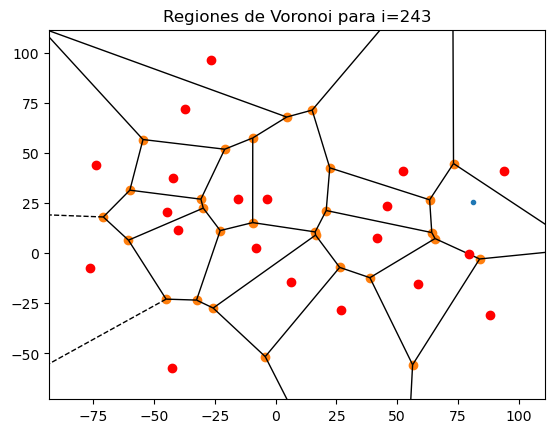

1 242
1158.5504151356586 91


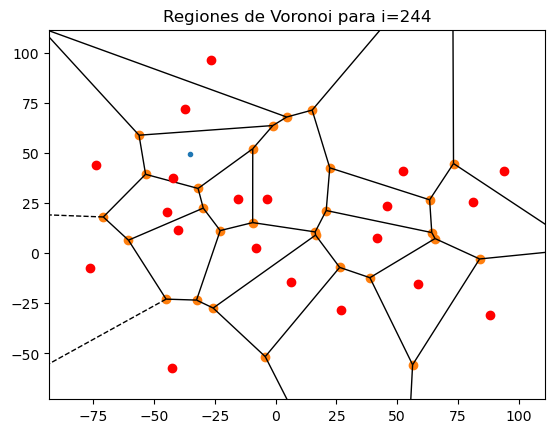

0.012088128246400211 243


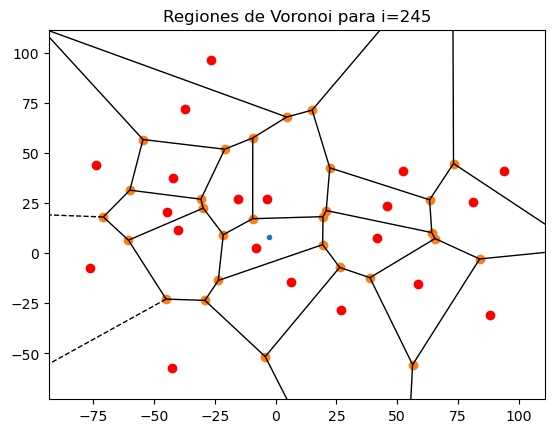

0.15463566685287936 244
179.15321602718276 92


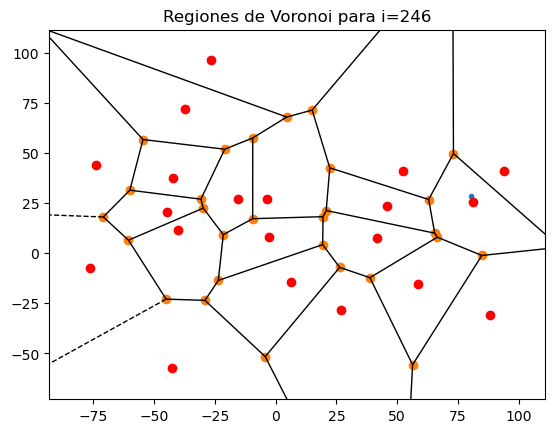

1 245
1123.1924424772146 93


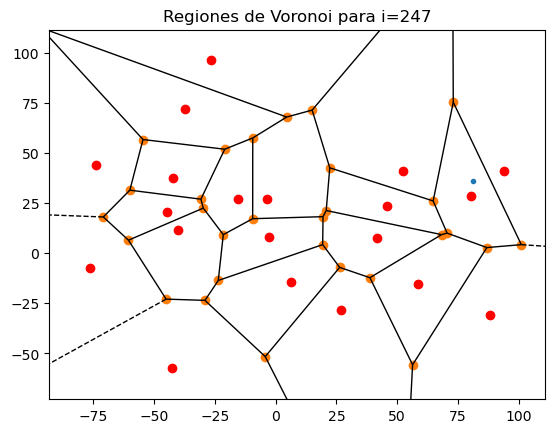

0.00032605199058099695 246


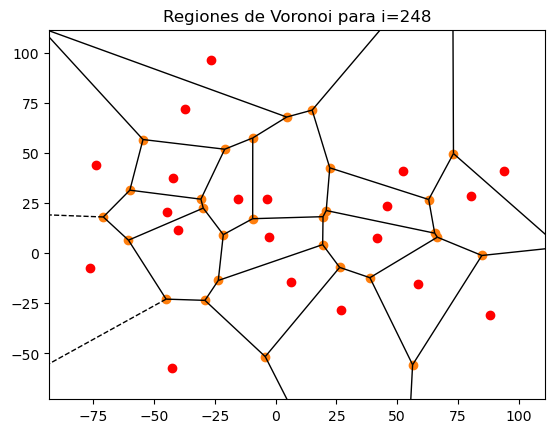

0.9999999237859318 247
1123.1923568741493 94


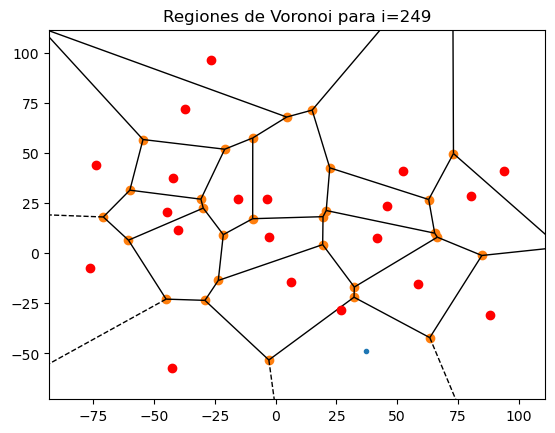

0.04490180028082598 248


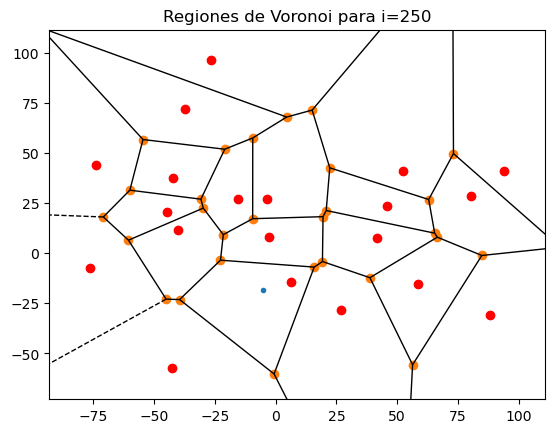

1 249
3789.5098231537318 95


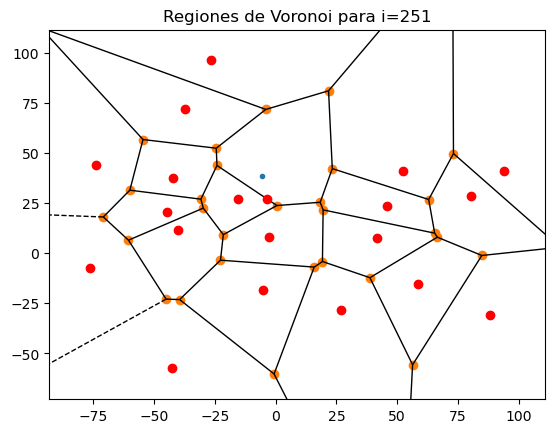

0.0018404224431798988 250


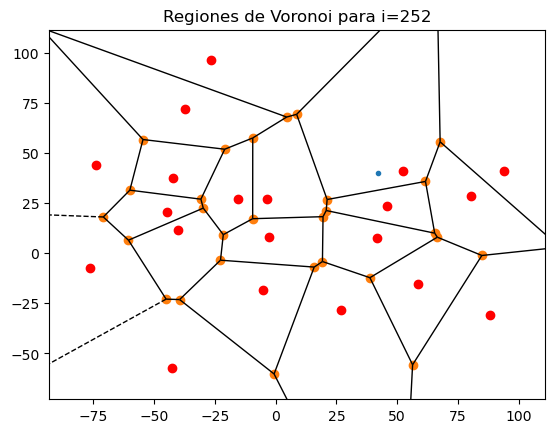

0.007878394436211028 251


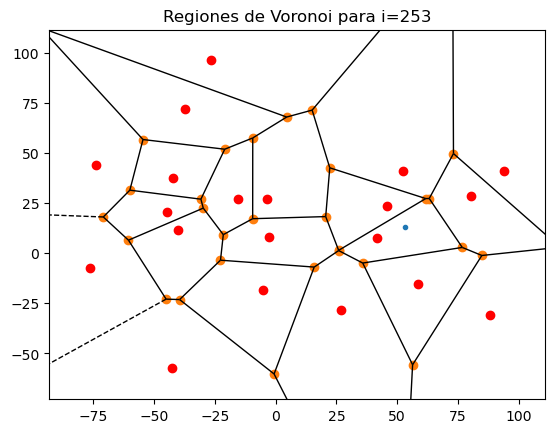

0.29629911012603366 252


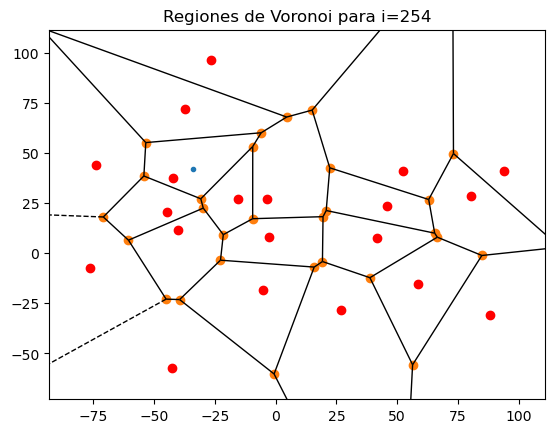

0.0019131051144146095 253


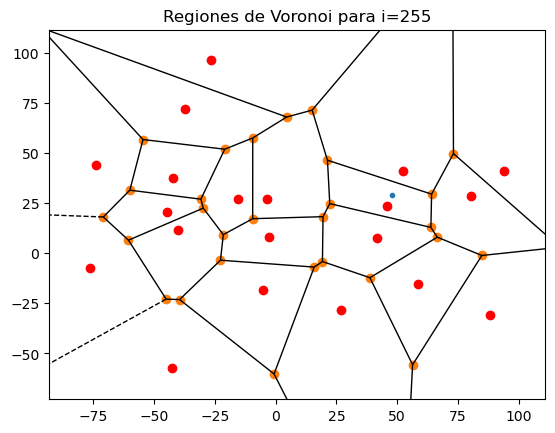

0.2965421327184044 254


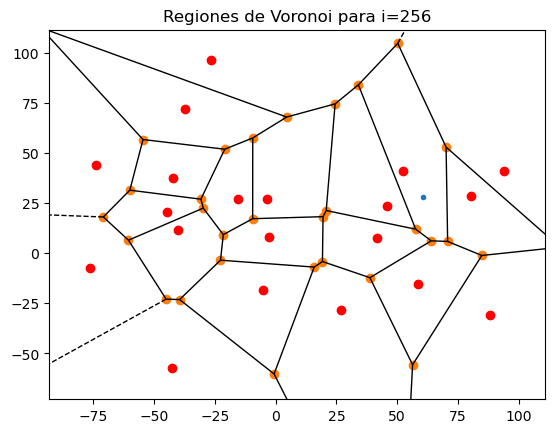

9.874184331728762e-05 255


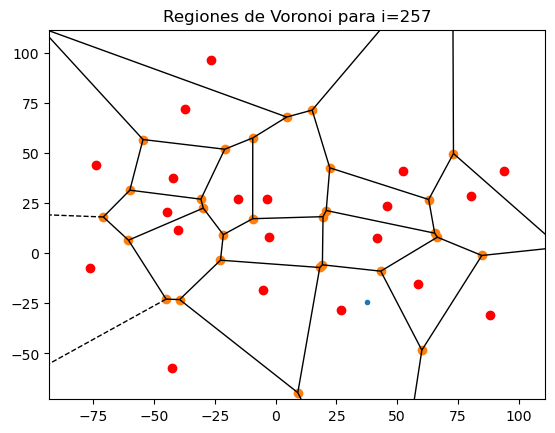

0.2964924230462948 256


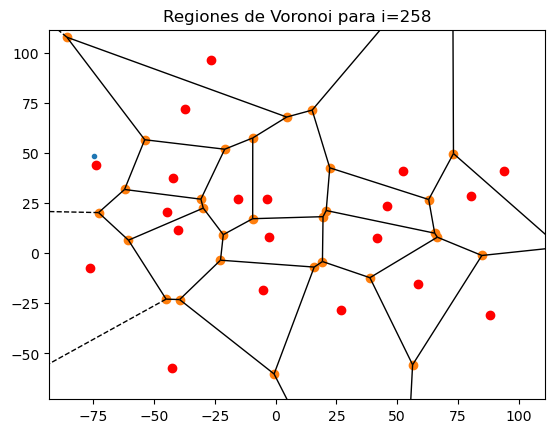

0.40091571323777153 257


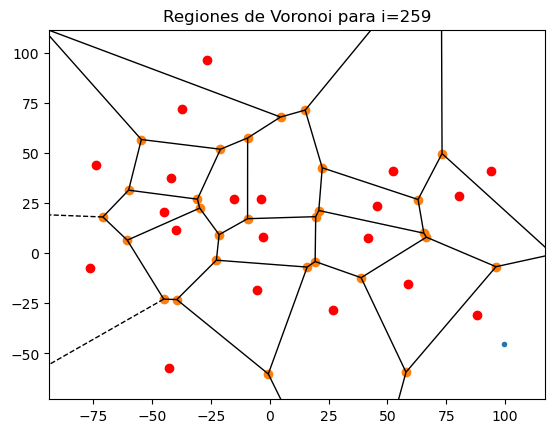

0.00035071764889025735 258


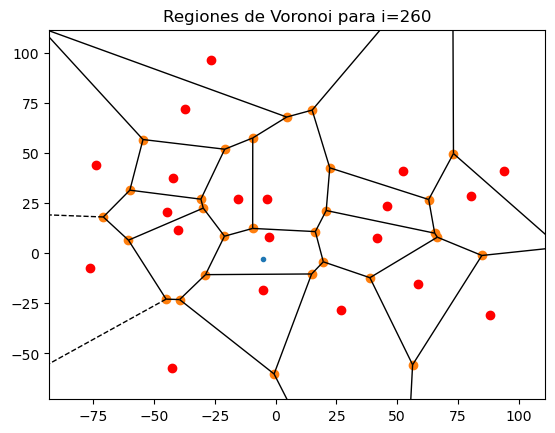

0.022323173255083165 259


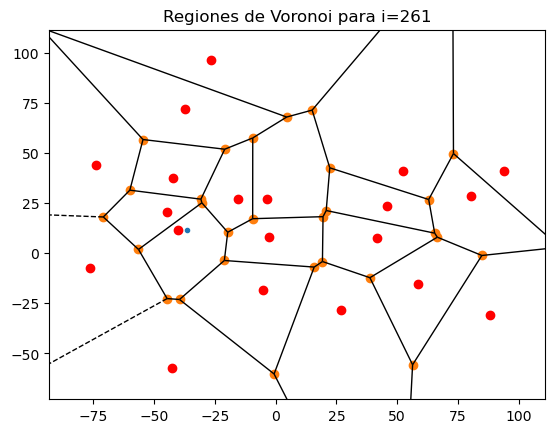

0.4294281901953022 260
1627.3223450842268 96


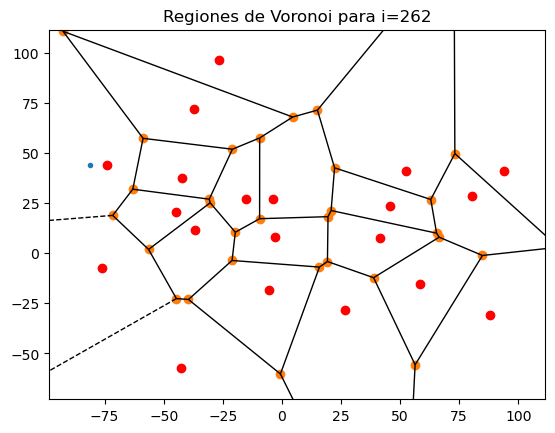

0.0051542580480761465 261


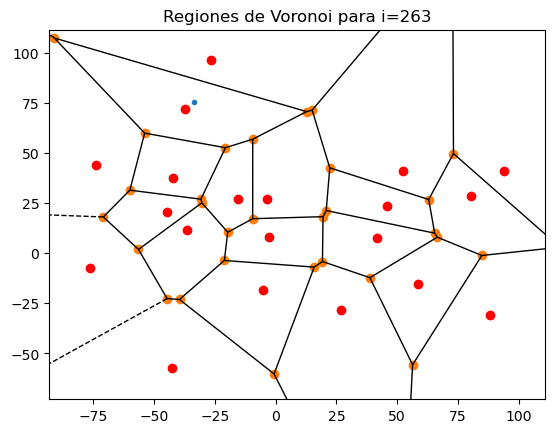

0.3274270147077928 262
532.829297418213 97


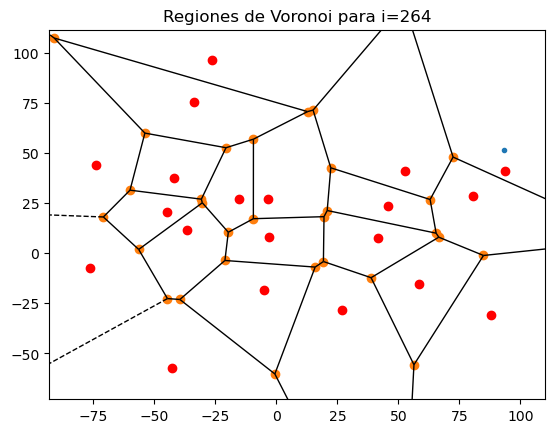

0.013487891368652681 263


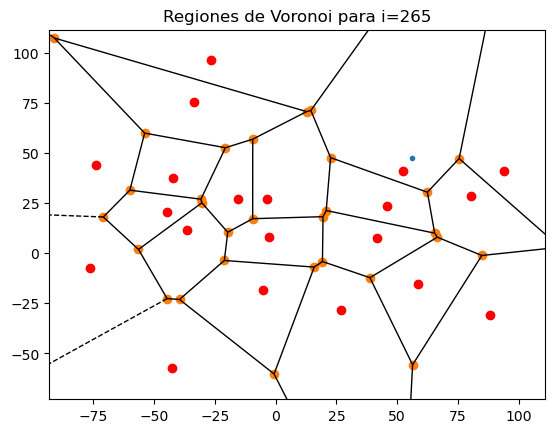

0.9996883642013435 264
532.6632487345645 98


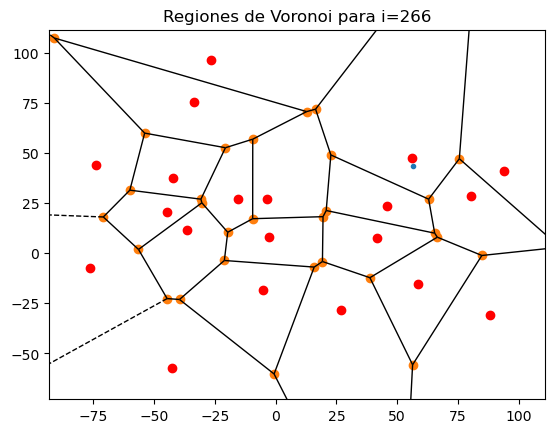

0.9996244278801599 265
532.4631952690763 99


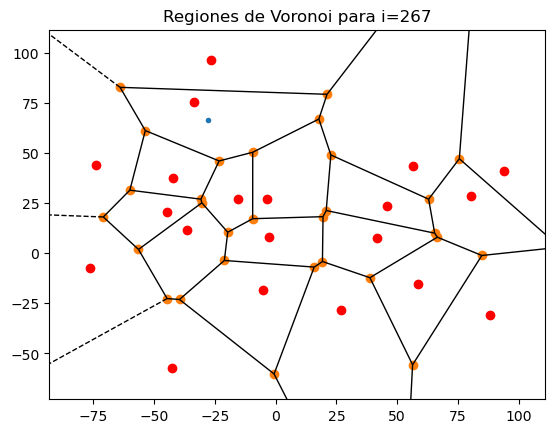

0.9688112883170109 266
515.856354190026 100


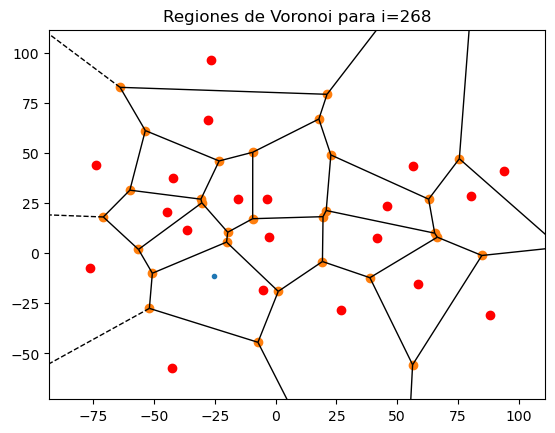

0.9882130380950161 267
509.7759749947443 101


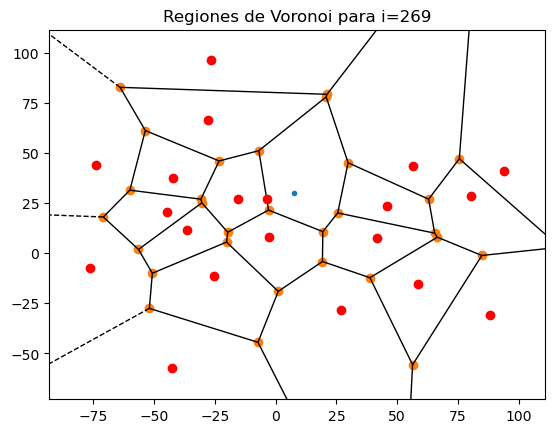

0.002914150674834158 268
1.485564001545175 102


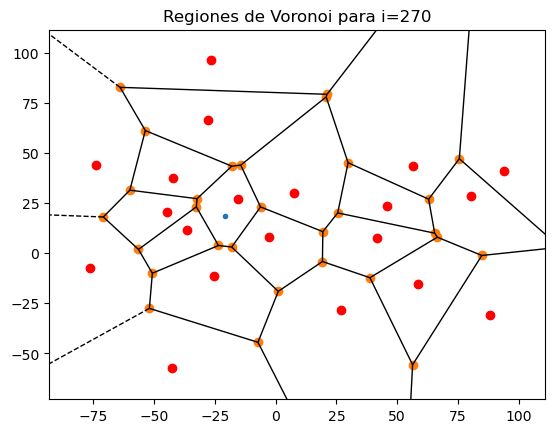

1 269
4.375937971367971 103


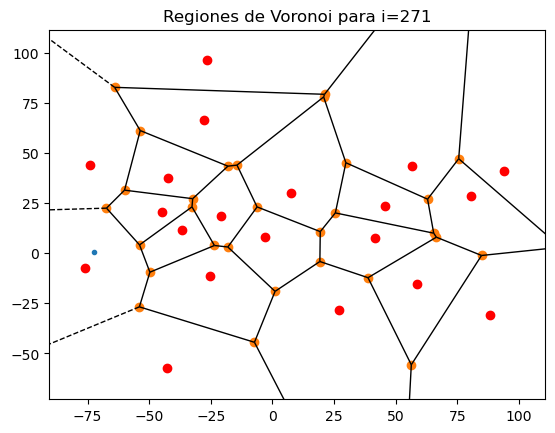

0.7330339171475084 270
3.207710952346386 104


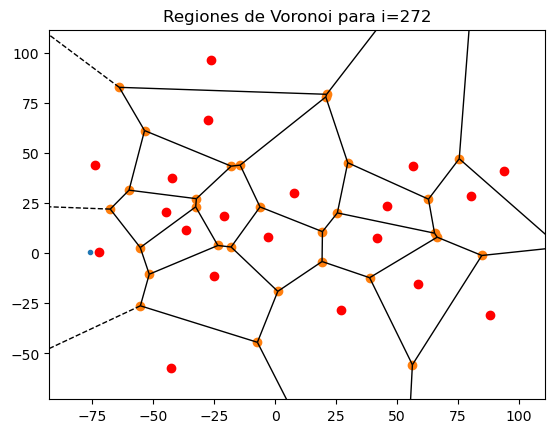

0.9077974157885993 271


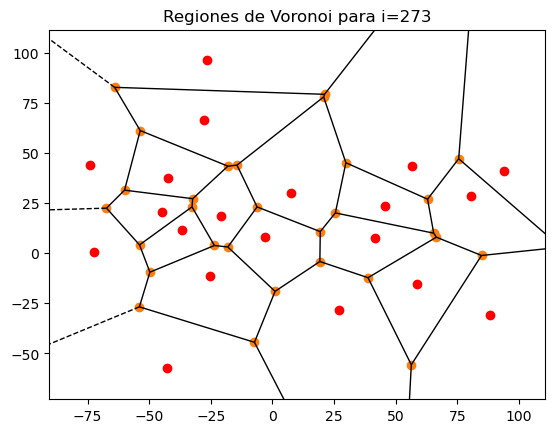

1 272
5.123404590269902 105


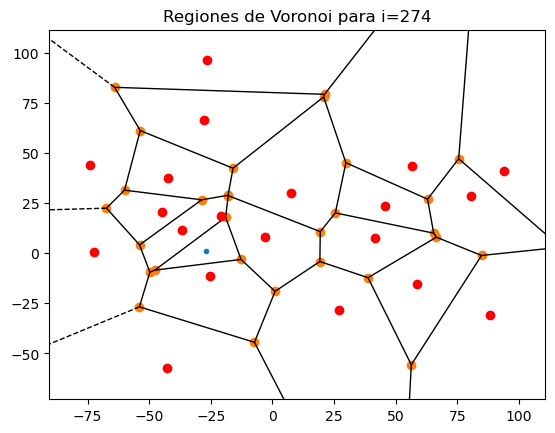

0.23479567053605044 273


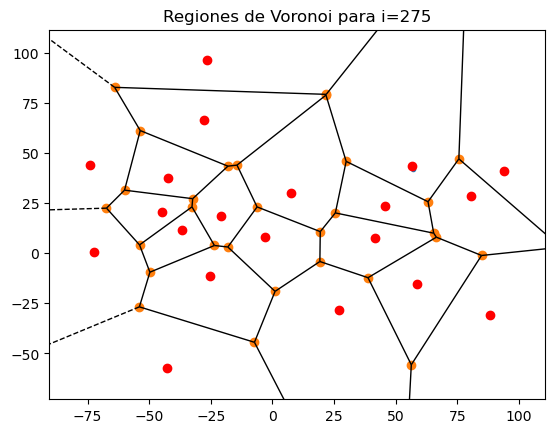

0.9860584002502025 274
5.051976134116084 106


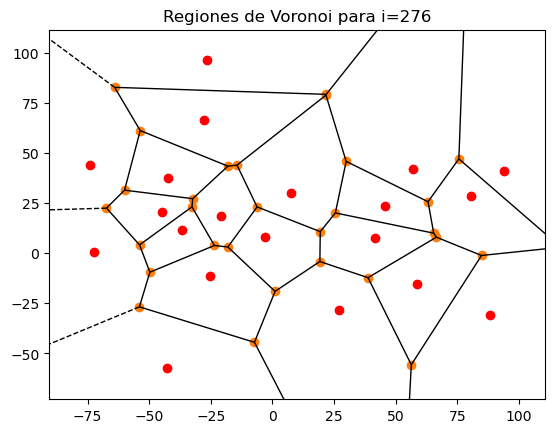

1 275
5.053435708933591 107


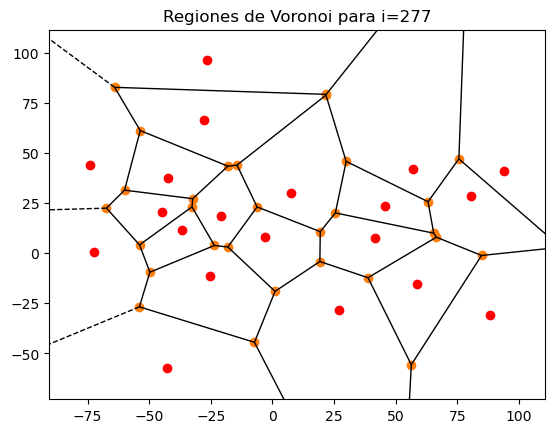

1 276
5.053435708933591 108


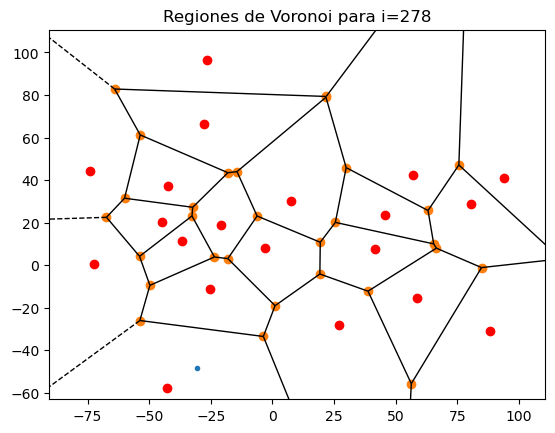

1 277
7.770065086814139 109


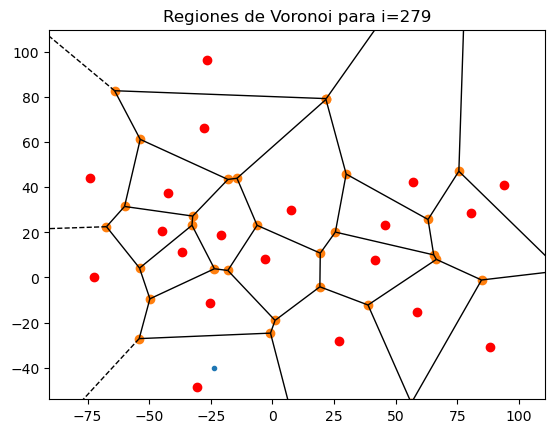

0.47500048476861667 278
3.6907846829204196 110


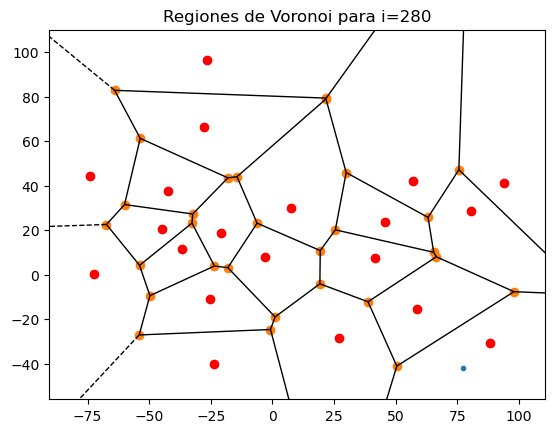

1 279
4.199229481437429 111


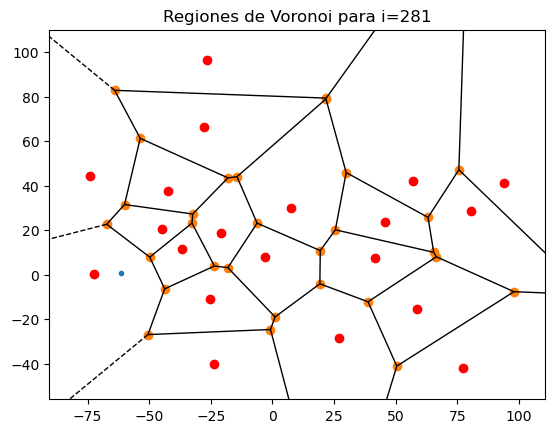

1 280
11.57456046870796 112


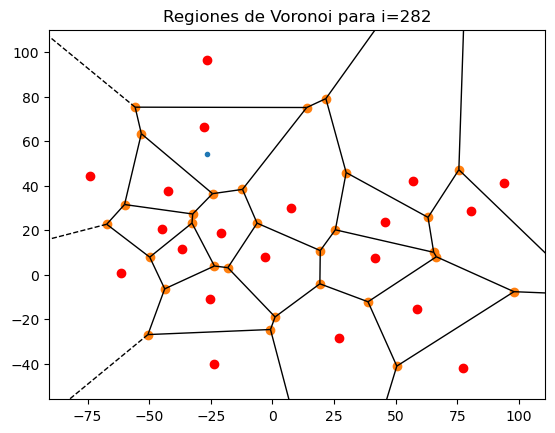

1 281
20.17289647796678 113


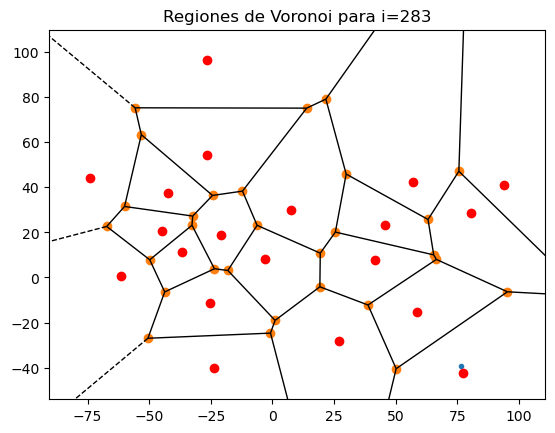

1 282
29.1831796527213 114


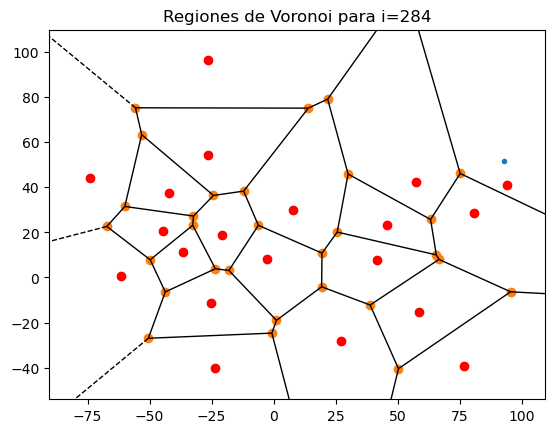

1 283
596.9761131666278 115


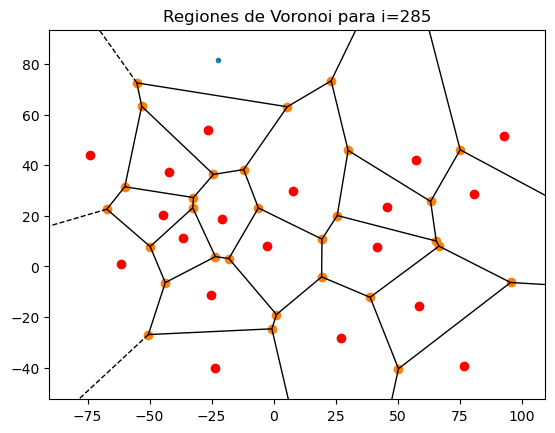

0.08533188935560257 284


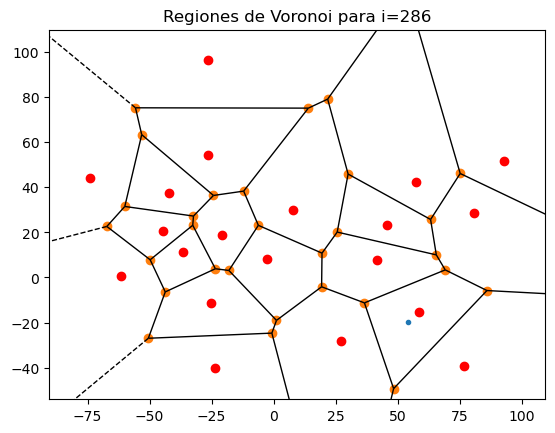

0.0845167759236788 285


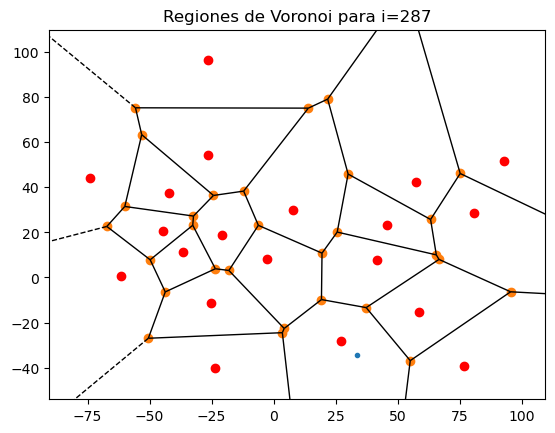

0.2571242314811149 286
153.49702431055223 116


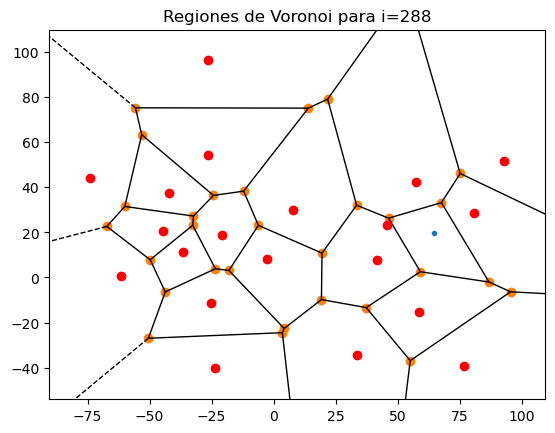

0.0063532965363911785 287


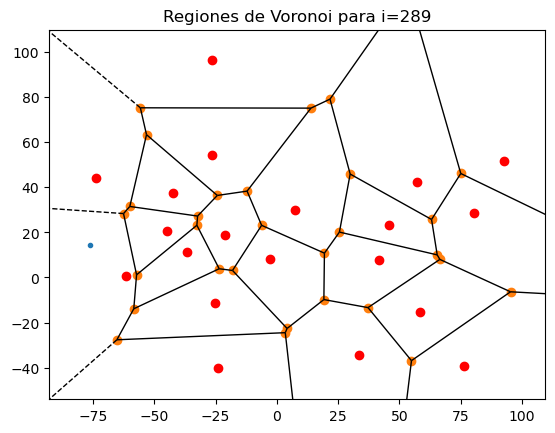

0.30594092790340904 288


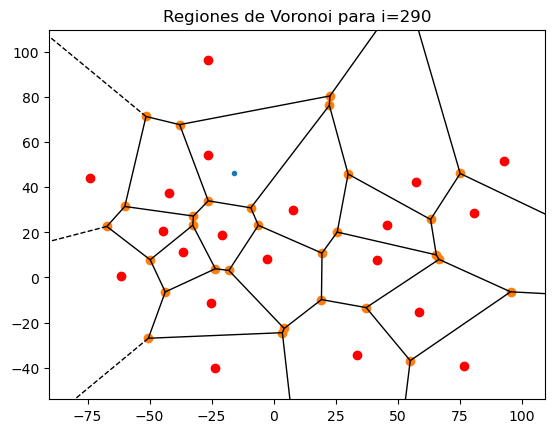

1 289
154.18417878965232 117


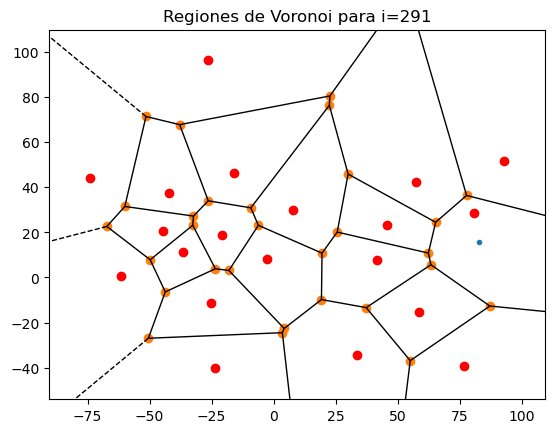

0.21923366544708206 290


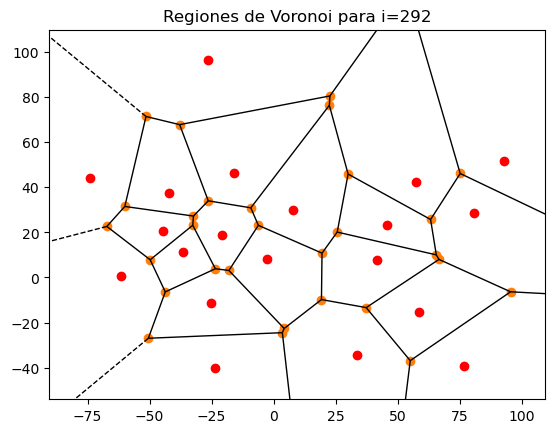

0.3136324161942236 291
48.35715653272082 118


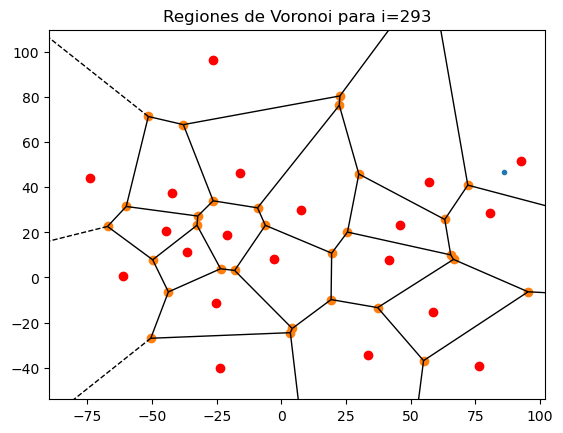

0.9992619171477044 292
48.32146494469825 119


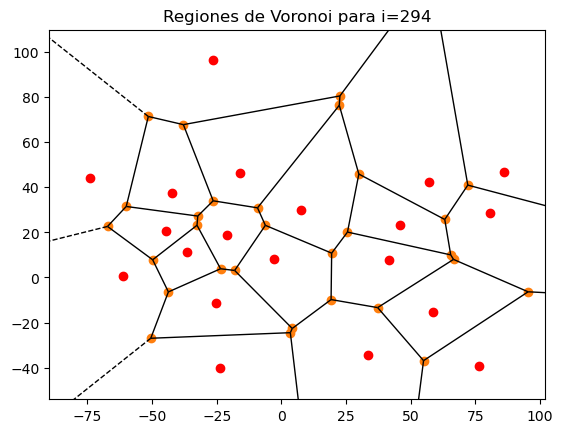

0.9999998836869246 293
48.321459324280056 120


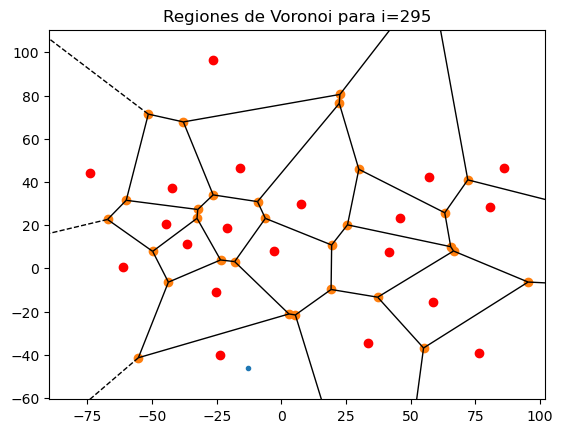

0.018265977001283174 294


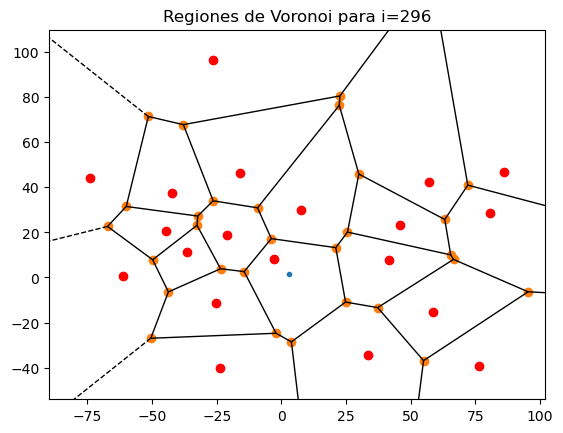

1 295
52.25085439286519 121


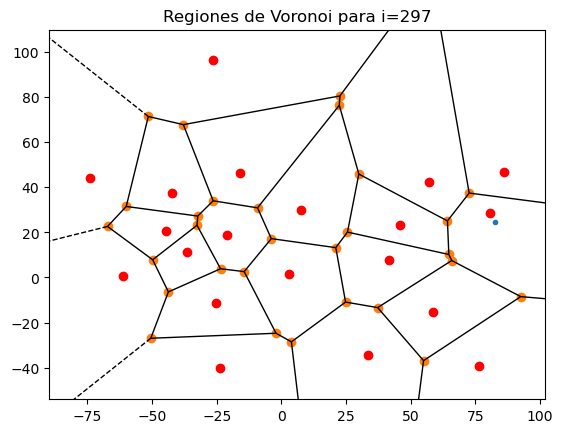

0.7145028478124836 296
37.3333842643376 122


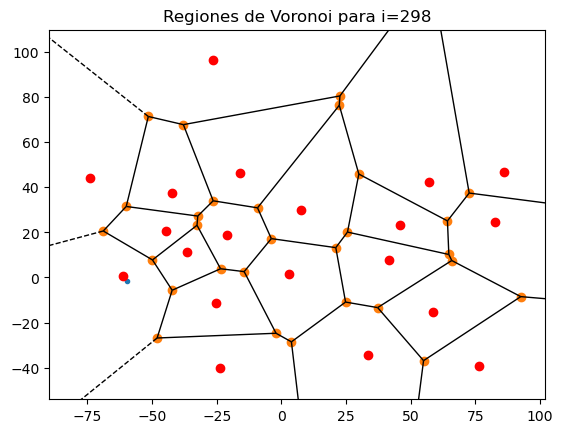

0.35610230542417853 297


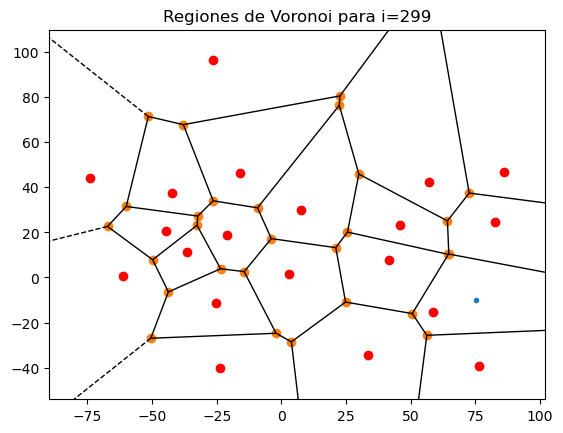

1 298
358.3379321563031 123


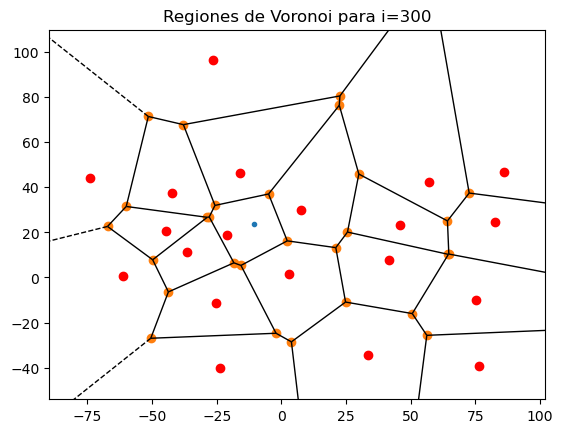

0.005528386326536319 299


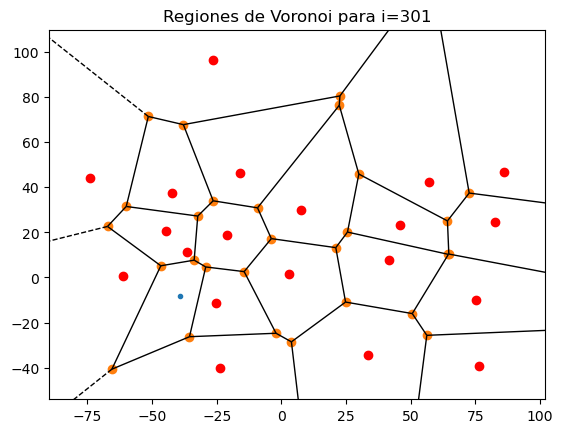

0.0014962348343185244 300


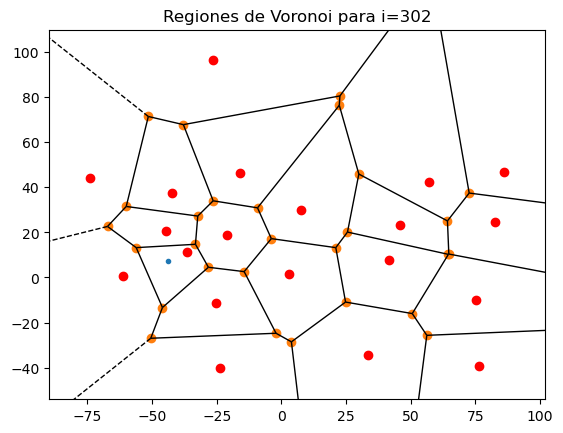

0.021881375055173184 301


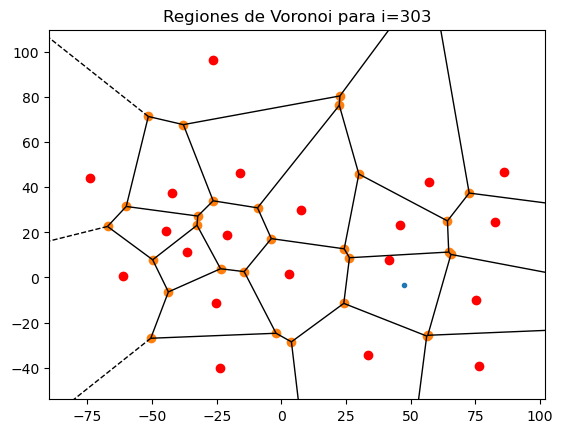

0.0060230587367945945 302


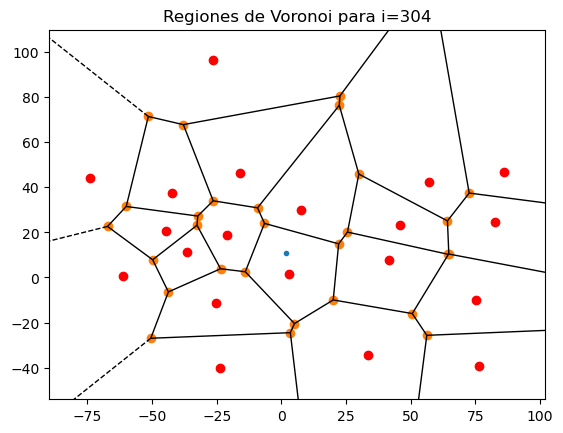

0.6247133217467677 303


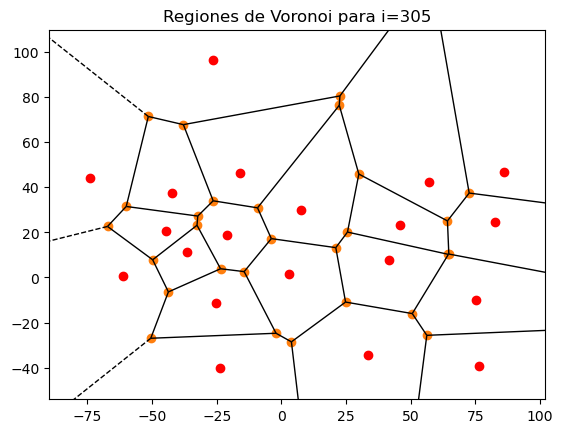

0.09307263859081191 304
33.35145685296248 124


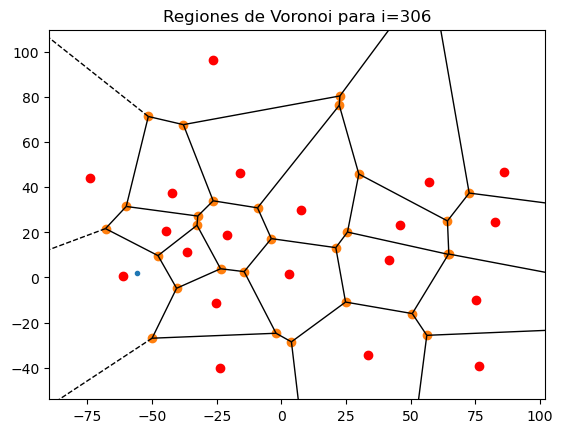

1 305
106.53842022551784 125


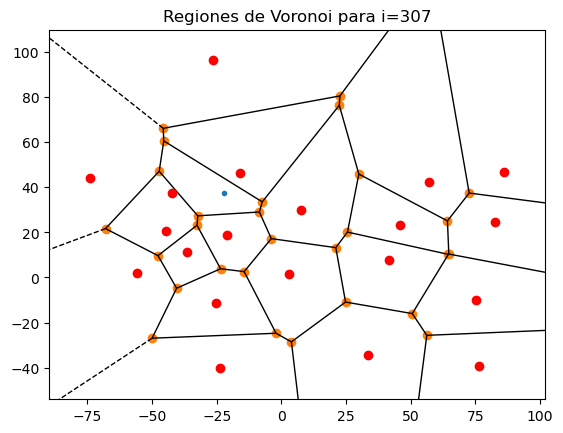

0.13194950182850515 306


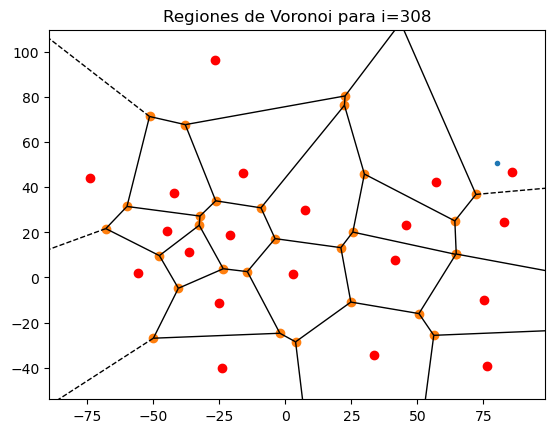

0.013337456632719647 307


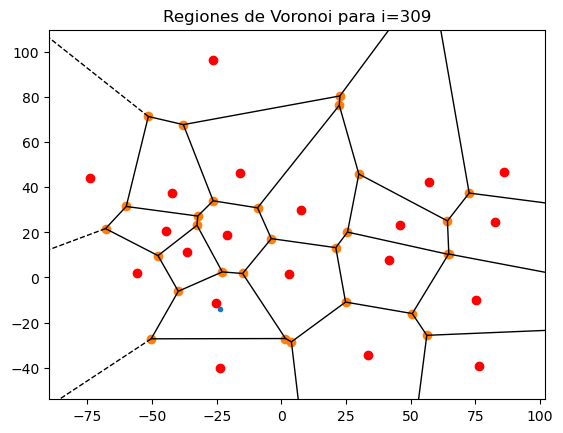

0.6951700416081331 308


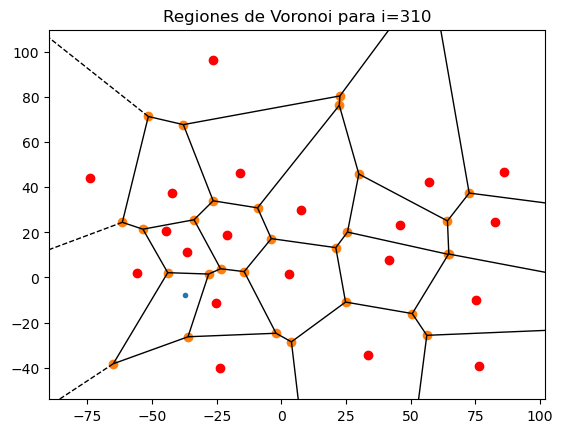

0.0035551404695614262 309


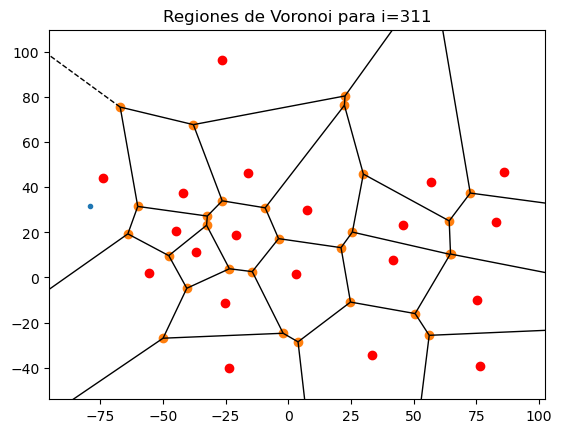

1 310
369.7904339136393 126


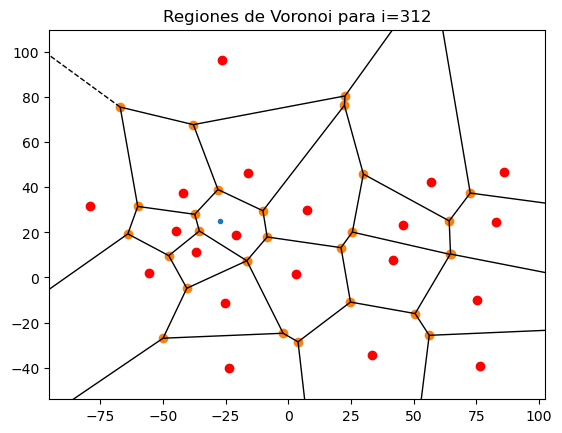

0.0037197699214514385 311


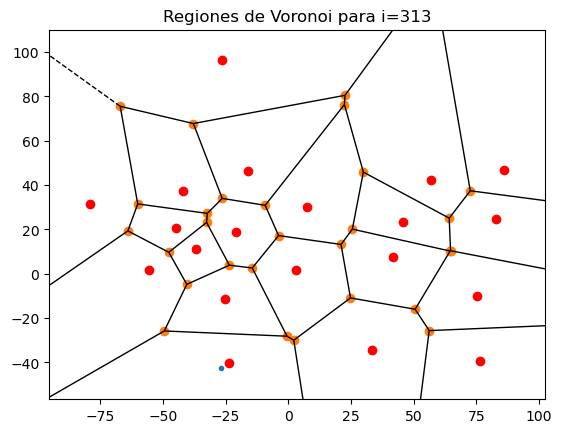

0.2714973263372847 312


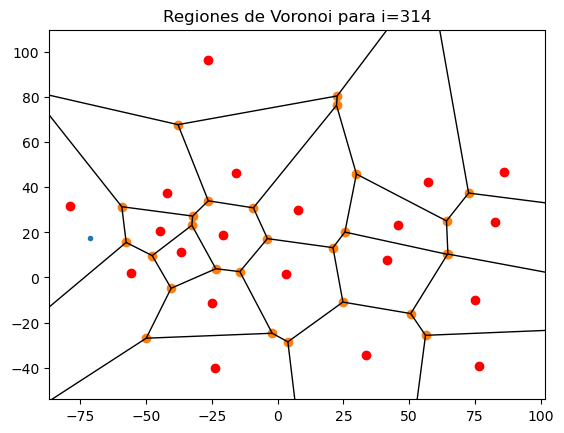

1 313
637.1441994400524 127


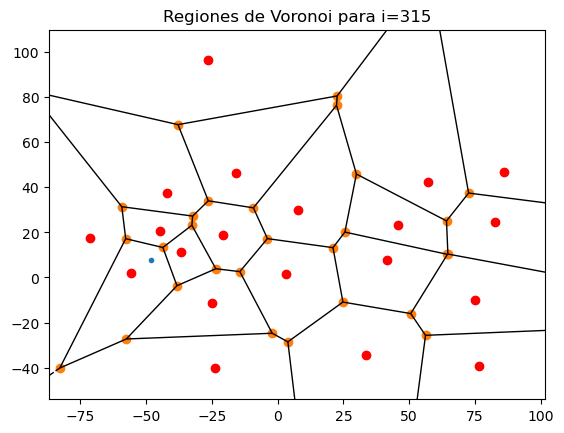

0.02231669044015613 314


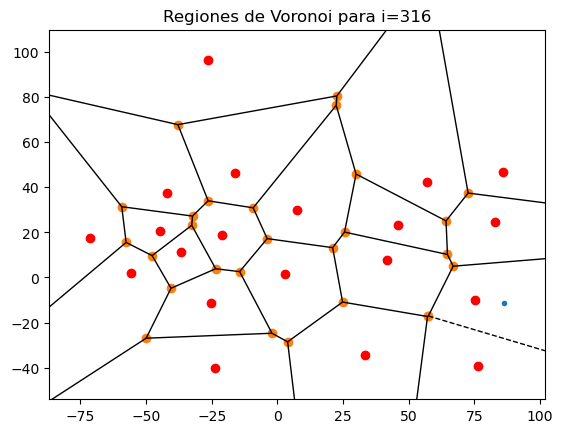

0.674261376455532 315


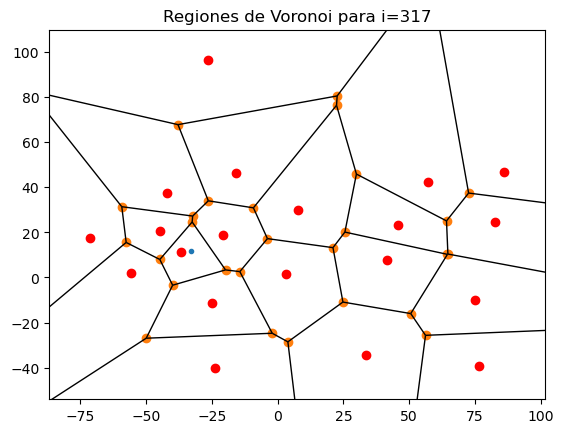

0.008403963390132666 316


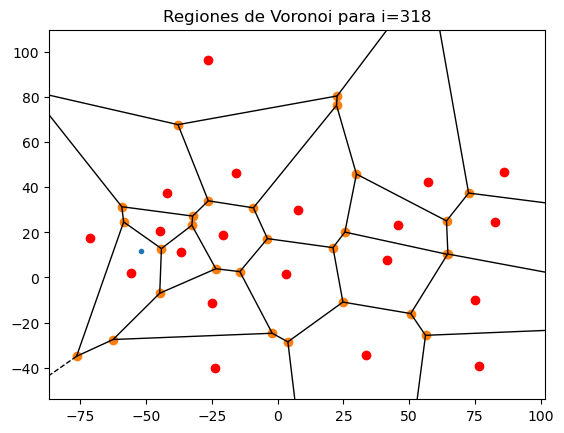

0.07166934896120798 317


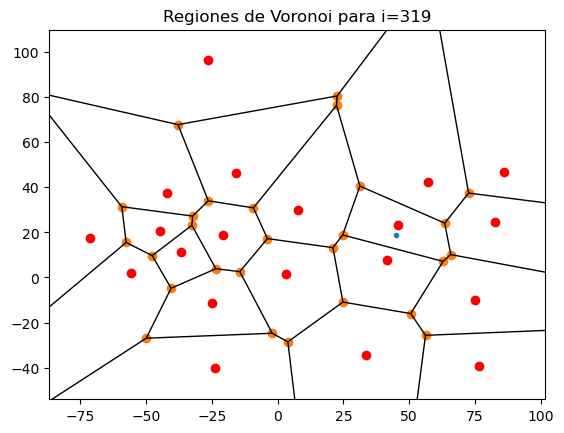

0.6070501905313946 318


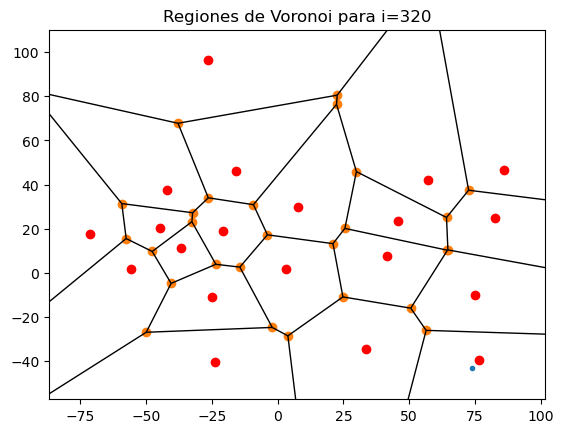

1 319
1151.9889534688077 128


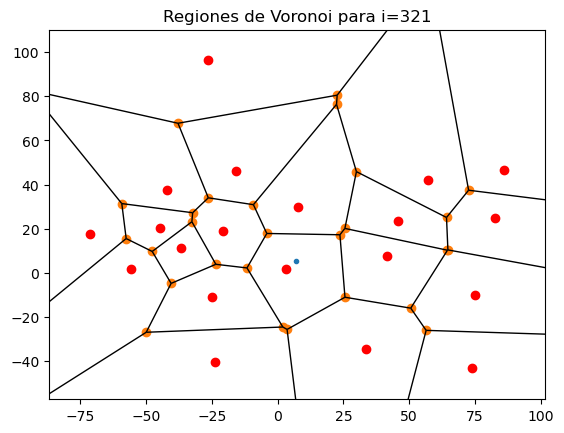

0.0004889811384806374 320


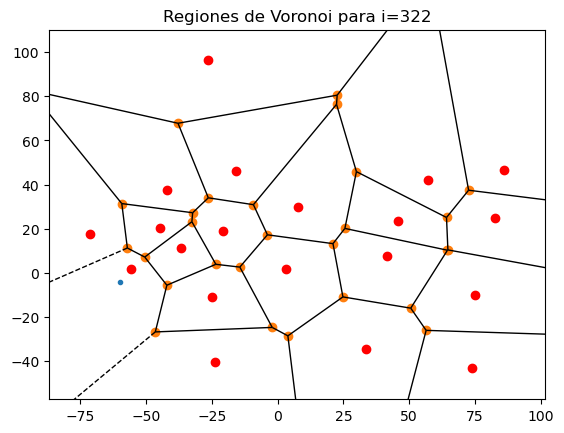

0.002462089401496505 321


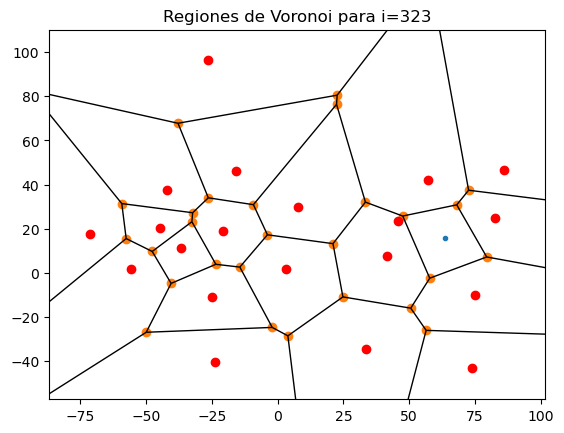

0.0006871370510574639 322


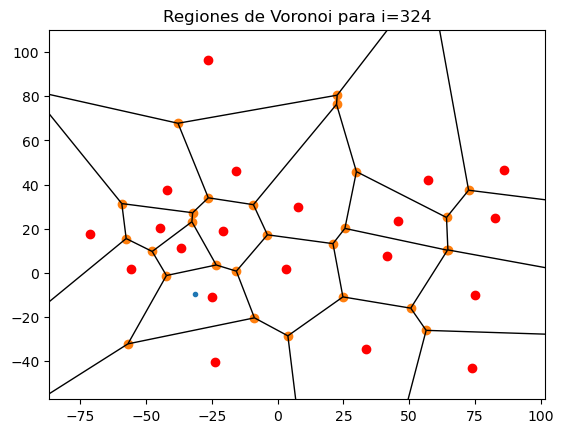

0.14870733696529506 323


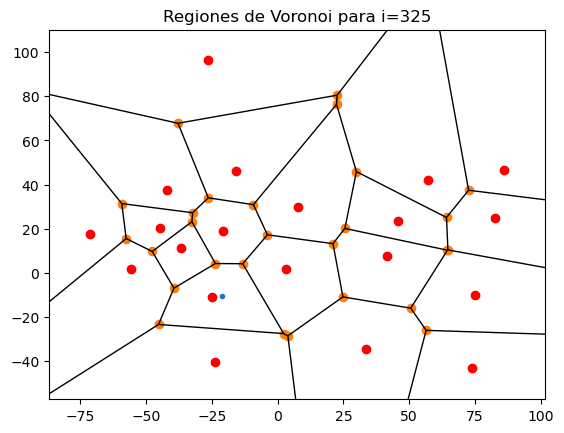

0.06871368241925271 324


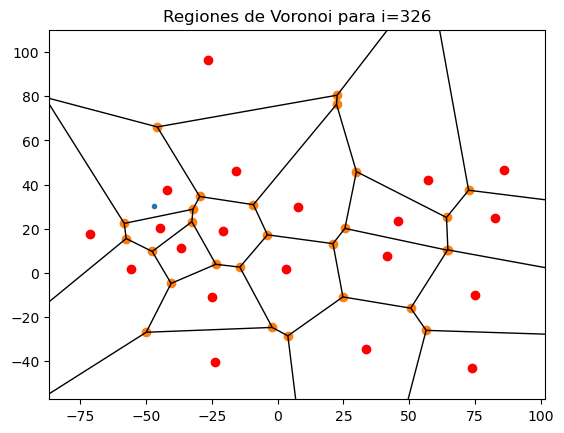

0.5535508558819906 325
637.6844711592571 129


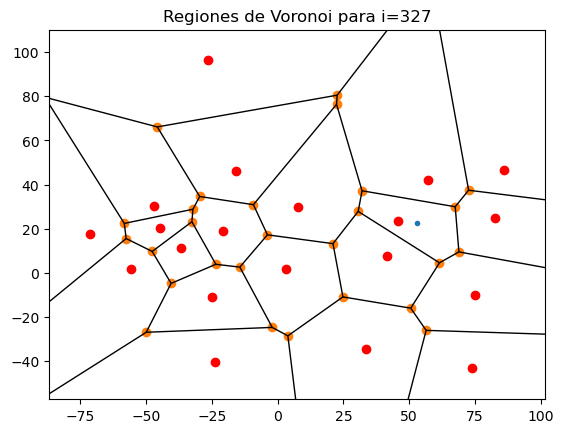

0.15993167758388138 326


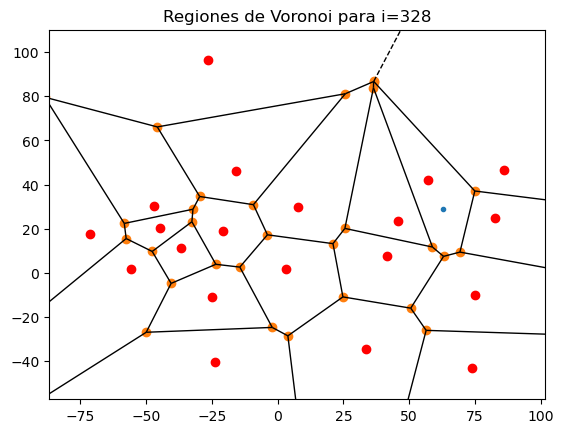

0.1599160882849468 327


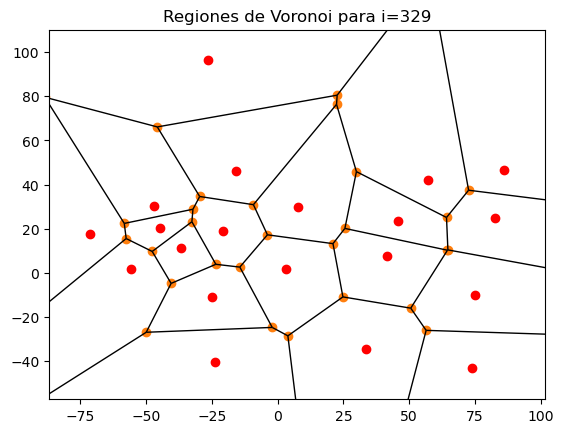

0.15986723243004622 328


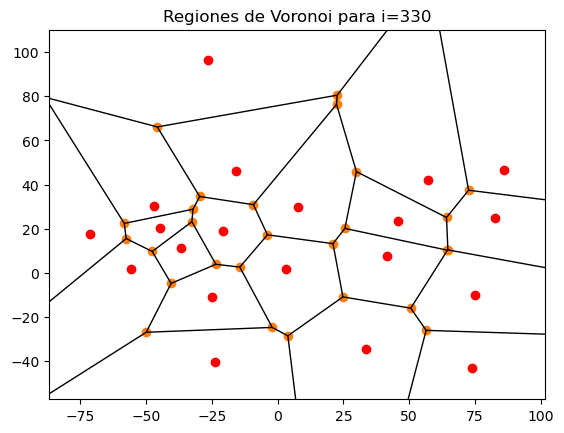

0.15986723243004622 329


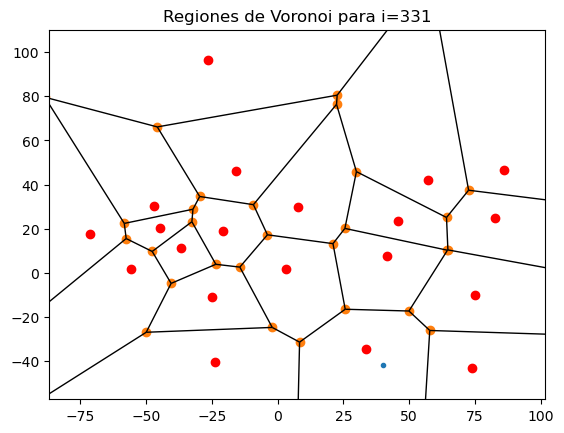

0.15985815845440968 330


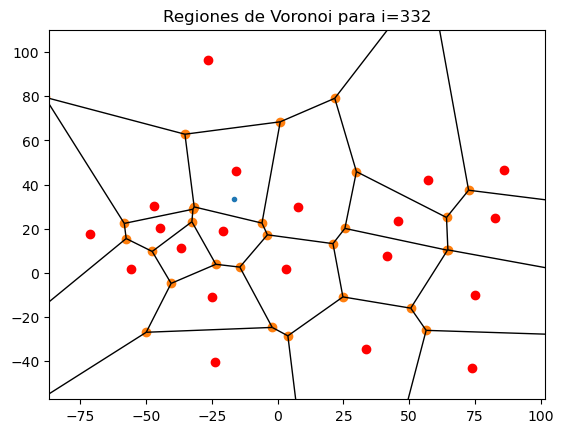

0.15054947089875267 331


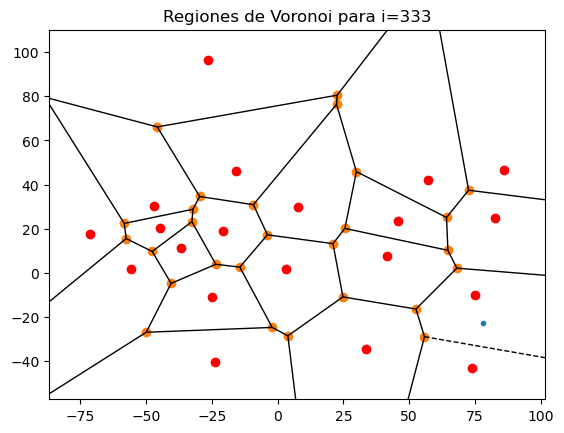

0.15998897417988123 332


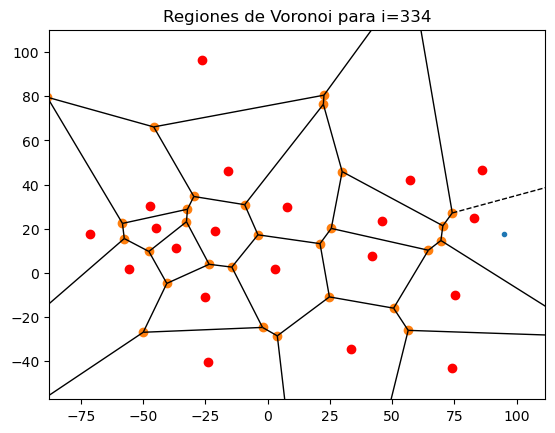

0.2020678843744189 333


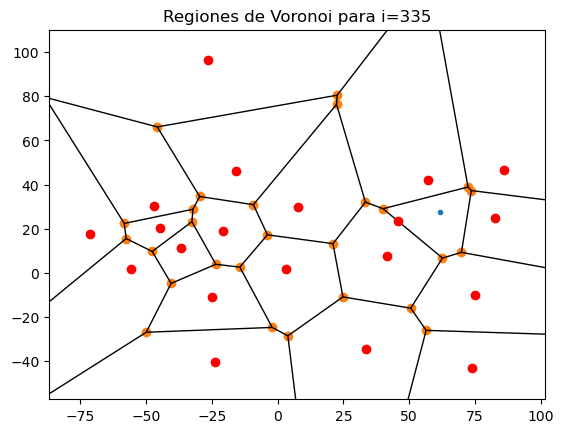

0.2586776055224242 334
164.95469207831 130


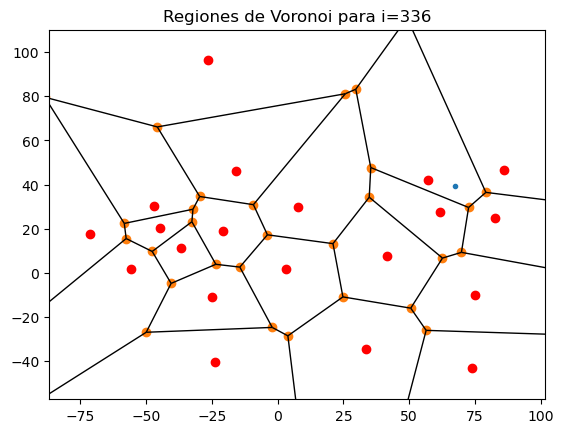

0.6177833747438763 335
101.9062663519753 131


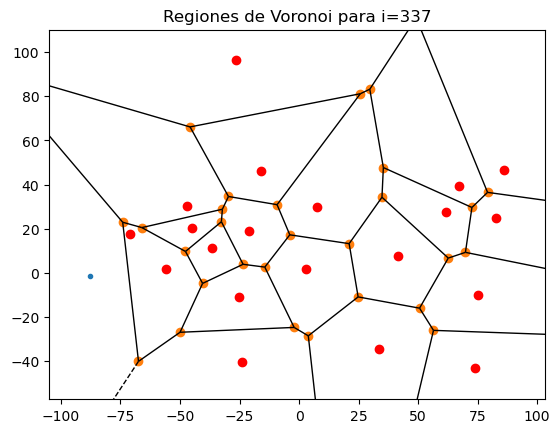

0.005705623498636945 336


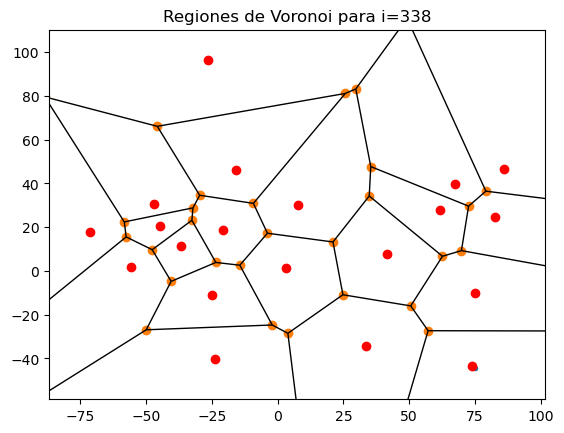

1 337
101.94102947817954 132


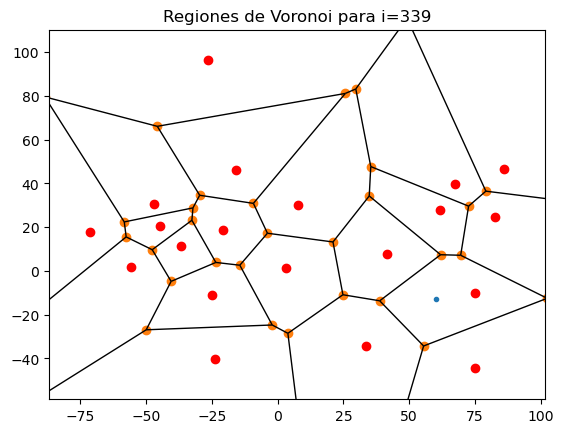

1 338
102.08911686420397 133


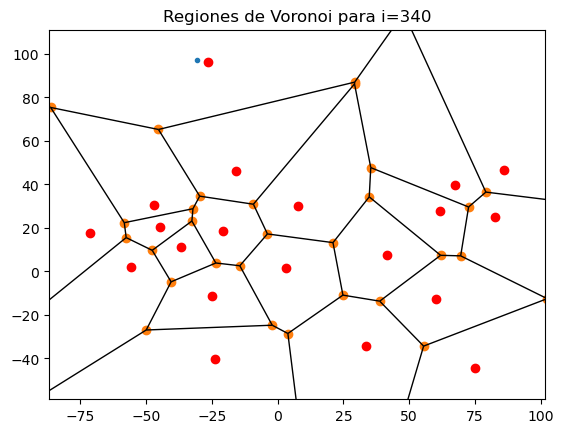

1 339
102.63754603208338 134


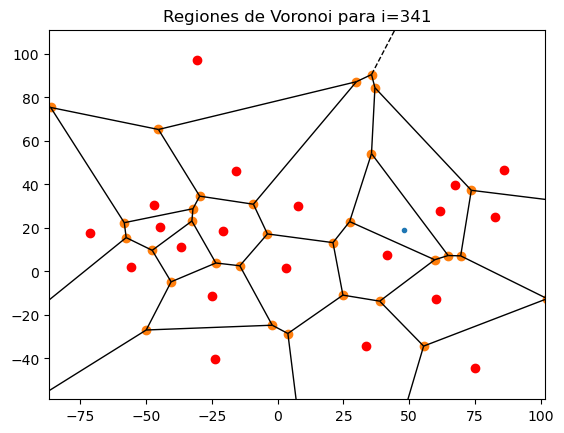

0.994568612641795 340
102.08008176208753 135


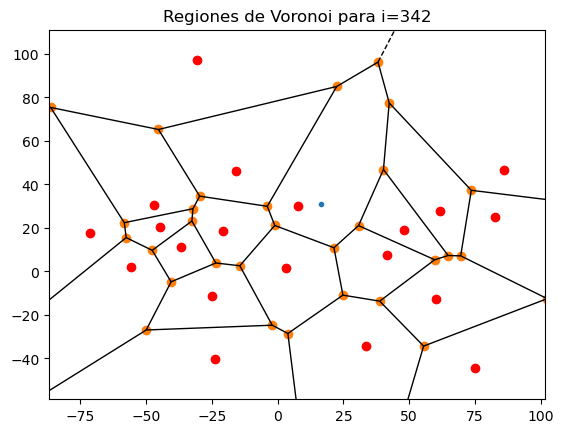

1 341
102.48492822333503 136


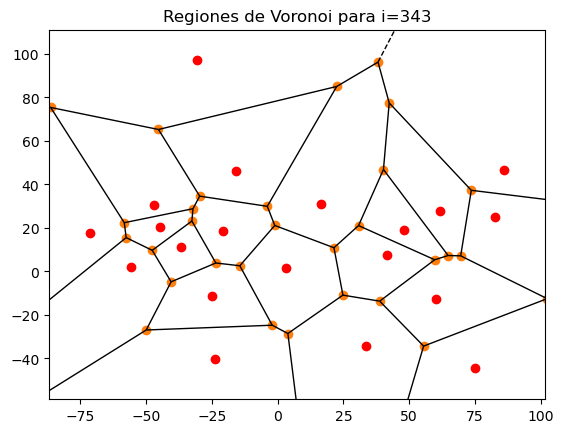

0.9997100310612431 342
102.45521077745954 137


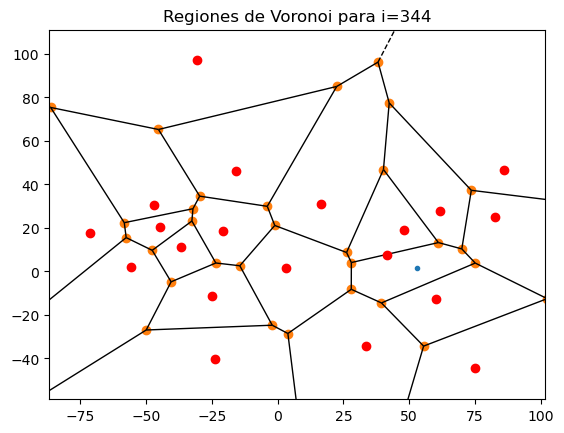

0.2506531928259936 343
25.68072570303038 138


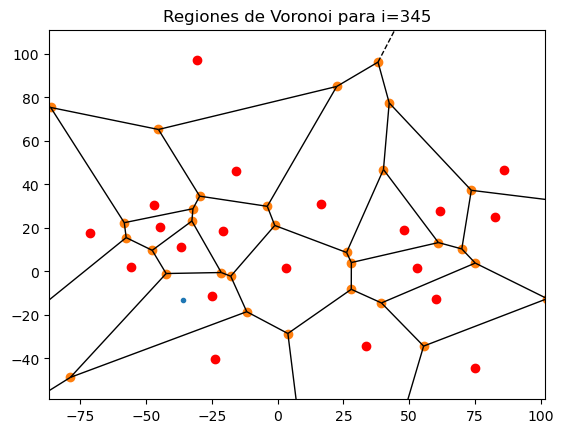

0.7770597825328684 344


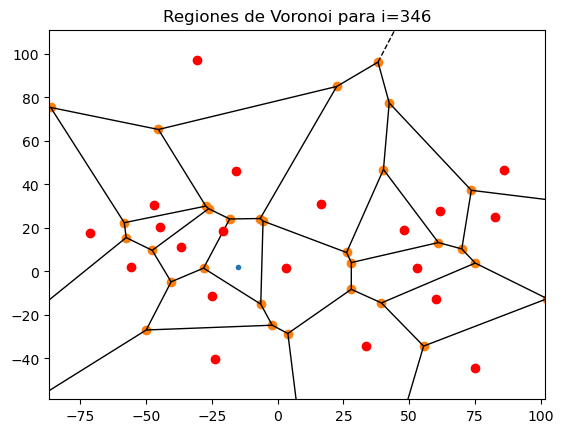

1 345
46.263415206527085 139


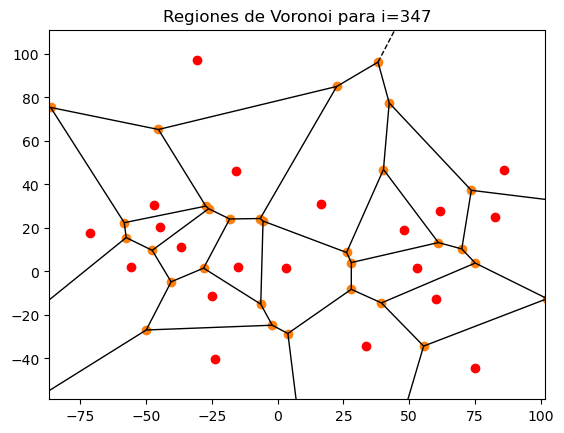

1 346
92.40383991186138 140


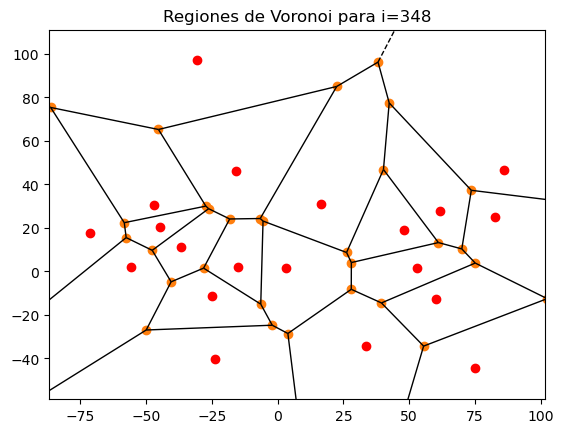

1 347
92.40383991186138 141


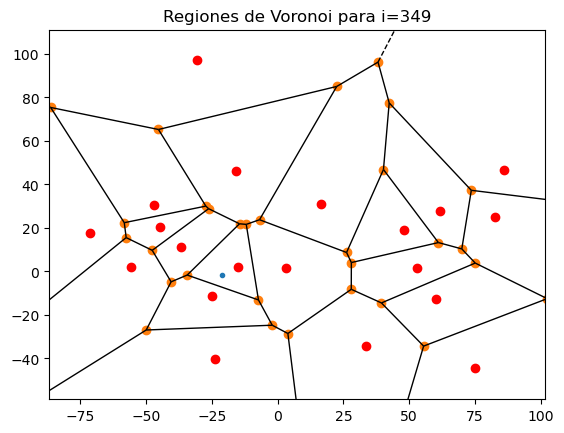

0.9324899496889479 348


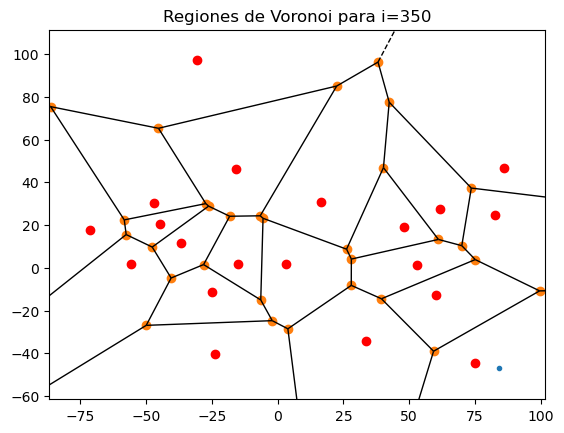

0.9834625896491139 349
90.87571969324135 142


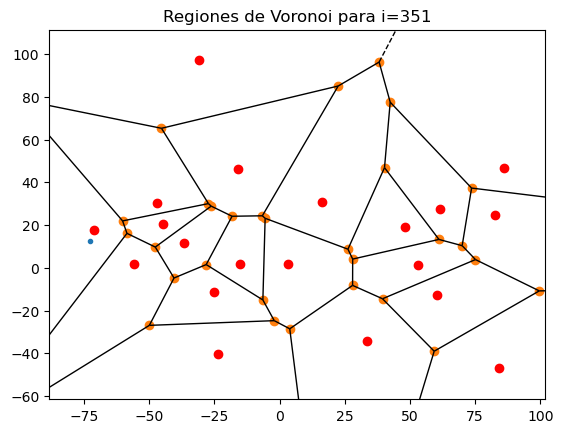

0.08609672914696635 350


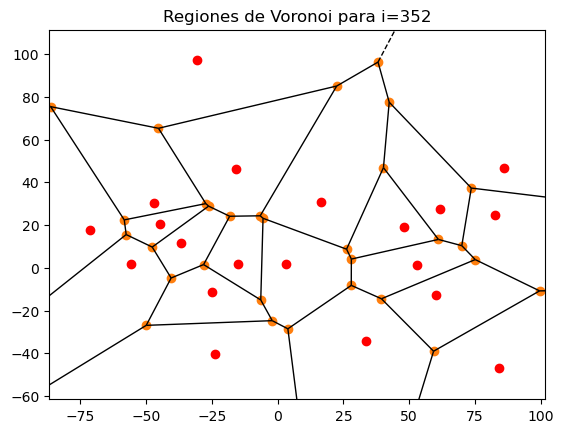

1 351
90.87988471844196 143


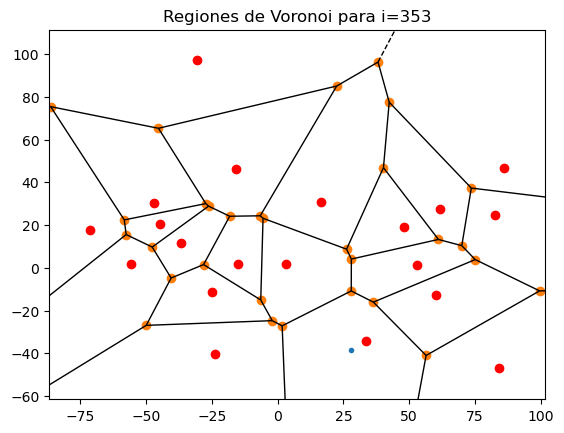

0.9995030603797992 352
90.83472290304609 144


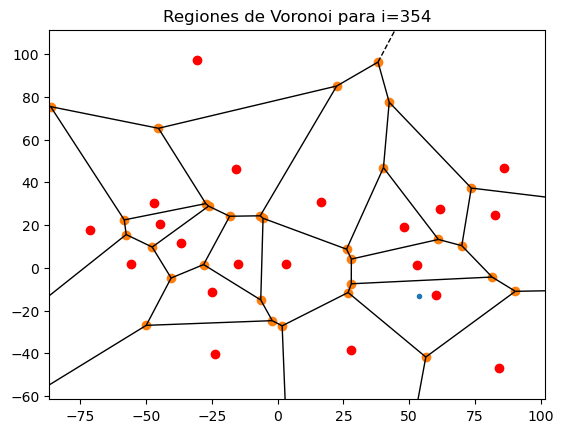

1 353
106.39235763127576 145


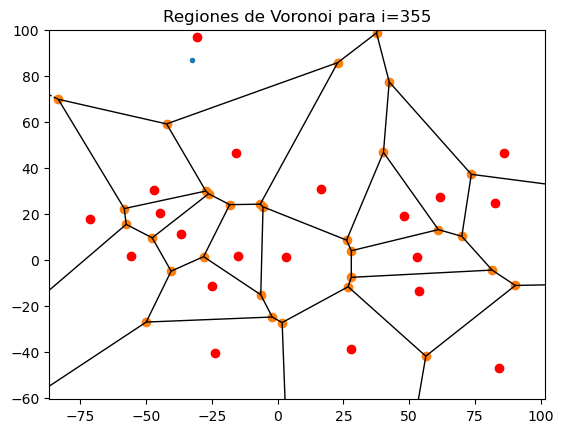

1 354
169.0757565161742 146


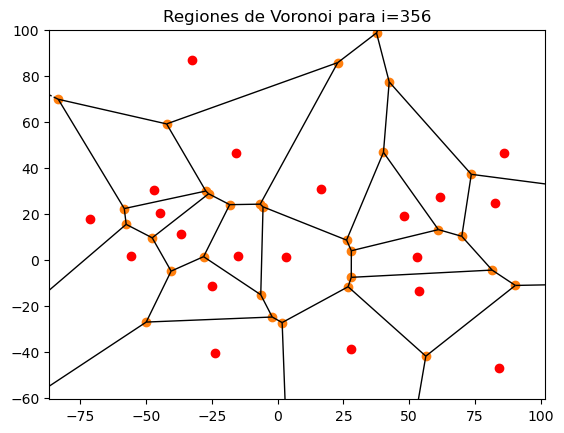

0.9995679797003485 355
169.0027123571803 147


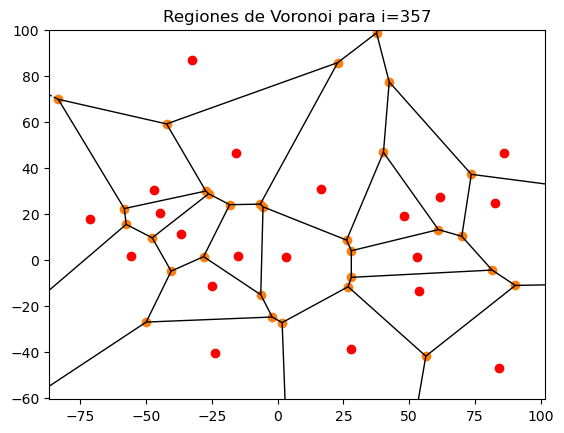

1 356
169.0027123571803 148


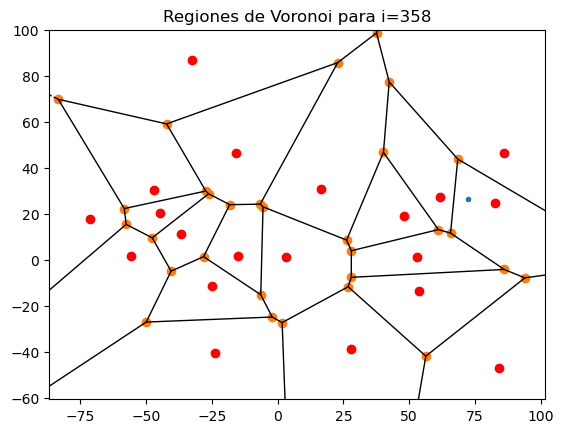

0.9999991167579099 357
169.0025630868714 149


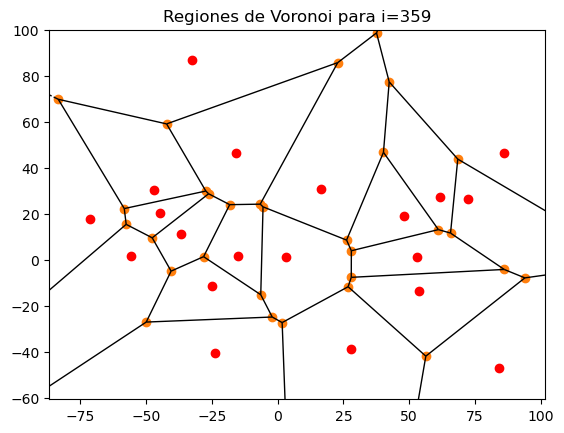

0.9999998782077448 358
169.0025425036681 150


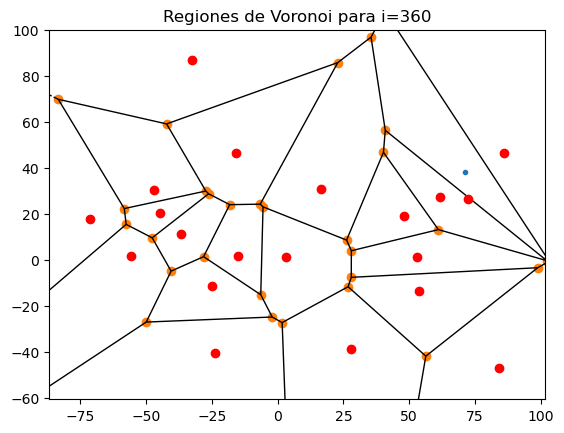

0.03582821022397054 359


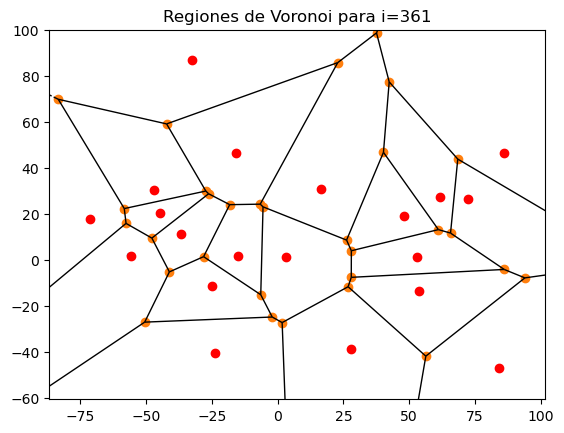

1 360
169.00349456466066 151


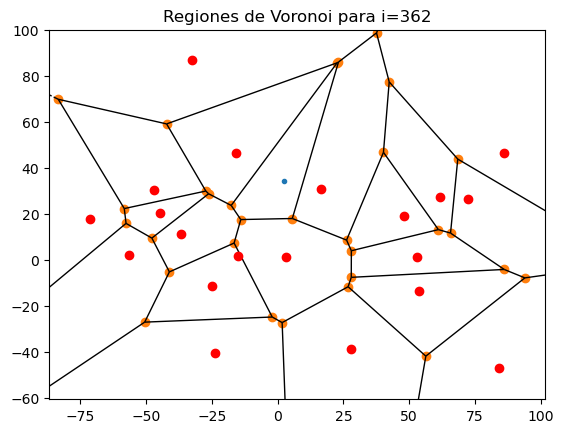

0.9007770598244993 361
152.23447093402078 152


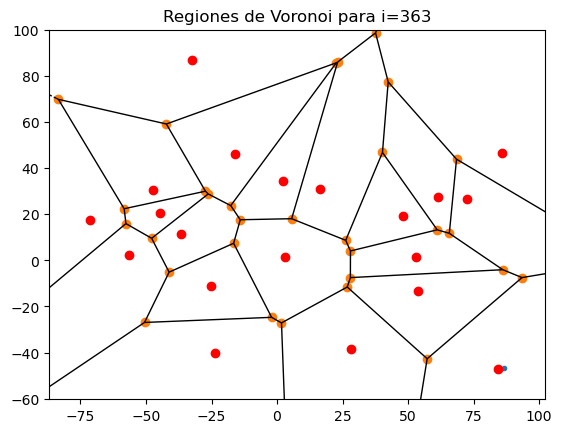

0.21200197236703636 362
32.27400810026467 153


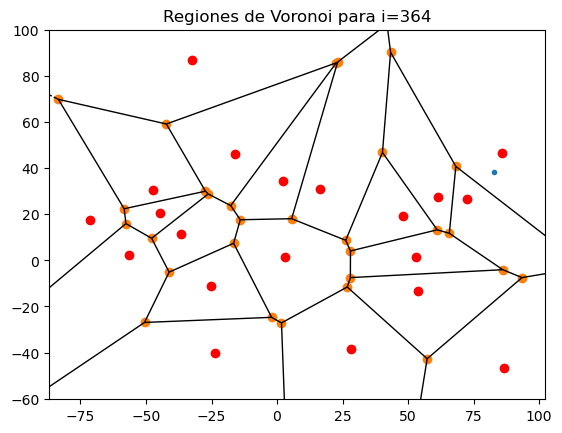

1 363
152.8249151124592 154


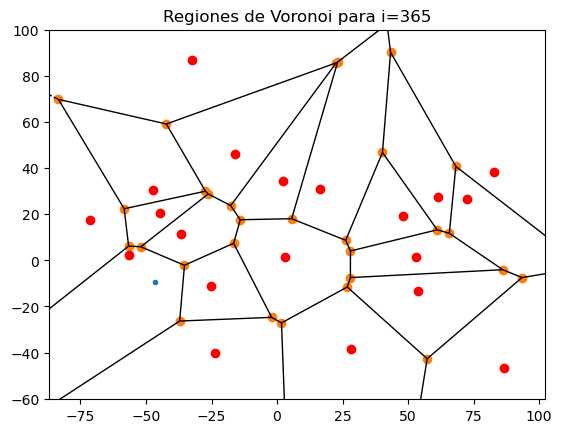

0.5189190510575032 364
79.30375992810082 155


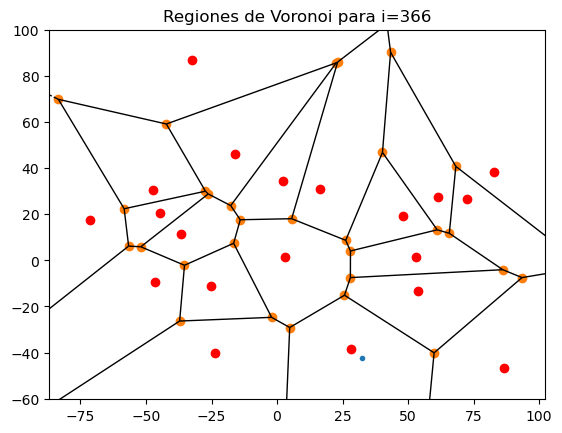

1 365
20307.52691966372 156


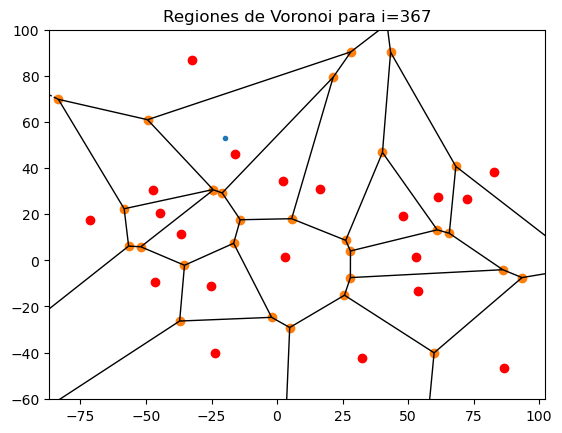

0.9947732848638959 366
20201.385261335872 157


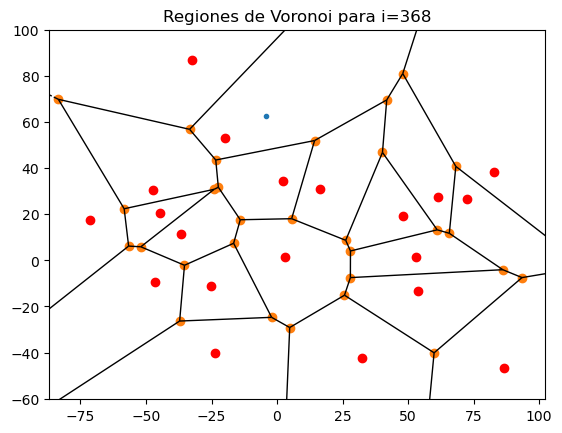

2.4640048860401942e-05 367


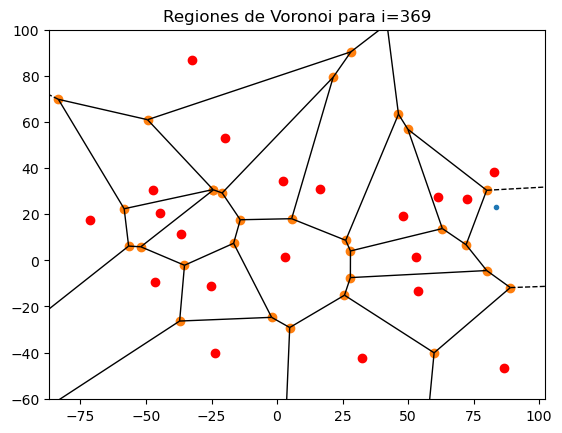

0.0010216788762882967 368


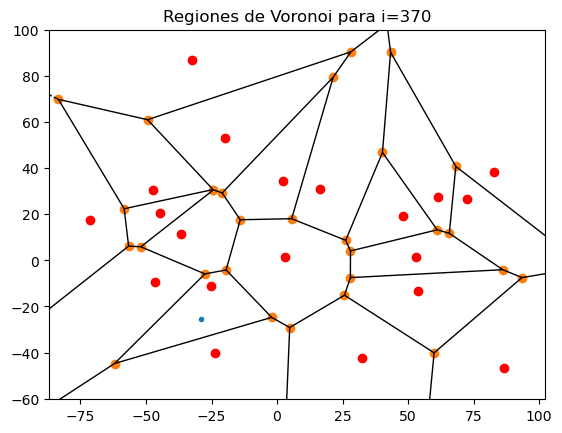

3.084872705669137e-05 369


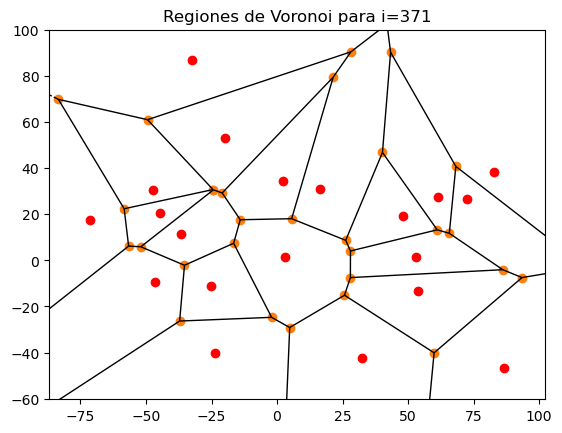

0.9999985521089869 370
20201.3560119317 158


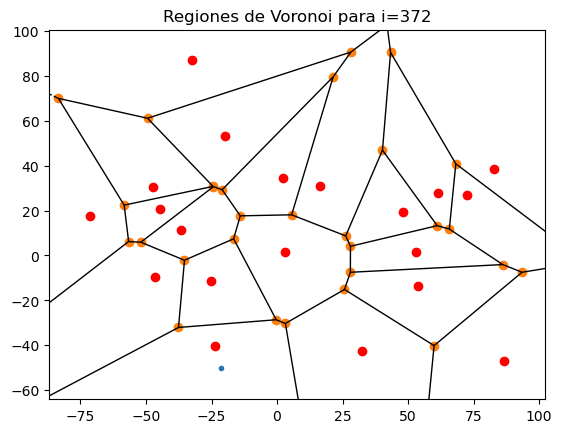

0.0002012294200599865 371


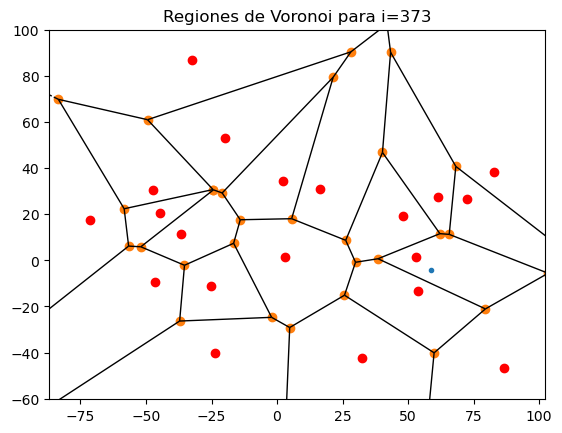

8.068523548279924e-05 372


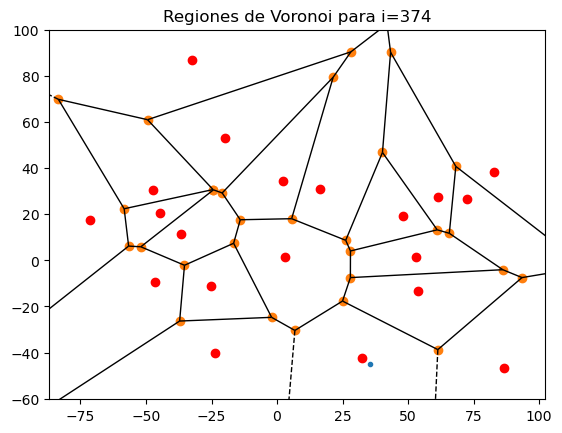

0.010157497458965133 373


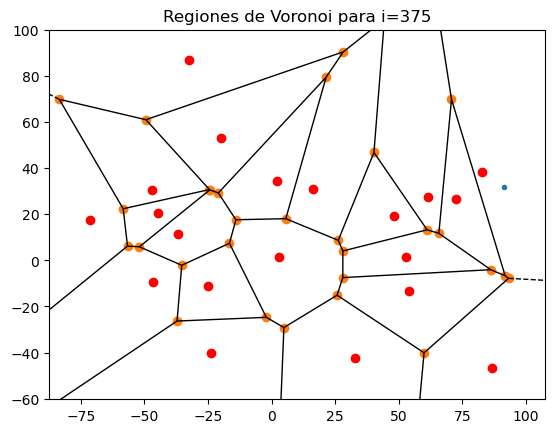

0.0010552482468452512 374


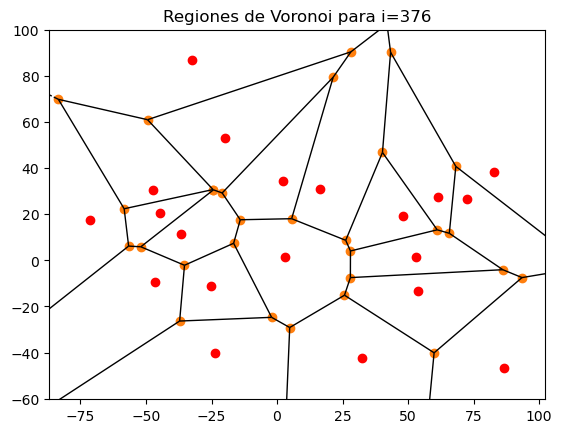

1 375
20201.3560119317 159


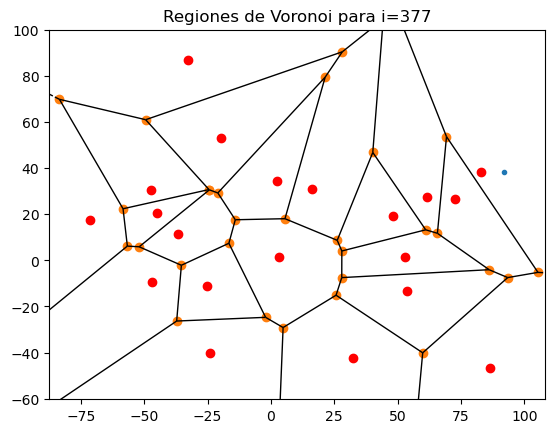

0.0001223656726897187 376


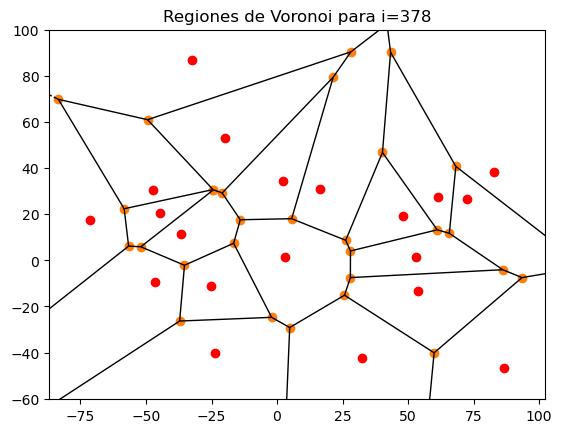

1 377
20201.3560119317 160


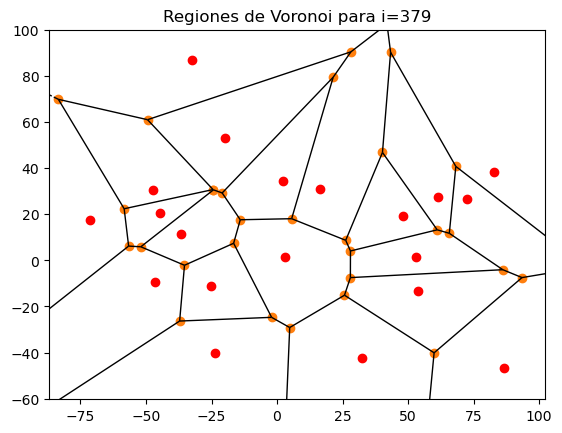

1 378
20201.3560119317 161


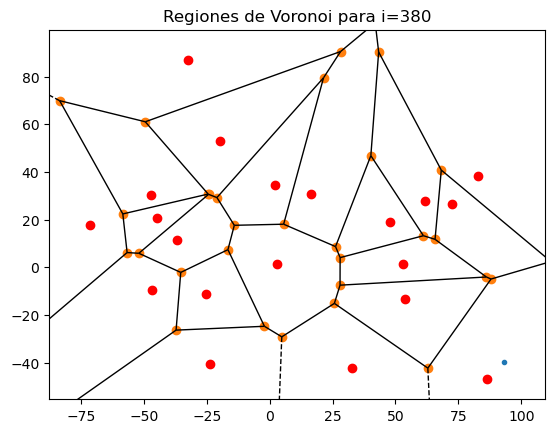

1 379
20201.590870047025 162


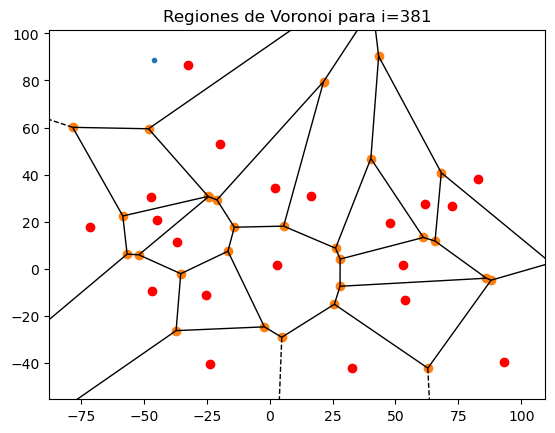

0.9999849973807786 380
20201.287793271535 163


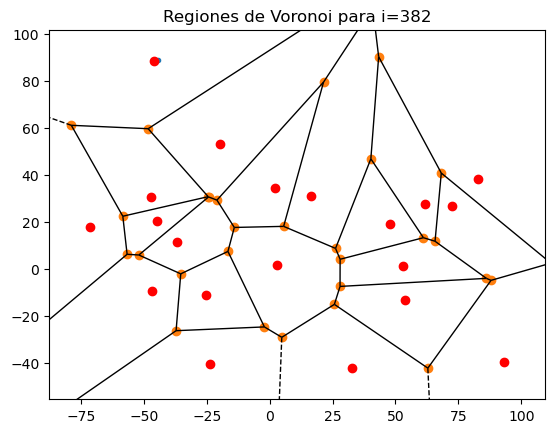

0.9999977460502226 381
20201.24226058341 164


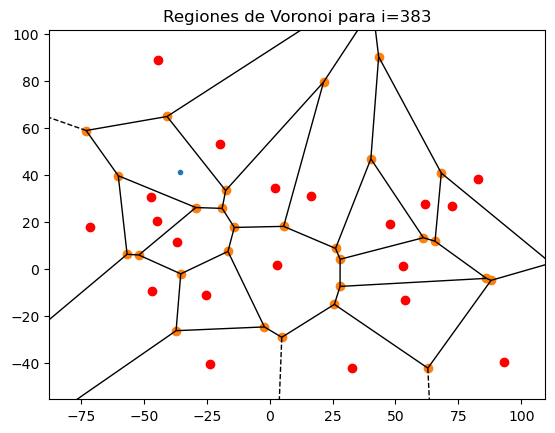

0.0013376270456644768 382


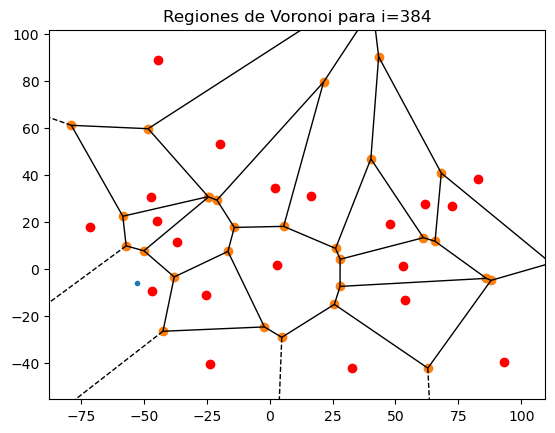

0.0030680523272730385 383


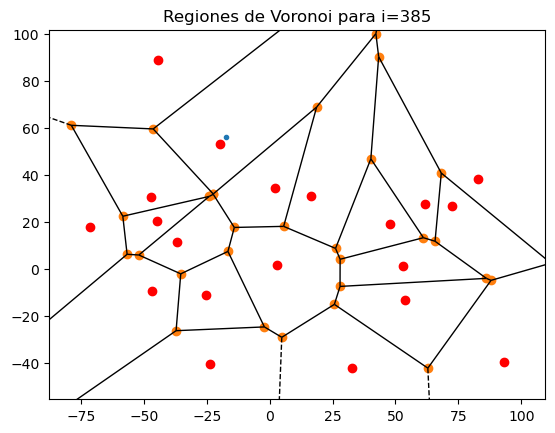

0.0006670346299302763 384


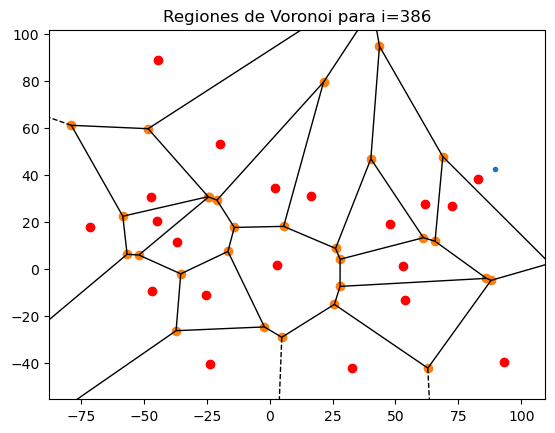

0.9999956920120472 385
20201.15523387512 165


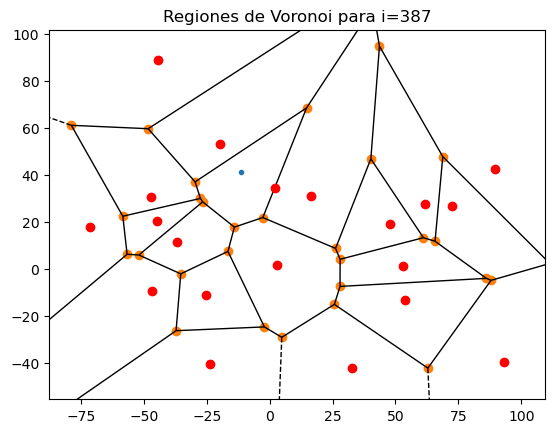

0.0028531853730281503 386


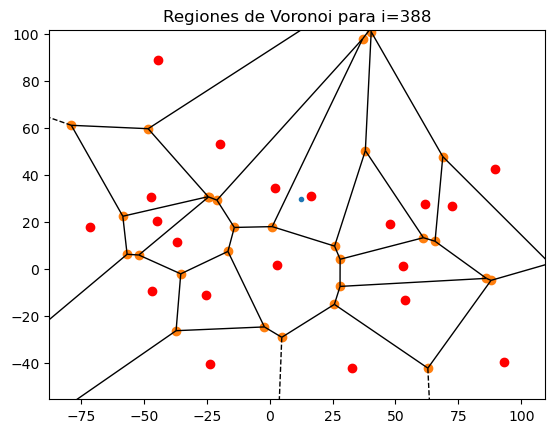

0.0002477221355400277 387


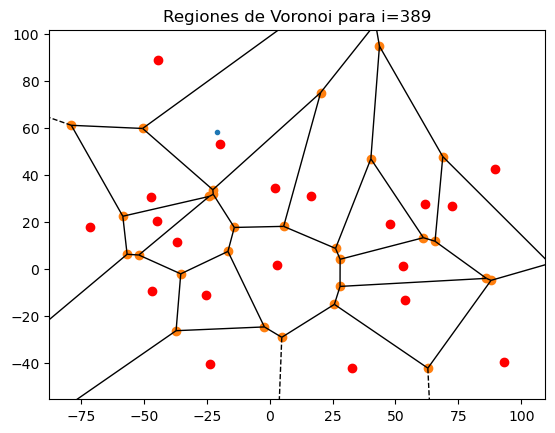

0.00022369349753956726 388


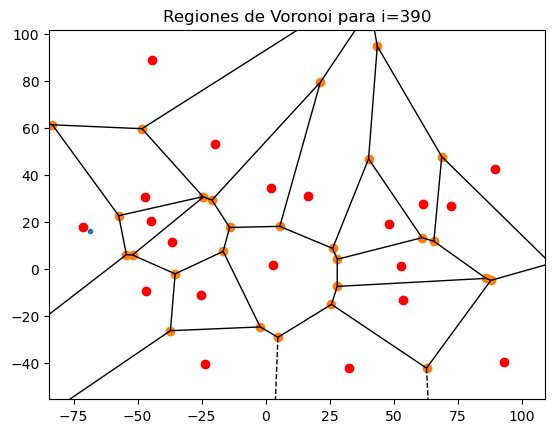

5.41944128438258e-05 389


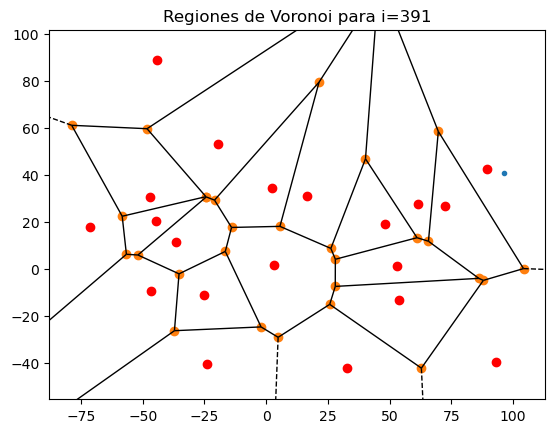

6.422871377856361e-05 390


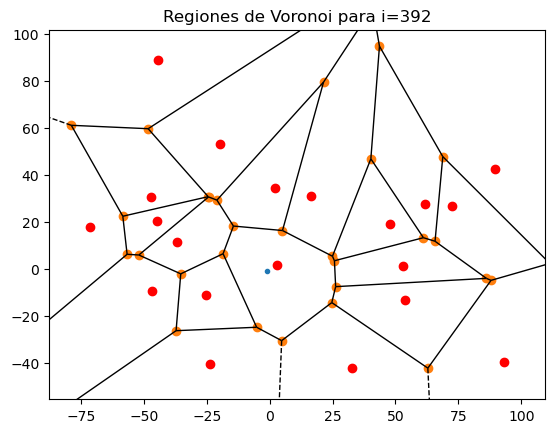

0.0011050358630260227 391


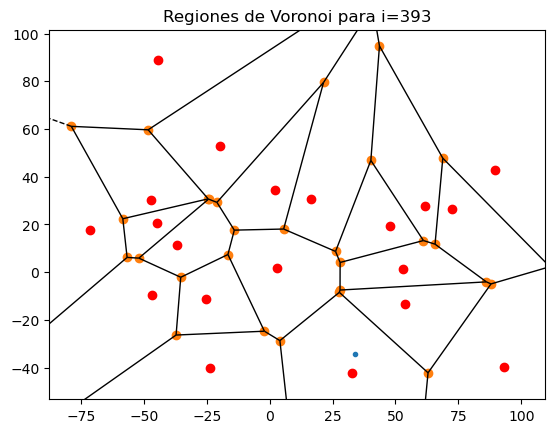

0.0005732160813551266 392


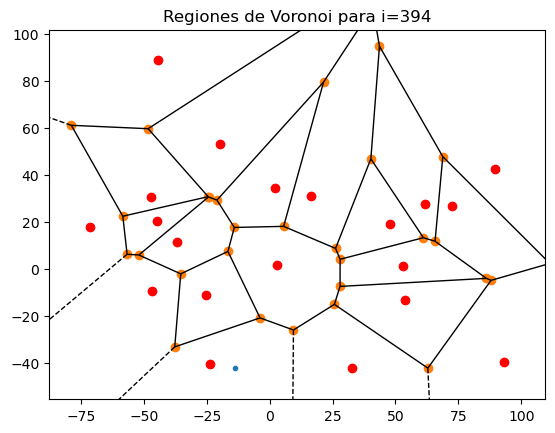

0.0006210388820426006 393


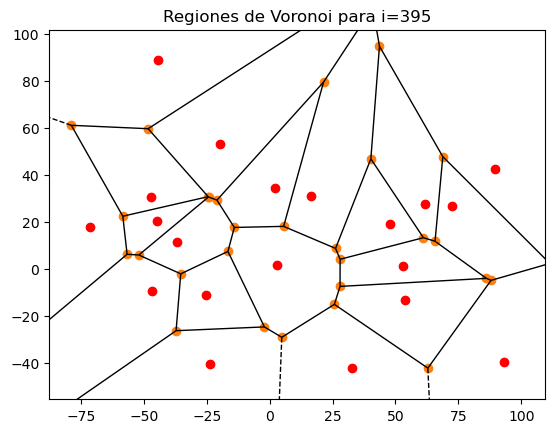

1 394
20201.158460592407 166


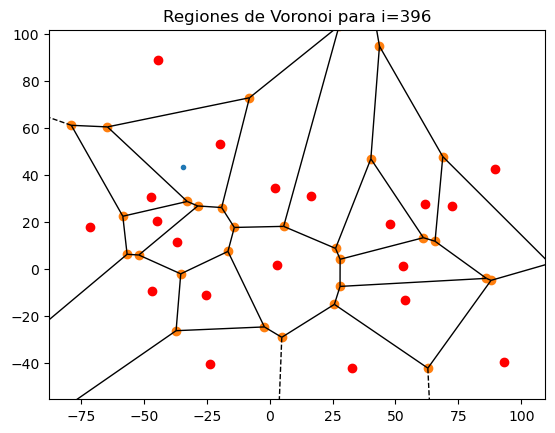

0.00027758346151258013 395


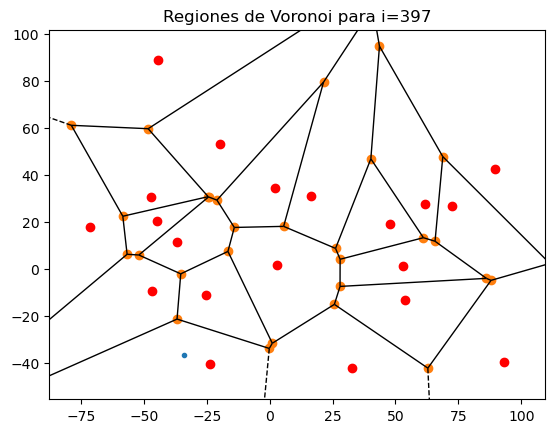

6.697553009930672e-05 396


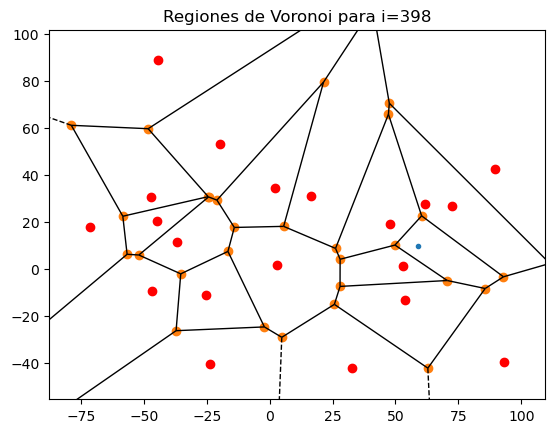

0.00035272494331391 397


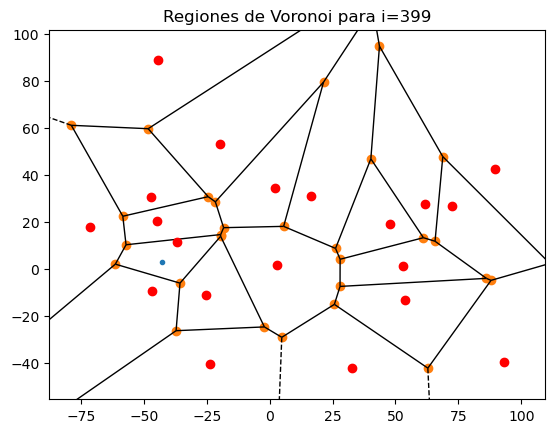

0.0015605288172922153 398


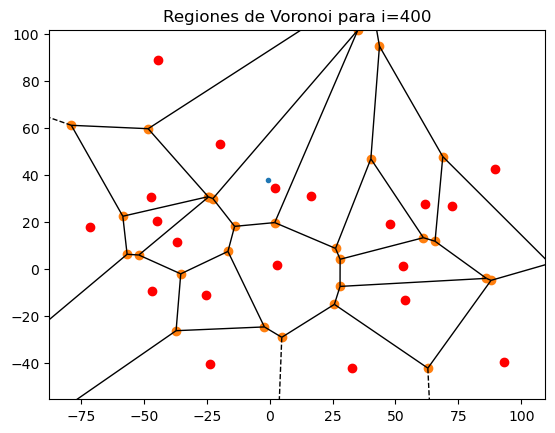

0.0016330068341085513 399


In [7]:
def random_perturbation(point,idx,todoslospoints, scale=10,xlim=100,ylim=100,epsilon=10,delta=80): #La función de perturbación
    
    perturbation = point + np.random.normal(0, scale, point.shape) #El punto perturbado.
    puntossinpoint = todoslospoints.copy()
    puntossinpoint = np.delete(puntossinpoint,idx,axis = 0)
    dist = np.min([np.linalg.norm(perturbation-point2) for point2 in puntossinpoint]) #Para verificar que no está 
    #demasiado cerca de otra estación.
    
    if np.abs(perturbation[0])>xlim or np.abs(perturbation[1])>ylim: #Si es que se escapa del cuadrado inicial
      return point
    elif dist < epsilon: #Si dos estaciones quedan muy cerca.
      return point
    else:
      return perturbation

def plot_voronoi(vor): #Para graficar las regiones de voronoi
    voronoi_plot_2d(vor)
    plt.plot(points[:, 0], points[:, 1], 'ro')  #Pintamos los puntos de origen
    plt.title(f"Regiones de Voronoi para i={i+1}")
    plt.show()
    

points = inicializar_estaciones(N) #Distribución inicial de regiones.
vor = Voronoi(points)
inicial = vor #Se deja una copia de la distribución inicial para luego graficar y comparar.
num_iterations = 400 #Número de iteraciones.

j=0 #Un contador.
objs = [] #Para realizar programación dinámica, contendrá los valores de la función objetivo.
for i in range(num_iterations): #No ocuparemos directamente una matriz que represente la cadena de Markov, sin embargo
    #en cada paso se iría generando la fila i de dicha matriz y el procedimiento sigue funcionando.
    if i == 0: #El caso base
      obj = objetivo(vor,ciud_tot,puntos_de_interes) #Calculamos la función objetivo de la dist. inicial y lo agregamos
      objs.append(obj) #a la lista.

    idx = np.random.randint(len(points)) #seleccionamos un punto aleatorio.
    selected_point = points[idx]
    proposal_point = random_perturbation(selected_point,idx,points) #lo perturbamos
    proposal_points = np.copy(points) #La distribución nueva.
    proposal_points[idx] = proposal_point
    vor_proposal = Voronoi(proposal_points) #Determinamos las regiones de voronoi nuevas.
    obj = objs[-1] #Extraemos el último elemento agregado a la lista con las funciones objetivo.
    obj_proposal = objetivo(vor_proposal,ciud_tot,puntos_de_interes) #Calculamos el valor objetivo de la nueva distribución
    acceptance_prob = min(1, obj_proposal / obj) #el mínimo entre 1 y la fn objetivo de la nueva dist. partido la anterior.
    plot_voronoi(vor_proposal) #Se grafica antes de ver si se acepta la distribución para ver más que nada cuando
    #lo está rechazando.
    print(acceptance_prob,i) #Se printea la aceptación y el índice.

    if np.random.rand() < acceptance_prob: #Metropolis-Hastings.
        
        objs.append(obj_proposal) #Se agrega a la lista si cumple la condición
        print(obj_proposal,j) #Se printea la fn objetivo nueva y el índice.
        points = proposal_points #Se actualiza la distribución a la nueva distribución encontrada.
        vor = vor_proposal #Se actualiza la distribución a la nueva distribución encontrada.
        j+=1



Se grafican la distribución inicial y final para ver el cambio.

inicial es el primer gráfico, final, el segundo
Las funciones objetivos de ambos son:  70.2916126609971 20201.158460592407 respectivamente


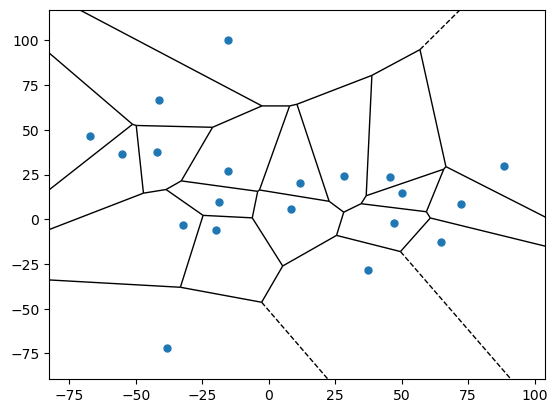

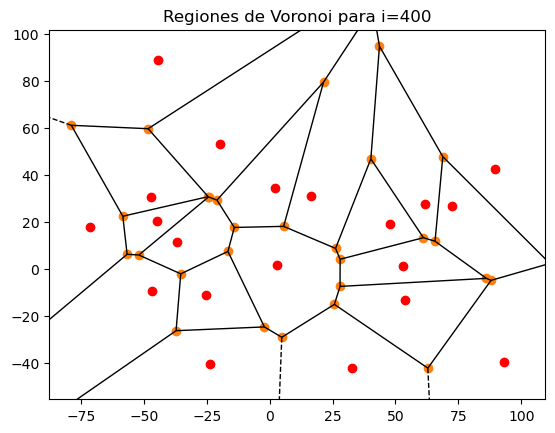

In [8]:
print("inicial es el primer gráfico, final, el segundo")
print("Las funciones objetivos de ambos son: ",objs[0],objs[-1],"respectivamente")
fig = voronoi_plot_2d(inicial,show_vertices=False,point_size=10)
plot_voronoi(vor)


Tras esto se grafican ambos considerando la distribución de casas y puntos de interés de la ciudad.

inicial


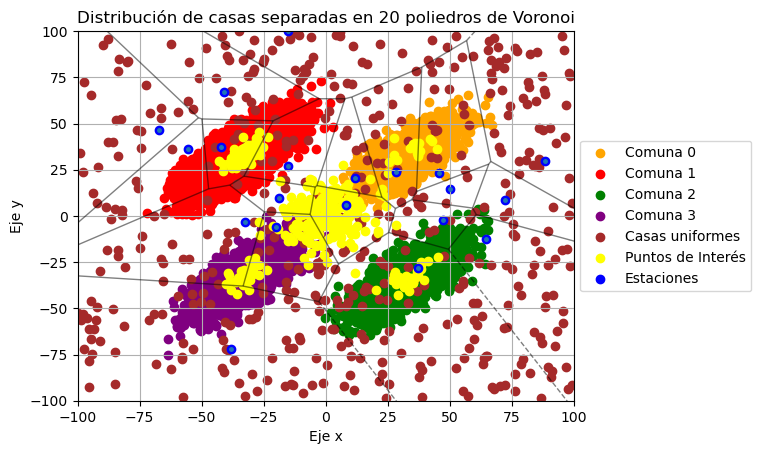

In [9]:
print("inicial")
graficar_todo(inicial,ciud_tot,puntos_de_interes)

final


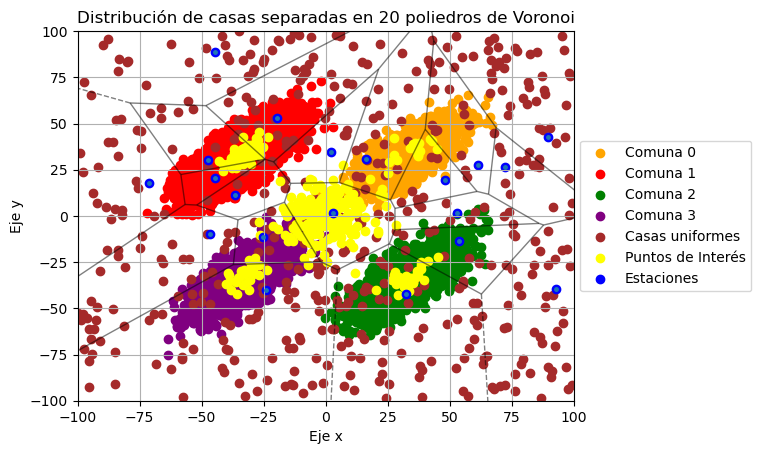

In [10]:
print("final")
graficar_todo(vor,ciud_tot,puntos_de_interes)

Es importante notar que los voronoi tienden a desplazarse al centro, pues hay una mayor prioridad en abarcar los puntos de interés al tener más peso que las casas (esto se evidencia claramente en la región central). 

Finalmente, para obtener la ruta óptima, se utilizan las funciones del laboratorio 3.

In [11]:

def distancia_ciudades(ciudades): #Calcula la distancia entre ciudades.
    D = np.zeros((N,N),dtype=float)
    for i in range(N):
        for j in range(N):
            D[i,j] = np.linalg.norm(ciudades[i]-ciudades[j])
    return D



In [12]:
from matplotlib.patches import FancyArrowPatch

def arrow(x,y,ax,n): #Una herramienta para visualizar mejor la ruta generada.
    d = len(x)//(n+1)
    ind = np.arange(d,len(x),d)
    for i in ind:
        ar = FancyArrowPatch ((x[i-1],y[i-1]),(x[i],y[i]),
                              arrowstyle='->', mutation_scale=20)
        ax.add_patch(ar)


def recorre(ciudades,sigma): #Dada una permutación de las estaciones indica el camino respectivo a dicha permutación
    N = len(ciudades)
    M = len(sigma)
    assert N == M+1
    X,Y = np.matrix.transpose(ciudades)
    W = np.zeros(N+1)
    Z = np.zeros(N+1)
    W[0] = X[0]
    Z[0] = Y[0]
    for i in range(1,N):
        W[i] = X[sigma[i-1]]
        Z[i] = Y[sigma[i-1]]
    W[N] = W[0]
    Z[N] = Z[0]
    fig, ax = plt.subplots(figsize=(10,7))
    #ciudad inicial
    ax.plot(W[0],Z[0],"X",markersize=15,linestyle = '-', label = "estación " + str(1))
    for i in range(1,N):
        ax.plot(W[i],Z[i],"o",linestyle = '-', label = "estación " + str(i+1))
    #completar el ciclo

    ax.grid()
    ax.set_xlim(-100,100)
    ax.set_ylim(-100,100)
    ax.title.set_text("Trayectoria seleccionada para " + str(N) +" estaciones")
    ax.legend(bbox_to_anchor=(1.1,1.001))
    arrow(W,Z,ax, N-1)


[[-36.64696116  11.38888375]
 [ 93.01496708 -39.71676558]
 [  3.04386149   1.54664839]
 [-25.15921867 -11.16795884]
 [-44.76475128  20.4823979 ]
 [ 72.52522834  26.68711514]
 [ 32.576852   -42.43108442]
 [-46.71986333  -9.51588105]
 [  2.27527527  34.48277545]
 [-19.72001855  53.02184795]
 [-71.19506901  17.70293547]
 [ 52.94895732   1.41061778]
 [ 61.53757901  27.62518617]
 [-44.42833906  88.72199585]
 [ 48.00836938  19.21150713]
 [ 16.37686394  30.84308728]
 [-47.19829439  30.38295677]
 [-23.82164641 -40.35415697]
 [ 89.58871331  42.6409661 ]
 [ 53.82111451 -13.38521702]]


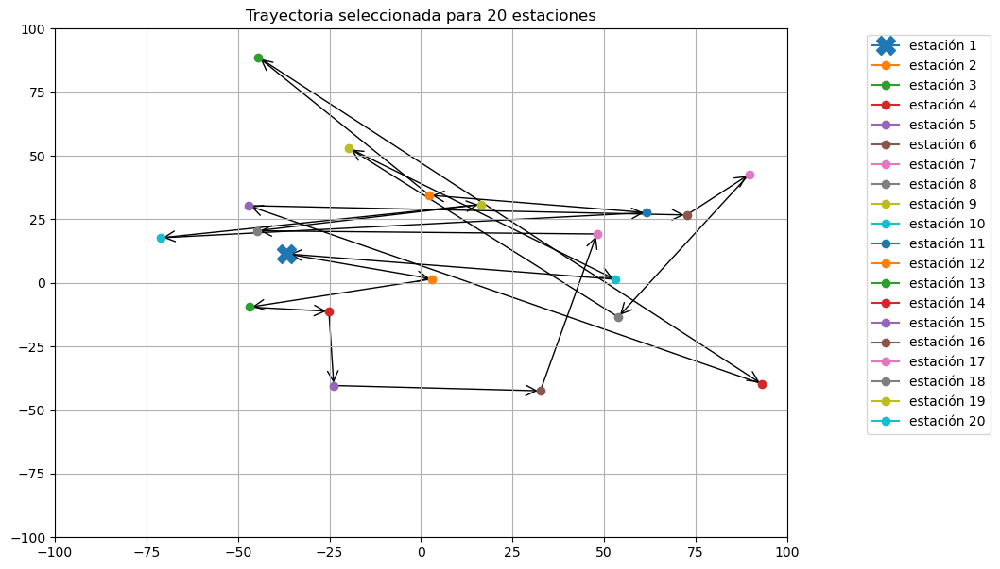

In [13]:
estaciones = vor.points
print(estaciones)
largo = len(estaciones)
sigma = np.random.permutation([i for i in range(1,largo)])
recorre(estaciones,sigma) #Para probar como se ve una ruta dada por alguna permutación.

Esto se utiliza más que nada como ejemplo de como se visualiza un posible camino.

Tras esto, se ocupa Simulated Annealing para obtener la ruta óptima.

In [14]:

N_markov = 600 #pasos de la cadena de markov
C = (N-1)*N*np.sqrt(2)
beta_n_test = [np.log(i+np.e)/C for i in range(N_markov)]

sigma_inicial = np.random.default_rng(seed=semilla).permutation([i for i in range(1,N)])
#osc_K(w) <= N*raiz(2), cota
C = (N-1)*N*np.sqrt(2)
beta_n_test = [np.log(i+np.e)/C for i in range(N_markov)]

def distancia_rec(ciudades,sigma):
    n = len(sigma)
    ciudades_ordenadas_sigma = np.zeros((n,2))
    for j in range(n):
        ciudades_ordenadas_sigma[j] = ciudades[int(sigma[j])]

    distancia =  sum(np.linalg.norm( ciudades_ordenadas_sigma[i] - ciudades_ordenadas_sigma[i+1]) for i in range(0,n-1))
    return distancia


def escoge(n,ciudades,tau,sigma, beta_n):
    osc_tau_sigma = (distancia_rec(ciudades,tau) - distancia_rec(ciudades,sigma))
    Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)
    if Cte_final == 1:
        return tau
    elif Cte_final<1:
        return sigma

def genera_beta_n_enunciado(n):
    return [np.log(i+np.e)/C for i in range(n)]

def generar_tau(sigma):
    n = len(sigma)
    a = np.random.randint(n)
    b = np.random.randint(n)
    tau = sigma.copy()
    (tau[a],tau[b]) = (tau[b],tau[a])
    return tau

def simular_cadena(N_limite, ciudades, estado_inic,beta_n):
    n = len(estado_inic)
    Cadenota = np.zeros((N_limite,n),dtype=int)
    Cadenota[0] = estado_inic
    for i in range(1,N_limite):
        beta_actual = beta_n[i]
        tau = generar_tau(Cadenota[i-1])
        Cadenota[i] = escoge(i, ciudades, tau, Cadenota[i-1],beta_actual)
    return Cadenota



matriz = simular_cadena(N_markov,estaciones,sigma_inicial,beta_n_test)


Graficamos la ruta óptima obtenida para las estaciones:

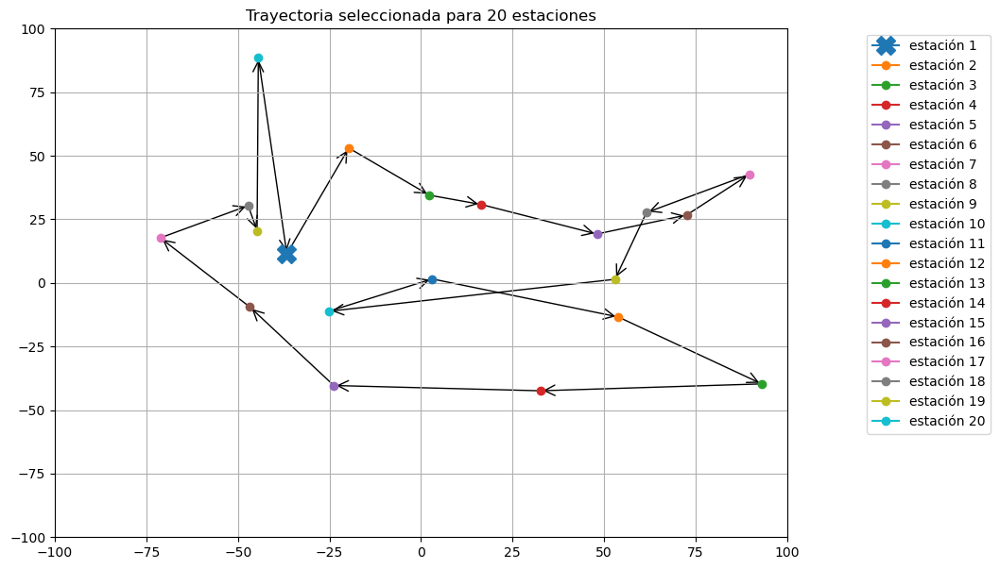

In [15]:
sigma_f = matriz[-1]
recorre(estaciones,sigma_f)

Y ahora verificamos como evoluciona la cadena con un beta lineal, cuadrático y exponencial.

C:\Users\marti\AppData\Local\Temp\ipykernel_23936\1238279707.py:22: RuntimeWarning: overflow encountered in exp
  Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)


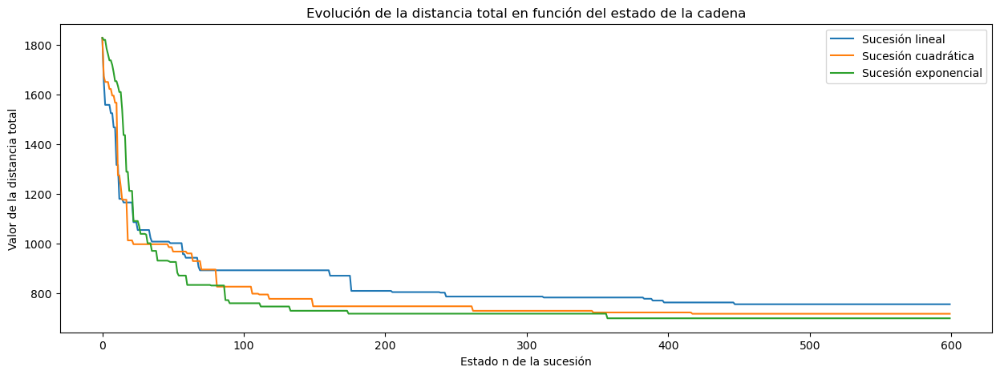

In [16]:
indices = range(N_markov)
#beta_n distintos, desde 1 hasta N (0:N-1)
betas_lineal = [i for i in indices]
betas_quadra = [i**2 for i in indices]
betas_expnen = [np.exp(i) for i in indices]


#genero las cadenas y me kedo con la última para cada beta
Cadena_lineal = simular_cadena(N_markov,estaciones,sigma_inicial,betas_lineal)
#guardo la distancia
w_lineal = [distancia_rec(estaciones,perm) for perm in Cadena_lineal]
plt.figure(figsize=(15, 5))
plt.plot(indices,w_lineal, label="Sucesión lineal")



Cadena_quadra = simular_cadena(N_markov,estaciones,sigma_inicial,betas_quadra)
w_quadra = [distancia_rec(estaciones,perm) for perm in Cadena_quadra]
plt.plot(indices,w_quadra,label="Sucesión cuadrática")


Cadena_expnen = simular_cadena(N_markov,estaciones,sigma_inicial,betas_expnen)
w_expnen = [distancia_rec(estaciones,perm) for perm in Cadena_expnen]
plt.plot(indices,w_expnen,label="Sucesión exponencial")


plt.title("Evolución de la distancia total en función del estado de la cadena")
plt.ylabel("Valor de la distancia total")
plt.xlabel("Estado n de la sucesión")
plt.legend()
plt.show()

Escogemos el beta exponencial, pues en esta ocasión fue el que convergió más rápido.

C:\Users\marti\AppData\Local\Temp\ipykernel_23936\1238279707.py:22: RuntimeWarning: overflow encountered in exp
  Cte_final = min(np.exp(-1*beta_n*osc_tau_sigma),1)


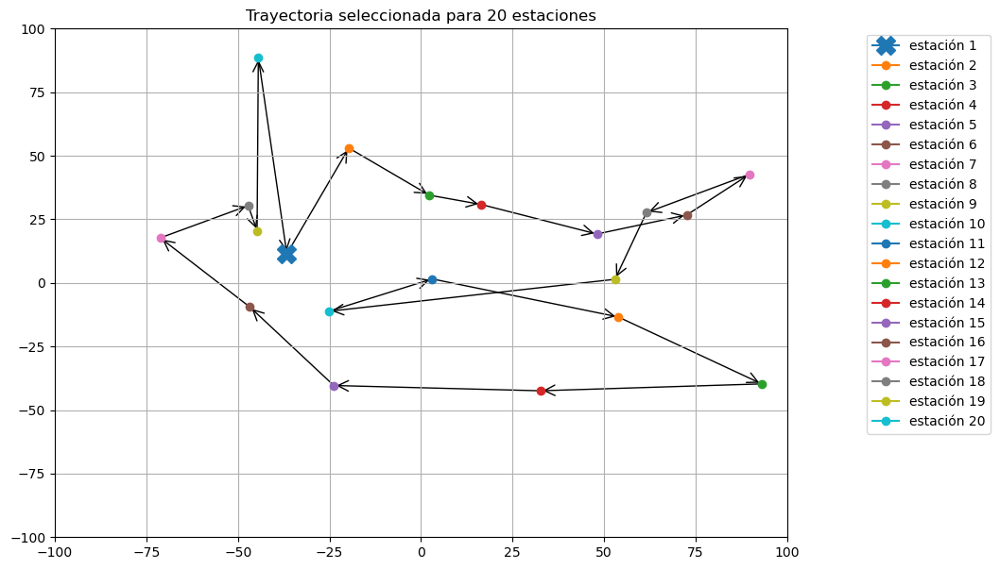

In [18]:
Cadena_lineal = simular_cadena(N_markov,estaciones,sigma_inicial,betas_expnen)
sigma_f = matriz[-1]
recorre(estaciones,sigma_f)

Obteniéndose así la ruta óptima de las estaciones encontradas, mediante un beta cuadrático.

Finalmente, se pudo generar una ruta de metro socialmente eficiente, cubriendo las casas y puntos de interés y conectándolas de forma de obtener la ruta cerrada mas corta. Además, el modelo genera algunos problemas, como la distancia entre las estaciones, acumulación de estaciones y viajes que demorarían mas tiempo. Y, por último, la tendencia de las estaciones brinda certeza de la eficiencia del modelo bajos marcos teóricos y redes reales con rutas concéntricas 